## Backend

In [1]:
import numpy

In [3]:
#import necessary libraries
import xarray as xr
from netCDF4 import Dataset, MFDataset, num2date
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from pyproj import Proj
import geopandas as gpd

In [4]:
#counties shapefile
import cartopy.io.shapereader as shpreader
import cartopy.feature as cfeature
reader = shpreader.Reader('../SMOKE_sensitivity_analyses/counties/countyl010g.shp')
counties = list(reader.geometries())
COUNTIES = cfeature.ShapelyFeature(counties, ccrs.PlateCarree())

In [5]:
baseline = xr.open_dataset("avg_201601.nc")
rwc_2020 = xr.open_dataset("avg_201601_2020_RWC.nc")
no_rwc = xr.open_dataset("no_rwc_avg_201601.nc")

percent_RWC = 100*(baseline['PM25_TOT'][0,0,:,:] - no_rwc['PM25_TOT'][0,0,:,:])/baseline['PM25_TOT'][0,0,:,:]
percent_RWC_2020 = 100*(rwc_2020['PM25_TOT'][0,0,:,:] - no_rwc['PM25_TOT'][0,0,:,:])/rwc_2020['PM25_TOT'][0,0,:,:]
diff_2020 = rwc_2020['PM25_TOT'][0,0,:,:] - baseline['PM25_TOT'][0,0,:,:]

In [6]:
# validation info

file_path = 'AQS_data_2016/validation_baseline_hourly.csv'
validation_baseline = pd.read_csv(file_path)

file_path = 'AQS_data_2016/validation_RWC2020_hourly.csv'
validation_2020_RWC = pd.read_csv(file_path)

In [7]:
import geopandas as gpd
from shapely.geometry import Polygon
import numpy as np

# Projection parameters
proj_params = {'proj': 'lcc',
               'lat_1': 33,
               'lat_2': 45,
               'lon_0': -97,
               'lat_0': 40}

# Coordinates of the origin
xorig = -2292000
yorig = -1584000

# Number of grid cells in x and y directions
num_cells_x = 1155
num_cells_y = 726

# Size of each grid cell (in meters)
cell_size = 4000  # 4km

# Generate grid coordinates using NumPy
x_coords = np.linspace(xorig, xorig + cell_size * num_cells_x, num_cells_x + 1)
y_coords = np.linspace(yorig, yorig + cell_size * num_cells_y, num_cells_y + 1)

# Create vertices for all grid cells using NumPy
x1, y1 = np.meshgrid(x_coords[:-1], y_coords[:-1])
x2, y2 = np.meshgrid(x_coords[1:], y_coords[:-1])
x3, y3 = np.meshgrid(x_coords[1:], y_coords[1:])
x4, y4 = np.meshgrid(x_coords[:-1], y_coords[1:])

# Reshape to 1D arrays
x1, x2, x3, x4 = x1.ravel(), x2.ravel(), x3.ravel(), x4.ravel()
y1, y2, y3, y4 = y1.ravel(), y2.ravel(), y3.ravel(), y4.ravel()

# Calculate row and column indices for each cell
rows, cols = np.divmod(np.arange(len(x1)), num_cells_x)

# Create GeoDataFrame with polygons
polygons = [Polygon([(x1[i], y1[i]), (x2[i], y2[i]), (x3[i], y3[i]), (x4[i], y4[i])]) for i in range(len(x1))]
pmgdf = gpd.GeoDataFrame({'row': rows, 'col': cols, 'geometry': polygons}, crs=proj_params)

# Display the resulting GeoDataFrame
print(pmgdf.head())


   row  col                                           geometry
0    0    0  POLYGON ((-2292000 -1584000, -2288000 -1584000...
1    0    1  POLYGON ((-2288000 -1584000, -2284000 -1584000...
2    0    2  POLYGON ((-2284000 -1584000, -2280000 -1584000...
3    0    3  POLYGON ((-2280000 -1584000, -2276000 -1584000...
4    0    4  POLYGON ((-2276000 -1584000, -2272000 -1584000...


In [9]:
pmgdf['PM25'] = (baseline['PM25_TOT'][0,0,:,:]).to_numpy().flatten()
pmgdf['PM25_2020'] = (rwc_2020['PM25_TOT'][0,0,:,:]).to_numpy().flatten()
pmgdf['PM25_diff'] = (rwc_2020['PM25_TOT'][0,0,:,:] - baseline['PM25_TOT'][0,0,:,:]).to_numpy().flatten()

pmgdf['PM25_RWC'] = (baseline['PM25_TOT'][0,0,:,:] - no_rwc['PM25_TOT'][0,0,:,:]).to_numpy().flatten()
pmgdf['PM25_RWC_2020'] = (rwc_2020['PM25_TOT'][0,0,:,:] - no_rwc['PM25_TOT'][0,0,:,:]).to_numpy().flatten()
pmgdf['PM25_RWC_percent'] =(100* (baseline['PM25_TOT'][0,0,:,:] - no_rwc['PM25_TOT'][0,0,:,:])/baseline['PM25_TOT'][0,0,:,:]).to_numpy().flatten()
pmgdf['PM25_RWC_percent_2020'] = (percent_RWC_2020).to_numpy().flatten()

pmgdf['RWC_percent_diff'] = (pmgdf['PM25_RWC_2020'] - pmgdf['PM25_RWC'])/ pmgdf['PM25'] * 100 

pmgdf['centroid'] = pmgdf.geometry.centroid

# MSA data
cbsa = gpd.read_file('cbsa/tl_2019_us_cbsa.shp', engine="pyogrio")

# Convert the GeoDataFrame to the target CRS
cbsa = cbsa.to_crs("+proj=lcc +lat_1=33 +lat_2=45 +lon_0=-97 +lat_0=40")

# Create a new GeoDataFrame with centroids
pmgdf_centroids = gpd.GeoDataFrame(geometry=pmgdf['centroid'], crs=pmgdf.crs)

# Perform spatial join based on centroids within cbsa geometry
merged_gdf = gpd.sjoin(pmgdf_centroids, cbsa, predicate='within')

# add to pm geodataframe
pmgdf['CBSA'] = merged_gdf['NAME']
pmgdf['CBSAFP'] =  merged_gdf['CBSAFP']

In [10]:
# Read the .txt file into a pandas DataFrame
population_df = pd.read_csv("../SMOKE_sensitivity_analyses/population.txt", delimiter='\t', header=None, skiprows=25)

# # Specify coordinates to align population and emission data
population_df = population_df.rename(columns = {2:"COLS", 3:"ROWS"})
population_df["COLS"] -= 111 
population_df["ROWS"] -= 126   

PWC_df = gpd.GeoDataFrame.merge(pmgdf, population_df, left_on=['row', 'col'], right_on=['ROWS', 'COLS'])

PWC_df['population'] = PWC_df[6]

PWC_df['PWC_TOT'] = PWC_df['PM25'] * PWC_df['population']
PWC_df['PWC_RWC'] = PWC_df['PM25_RWC'] * PWC_df['population']
PWC_df['PWC_TOT_2020'] = PWC_df['PM25_2020'] * PWC_df['population']
PWC_df['PWC_RWC_2020'] = PWC_df['PM25_RWC_2020'] * PWC_df['population']


total_PWC = PWC_df['PWC_TOT'].sum()
RWC_PWC = PWC_df['PWC_RWC'].sum()

total_PWC_2020 = PWC_df['PWC_TOT_2020'].sum()
RWC_PWC_2020 = PWC_df['PWC_RWC_2020'].sum()

In [9]:
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable

# Assuming `pmgdf` is your GeoDataFrame
# Add a dummy value column if it doesn't already exist
# Define the target projection
from cartopy import crs as ccrs
import cartopy.feature as cfeature

target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))

# Create the plot
fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': target_proj})

# Define visualization limits
vmin = PWC_df['population'].quantile(0.025)
vmax = PWC_df['population'].quantile(0.975)


resol = '50m'
ocean = cfeature.NaturalEarthFeature('physical', 'ocean', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
lakes = cfeature.NaturalEarthFeature('physical', 'lakes', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
states_provinces = cfeature.NaturalEarthFeature(category='cultural', name='admin_1_states_provinces_lines', scale='50m', edgecolor='white', facecolor='none')

ax.add_feature(ocean, linewidth=0, facecolor="white")
ax.add_feature(lakes, linewidth=0, facecolor="white")
ax.add_feature(states_provinces, edgecolor='white', linewidth=0.5)

# Plot the GeoDataFrame
sc = PWC_df.plot(
    ax=ax,
    column='population',  # Replace 'value' with your desired column
    cmap='viridis',
    vmin=vmin,
    vmax=vmax,
    legend=False
)

# Add a color bar
norm = Normalize(vmin=vmin, vmax=vmax)
sm = ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])
fig.colorbar(sm, ax=ax, orientation='horizontal', label='PM25')

# Customize the title and axis
ax.set_title("Spatial Heatmap of Variable", fontsize=16)
ax.axis("off")

# Show the plot
plt.show()



KeyboardInterrupt



Error in callback <function _draw_all_if_interactive at 0x2ae922d41fc0> (for post_execute), with arguments args (),kwargs {}:



KeyboardInterrupt



Error in callback <function flush_figures at 0x2ae92ceeb490> (for post_execute), with arguments args (),kwargs {}:



KeyboardInterrupt



In [141]:
import pandas as pd

# most populous 20
cbsa_list = [
    "New York-Newark-Jersey City, NY-NJ-PA",
    "Los Angeles-Long Beach-Anaheim, CA",
    "Chicago-Naperville-Elgin, IL-IN-WI",
    "Dallas-Fort Worth-Arlington, TX",
    "Houston-The Woodlands-Sugar Land, TX",
    "Washington-Arlington-Alexandria, DC-VA-MD-WV",
    "Miami-Fort Lauderdale-Pompano Beach, FL",
    "Philadelphia-Camden-Wilmington, PA-NJ-DE-MD",
    "Atlanta-Sandy Springs-Alpharetta, GA",
    "Boston-Cambridge-Newton, MA-NH",
    "Phoenix-Mesa-Chandler, AZ",
    "San Francisco-Oakland-Berkeley, CA",
    "Riverside-San Bernardino-Ontario, CA",
    "Detroit-Warren-Dearborn, MI",
    "Seattle-Tacoma-Bellevue, WA",
    "Minneapolis-St. Paul-Bloomington, MN-WI",
    "San Diego-Chula Vista-Carlsbad, CA",
    "Tampa-St. Petersburg-Clearwater, FL",
    "Denver-Aurora-Lakewood, CO",
    "St. Louis, MO-IL",
    "CONUS"
]


# Initialize an empty list to hold the data
data = []

# Iterate through each CBSA in the list
for cbsa in cbsa_list:
    cbsa_df = PWC_df[PWC_df['CBSA'] == cbsa]

    if cbsa == "CONUS": cbsa_df = PWC_df
    
    # Calculate basic statistics for PM25_RWC_2020
    pm25_rwc_2020_mean = cbsa_df['PM25_RWC_2020'].mean()
    pm25_rwc_2020_max = cbsa_df['PM25_RWC_2020'].max()
    pm25_rwc_2020_iqr = cbsa_df['PM25_RWC_2020'].quantile(0.75) - cbsa_df['PM25_RWC_2020'].quantile(0.25)
    
    # Calculate other required statistics
    pm_2014 = cbsa_df['PM25'].mean()
    pm_2020 = cbsa_df['PM25_2020'].mean()
    pm_2014_RWC = cbsa_df['PM25_RWC'].mean()
    pm_2020_RWC = cbsa_df['PM25_RWC_2020'].mean()
    percent_2014_RWC = pm_2014_RWC / pm_2014 * 100 if pm_2014 != 0 else None
    percent_2020_RWC = pm_2020_RWC / pm_2020 * 100 if pm_2020 != 0 else None
    
    # Append the results as a dictionary
    data.append({
        "CBSA": cbsa,
        # "PM25_2014": pm_2014,
        # "PM25_2020": pm_2020,
        # "PM25_2014_RWC": pm_2014_RWC,
        "PM25_2020_RWC": pm_2020_RWC,
        # "Percent_2014_RWC": percent_2014_RWC,
        "Percent_2020_RWC": percent_2020_RWC,
        # "PW_PM25_2014": cbsa_df['PWC_TOT'].sum() / cbsa_df['population'].sum(),
        #"PW_PM25_2020": cbsa_df['PWC_TOT_2020'].sum()/ cbsa_df['population'].sum(),
        # "PW_PM25_2014_RWC": cbsa_df['PWC_RWC'].sum() / cbsa_df['population'].sum(),
        "PW_PM25_2020_RWC": cbsa_df['PWC_RWC_2020'].sum() / cbsa_df['population'].sum(),
        # "PW_Percent_2014_RWC": (cbsa_df['PWC_RWC'].sum() / cbsa_df['population'].sum()) / (cbsa_df['PWC_TOT'].sum() / cbsa_df['population'].sum()) * 100,
        "PW_Percent_2020_RWC": (cbsa_df['PWC_RWC_2020'].sum() / cbsa_df['population'].sum()) / (cbsa_df['PWC_TOT_2020'].sum() / cbsa_df['population'].sum()) * 100,
        #"PM25_RWC_2020_Mean": pm25_rwc_2020_mean,
        "PM25_RWC_2020_Max": pm25_rwc_2020_max,
        "PM25_RWC_2020_IQR": pm25_rwc_2020_iqr
    })

# Create a DataFrame from the data
result_df = pd.DataFrame(data)

# Display the resulting DataFrame
#result_df.to_csv('MSA_20_RWC_results.csv')

result_df

,CBSA,PM25_2020_RWC,Percent_2020_RWC,PW_PM25_2020_RWC,PW_Percent_2020_RWC,PM25_RWC_2020_Max,PM25_RWC_2020_IQR
0,"New York-Newark-Jersey City, NY-NJ-PA",2.939909,28.232762,3.152717,21.055347,5.120658,0.773664
1,"Los Angeles-Long Beach-Anaheim, CA",1.438801,16.637972,2.667377,16.346564,4.700985,1.783274
2,"Chicago-Naperville-Elgin, IL-IN-WI",1.864163,17.588972,2.122660,15.708735,4.291373,0.536287
3,"Dallas-Fort Worth-Arlington, TX",0.994709,9.925460,1.103918,9.423602,1.240491,0.102053
4,"Houston-The Woodlands-Sugar Land, TX",1.084877,9.587703,1.304493,8.812612,1.700195,0.276056
5,"Washington-Arlington-Alexandria, DC-VA-MD-WV",3.429831,30.512762,4.115815,29.387463,5.745647,0.966806
6,"Miami-Fort Lauderdale-Pompano Beach, FL",0.352634,6.285413,0.392768,5.000426,0.636022,0.126483
7,"Philadelphia-Camden-Wilmington, PA-NJ-DE-MD",3.900817,30.427888,4.520591,29.236596,7.232491,1.420858
8,"Atlanta-Sandy Springs-Alpharetta, GA",1.646816,13.755129,1.795036,14.247413,2.269505,0.353173
9,"Boston-Cambridge-Newton, MA-NH",3.688682,41.118813,3.878000,35.410237,7.402677,1.313972


# Quick Numerical Analyses

In [7]:
def quick_numerical(var):
    # total and mean for baseline
    total_baseline = baseline[var].to_numpy().sum()
    mean_baseline = baseline[var].to_numpy().mean()

    total_rwc_2020 = rwc_2020[var].to_numpy().sum()
    mean_rwc_2020 = rwc_2020[var].to_numpy().mean()

    # total and mean for no_rwc
    total_no_rwc = no_rwc[var].to_numpy().sum()
    mean_no_rwc = no_rwc[var].to_numpy().mean()

    print(f"Average {var} concentration for baseline: {str(round(mean_baseline - mean_no_rwc,4))} micrograms per cubic meter")
    print(f"Average {var} concentration for 2020 RWC: {str(round(mean_rwc_2020 - mean_no_rwc,4))} micrograms per cubic meter")
    # print(f"Summed {var} concentration for baseline: {str(round(total_baseline,4))} micrograms per cubic meter")
    # print(f"Summed {var} concentration for no RWC  : {str(round(total_no_rwc,4))} micrograms per cubic meter")
    # print("\n")
    percent_diff = 100 * (total_baseline - total_no_rwc)/total_baseline
    print(f"Percent of RWC contribution for base {var}: {str( round(percent_diff,3) )} %")
    percent_diff_2020 = 100 * (total_rwc_2020 - total_no_rwc)/total_baseline
    print(f"Percent of RWC contribution for 2020 {var}: {str( round(percent_diff_2020,3) )} %")

In [8]:
quick_numerical("PM25_TOT")

Average PM25_TOT concentration for baseline: 0.7795 micrograms per cubic meter
Average PM25_TOT concentration for 2020 RWC: 0.7594 micrograms per cubic meter
Percent of RWC contribution for base PM25_TOT: 17.854 %
Percent of RWC contribution for 2020 PM25_TOT: 17.393 %


In [ ]:
quick_numerical("PM25_EC")

In [ ]:
quick_numerical("PM25_OC")

In [ ]:
quick_numerical("NOX") # doesn't change much

In [ ]:
quick_numerical("O3") ## doesn't change much

In [ ]:
quick_numerical("CO") # changes a little

In [ ]:
#create dataframe of RWC relative contributions to baseline
variables = list(baseline.variables)
relative_change = pd.DataFrame(columns = ["var", "percent RWC contribution"])
percent_diffs = []

for var in variables:
    percent_diff = 100 * (baseline[var].to_numpy().sum() - no_rwc[var].to_numpy().sum())/baseline[var].to_numpy().sum()
    percent_diffs.append(percent_diff)
    
relative_change['var'] = variables
relative_change['percent RWC contribution'] = percent_diffs

In [ ]:
pd.set_option('display.max_rows', None)
relative_change = relative_change.sort_values("percent RWC contribution")
relative_change.head(124)


In [ ]:
pd.set_option('display.max_rows', 20)

In [ ]:
baseline

# Plotting

In [9]:
# Define the Lambert Conformal Conic projection parameters
def map_lat_lon(proj_params, xorig, yorig, ncols, nrows):
    # Define the projection transformation
    lcc_proj = Proj(proj_params)

    # Define the grid indices
    xcell, ycell = 4000, 4000  # Size of grid cells
    
    # Generate grid points
    x = np.arange(xorig, xorig + xcell * ncols, xcell)
    y = np.arange(yorig, yorig + ycell * nrows, ycell)
    
    # Create a meshgrid from the grid points
    x_mesh, y_mesh = np.meshgrid(x, y)
    
    # Convert grid indices to latitude and longitude using the projection
    lon_4km, lat_4km = lcc_proj(x_mesh, y_mesh, inverse=True)

    # Print latitude and longitude for a sample point
    print("Latitude at index (0, 0):", lat_4km[1, 1])
    print("Longitude at index (0, 0):", lon_4km[0, 1])
    
    return lon_4km, lat_4km

lon, lat = map_lat_lon(
    proj_params = {'proj': 'lcc',
                   'lat_1': 33,
                   'lat_2': 45,
                   'lon_0': -97,
                   'lat_0': 40},
    xorig = -2292000, yorig= -1584000,  # Coordinates of the origin
    ncols = 1155, nrows = 726  # Number of columns and rows
    )

Latitude at index (0, 0): 23.348182028774666
Longitude at index (0, 0): -118.91550946462284


In [10]:
#Challenge #2 change projection type and 
def plot(data, label, title, lat, lon,  cbar = "viridis", vs = False, counties = False, bounds = False, difference = False, state_color = "white" ):
    if not bounds:
        bounds = [[0, lat.shape[0]], [0, lon.shape[1]]]
    
    #create matplotlib figure
    plt.figure(figsize=(15,8))

    #create subplot with the an Mollweide projection
    ax = plt.subplot(111, projection=ccrs.PlateCarree(central_longitude=-97.0, globe=None))

    #create map with 
    if difference:
            mm = ax.pcolormesh(lon[ bounds[0][0]:bounds[0][1], bounds[1][0]:bounds[1][1] ],
                       lat[ bounds[0][0]:bounds[0][1], bounds[1][0]:bounds[1][1] ],
                       data[ bounds[0][0]:bounds[0][1], bounds[1][0]:bounds[1][1] ],
                       transform=ccrs.PlateCarree(),
                       cmap = "RdBu" #use inferno colormap
                      )
    else:
            mm = ax.pcolormesh(lon[ bounds[0][0]:bounds[0][1], bounds[1][0]:bounds[1][1] ],
                       lat[ bounds[0][0]:bounds[0][1], bounds[1][0]:bounds[1][1] ],
                       data[ bounds[0][0]:bounds[0][1], bounds[1][0]:bounds[1][1] ],
                       transform=ccrs.PlateCarree(),
                       cmap = cbar #use inferno colormap
                      )
    
    #map coastlines on the map with resolution 100m
    ax.coastlines(resolution='110m')

    #generate features
    resol = '10m'  # use data at this scale
    bodr = cfeature.NaturalEarthFeature(category='cultural',  edgecolor = state_color,name='admin_0_boundary_lines_land', scale=resol, facecolor='none', alpha=0.7)
    ocean = cfeature.NaturalEarthFeature('physical', 'ocean', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    lakes = cfeature.NaturalEarthFeature('physical', 'lakes', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    #rivers = cfeature.NaturalEarthFeature('physical', 'rivers_lake_centerlines', scale=resol, edgecolor='black', facecolor='none')
    states_provinces = cfeature.NaturalEarthFeature(category='cultural', name='admin_1_states_provinces_lines', scale='50m',edgecolor = state_color, facecolor='none')
    
    #add features
    if counties:
        ax.add_feature(COUNTIES, facecolor='none', edgecolor=state_color)
   # ax.add_feature(rivers, linewidth=0.5,edgecolor='blue')
    ax.add_feature(ocean, linewidth=0.2 )
    ax.add_feature(lakes, linewidth = 0)
    ax.add_feature(states_provinces, edgecolor=state_color, linewidth=0.5)
    ax.add_feature(bodr, linestyle='--', edgecolor=state_color, alpha=1)
    
    #ax.stock_img(); #land images
    if vs:
        mm.set_clim(vmin=vs[0], vmax=vs[1])
    else:
        mm.set_clim(vmin = np.quantile(data, 0.025), vmax = np.quantile(data, 0.975))

    #plot colorbar legend
    cbar = plt.colorbar(mm)
    cbar.ax.set_ylabel(label,rotation = 90)

    ax.set_title(title)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

## Plotting Overall PM2.5 Figure

In [11]:
# Load the boundary shapefile
boundaries = gpd.read_file("cbsa/cb_2018_us_nation_20m.shp")

# Ensure CRS match
boundaries = boundaries.to_crs(pmgdf.crs)

# Optionally simplify USA geometry for faster processing
boundaries["geometry"] = boundaries.simplify(tolerance=0.01, preserve_topology=True)

# Create a bounding box for the USA geometry to prefilter gdf
from shapely.geometry import box
usa_bounds = box(*boundaries.total_bounds)
pmgdf = pmgdf[pmgdf.intersects(usa_bounds)]  # Prefilter to reduce unnecessary computations

In [131]:
import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np

def plot_MSA(df, cbsa, MSA, title, col="PM25", cmap="viridis", vs=False, counties=False, difference=False, state_color="white", ax=None, title_size=16):
    from shapely.geometry import box
    
    # Define the target projection
    target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))
    
    # Generate map features
    resol = '50m'
    ocean = cfeature.NaturalEarthFeature('physical', 'ocean', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    lakes = cfeature.NaturalEarthFeature('physical', 'lakes', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    
    # Customize plot appearance
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.set_xticks([])
    ax.set_yticks([])
    
    # Add features to the map
    ax.add_feature(ocean, linewidth=0, zorder=0, facecolor="white")
    ax.add_feature(lakes, linewidth=0, zorder=0, facecolor="white")
    
    # Get the geometry for the specified MSA
    if MSA != "":
        msa_geometry = cbsa.loc[cbsa["NAME"] == MSA, "geometry"].iloc[0]
        clipped_df = df.clip(mask=msa_geometry)
    else:
        msa_geometry = boundaries.geometry
        clipped_df = df  
    
    # Set visualization limits
    if vs:
        vmin = vs[0]
        vmax = vs[1]
    elif not difference:
        vmin = np.quantile(clipped_df[col], 0.025)
        vmax = np.quantile(clipped_df[col], 0.975)
    else:
        vmin = -max(abs(np.quantile(clipped_df[col], 0.025)), abs(np.quantile(clipped_df[col], 0.975)))
        vmin = max(vmin, -20)
        vmax = -vmin
    
    # Plot clipped data
    sc = clipped_df.plot(ax=ax, column=col, cmap=cmap, legend=False, vmin=vmin, vmax=vmax, zorder=-1, edgecolor="none", antialiased=False)

    # Create the ScalarMappable for the color bar
    norm = Normalize(vmin=vmin, vmax=vmax)
    sm = ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])  # Required for colorbar
    
    # Add the title with adjusted position
    #ax.set_title(title, fontsize=title_size, loc='center', pad=10)

    # Adjust layout to ensure that titles fit
    print('done')
    ax.axis("off")
    return sc, sm


done
done
done
done
done
done
done
done
done
done


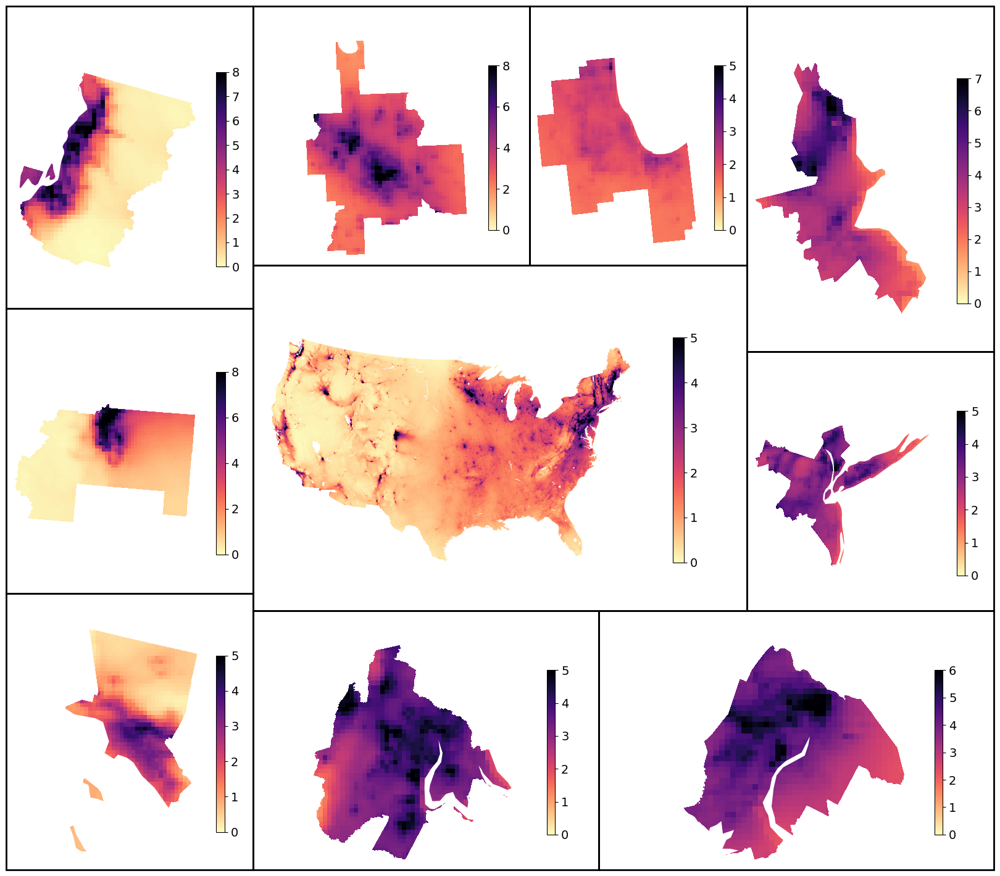

In [135]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Rectangle

# Initialize the figure
target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))

fig = plt.figure(figsize=(16, 14))  # Larger figure to accommodate everything

# Custom positions (x1, x2, y1, y2) for each subplot, adjusted for add_axes format
positions = {
    "Seattle-Tacoma-Bellevue, WA": (0, 0.25, 0, 0.35),  # Top left
    "Minneapolis-St. Paul-Bloomington, MN-WI": (0.25, 0.53, 0, 0.3),  # Top-center-left
    "Chicago-Naperville-Elgin, IL-IN-WI": (0.53, 0.75, 0, 0.3),  # Top-center-right
    "Boston-Cambridge-Newton, MA-NH": (0.75, 1, 0, 0.4),  # Top-right
    "New York-Newark-Jersey City, NY-NJ-PA": (0.75, 1, 0.4, 0.7),  # Right-middle
    "Philadelphia-Camden-Wilmington, PA-NJ-DE-MD": (0.6, 1, 0.7, 1),  # Bottom-left
    "Washington-Arlington-Alexandria, DC-VA-MD-WV": (0.25, 0.6, 0.7, 1),  # Bottom-right
    "Los Angeles-Long Beach-Anaheim, CA": (0, 0.25, 0.68, 1),  # Right-middle
    "Denver-Aurora-Lakewood, CO": (0, 0.25, 0.35, 0.68),  # Bottom-left-center
    "": (0.25, 0.75, 0.3, 0.7),  # Bottom-center
}

# Convert positions to the format (left, bottom, width, height)
converted_positions = {
    key: (x1, 1 - y2, x2 - x1, y2 - y1)  # Calculate width and height from x1, x2, y1, y2
    for key, (x1, x2, y1, y2) in positions.items()
}

# Loop through each MSA and plot
for MSA, pos in list(converted_positions.items())[:]:
    df = pmgdf  # Assuming pmgdf is the data frame

    ax = fig.add_axes(pos, projection=target_proj)
    ax.set_position([pos[0], pos[1], pos[2], pos[3] - 0.028])  # Adjust top margin (0.05) as needed

    # Dynamically determine the upper bound for the color scale
    upper_bound = 5
    if MSA != "":
        if df.loc[df['CBSA'] == MSA]['PM25_RWC_2020'].quantile(0.98) >= 5:
            bound_2020 = np.ceil(df.loc[df['CBSA'] == MSA]['PM25_RWC_2020'].quantile(0.98))
            upper_bound = bound_2020
        place = MSA.split('-')[0]
    else:
        df = PWC_df
        if df['PM25_RWC_2020'].quantile(0.98) >= 5:
            bound_2020 = np.ceil(df['PM25_RWC_2020'].quantile(0.995))
            upper_bound = bound_2020
        place = "CONUS"


    sc, sm = plot_MSA(
        df=df,
        col="PM25_RWC_2020",
        cbsa=cbsa,
        MSA=MSA,
        title=f'{place}',
        cmap="magma_r",
        vs=[0, upper_bound],
        counties=False,
        difference=False,
        ax=ax,
        title_size=15
    )
    
    # Adjust colorbar
    cbar = fig.colorbar(sm, ax=ax, orientation="vertical", shrink=0.7)
    cbar.ax.tick_params(labelsize=14)
    
    # Draw a bounding box around the entire axis (including the colorbar)
    bbox = Rectangle(
        (pos[0], pos[1]),  # Starting from the bottom-left corner of the axis
        pos[2],  # Width
        pos[3],  # Height
        transform=fig.transFigure,  # Use figure-relative coordinates for the bounding box
        color="black",  # Box color
        linewidth=2,  # Line width of the box
        fill=False  # No fill for the bounding box
    )
    fig.add_artist(bbox)  # Add the bounding box to the figure

    # Adjust title position to ensure it fits within the axis
    #ax.set_title(MSA, fontsize=12, pad=10)  # Adjust the pad value as necessary
    
    #ax.set_aspect('auto')
    #ax.set_clip_on(True)

# Manually adjust subplot layout to ensure everything fits well
plt.show()


done
done
done
done
done
done
done
done
done
done


<Figure size 1600x1400 with 0 Axes>

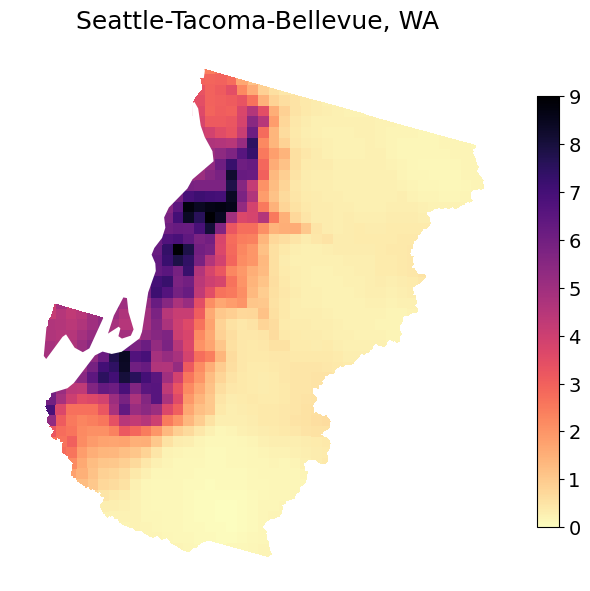

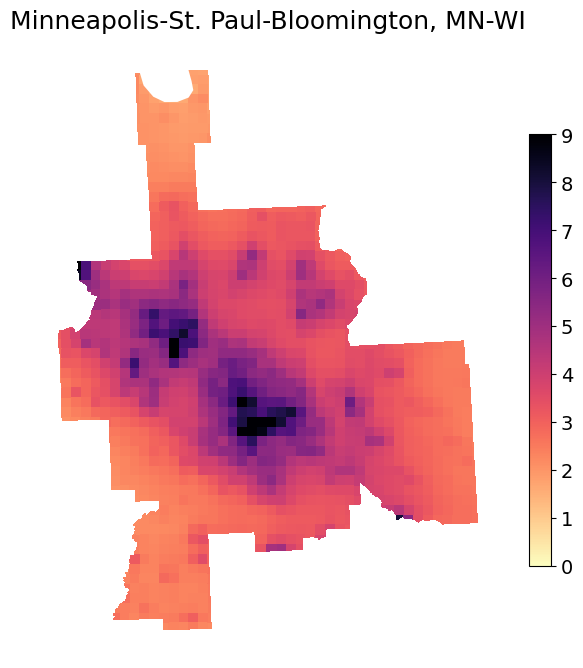

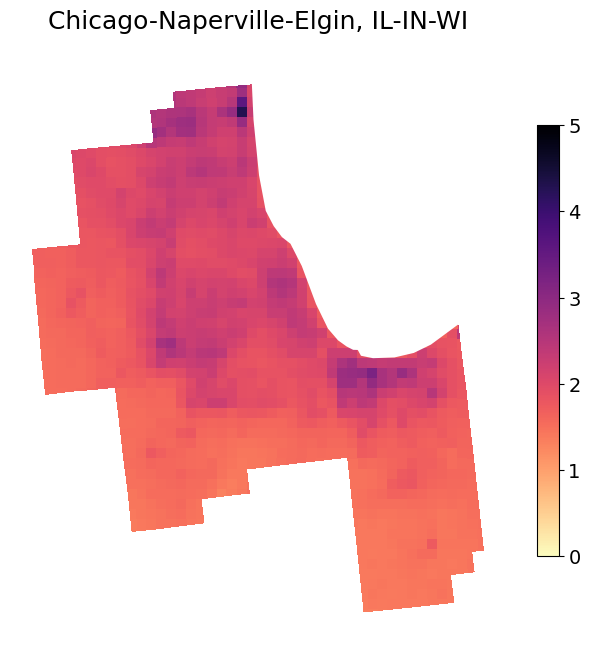

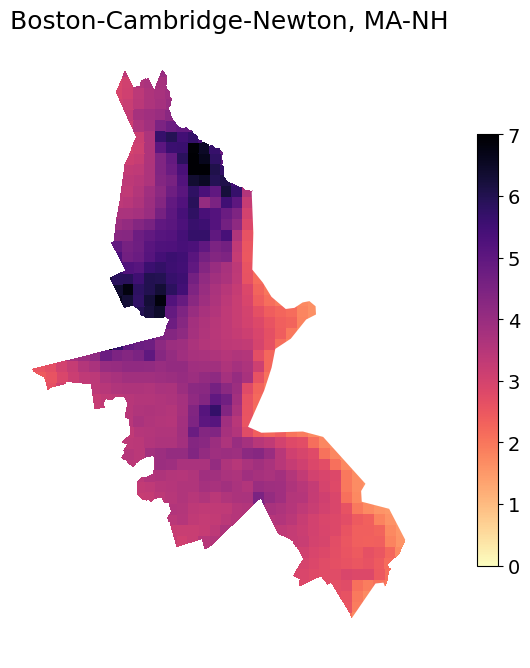

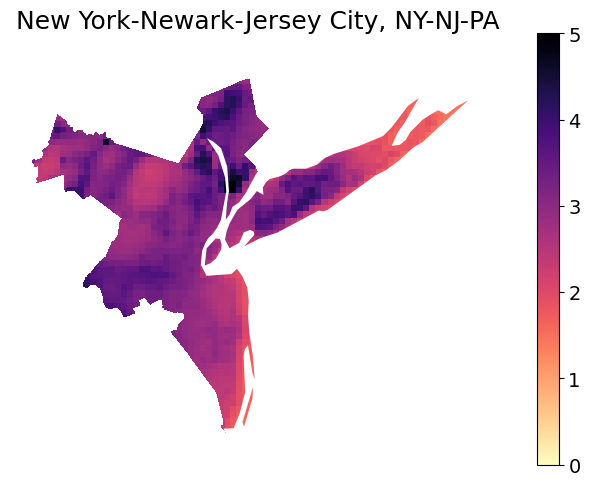

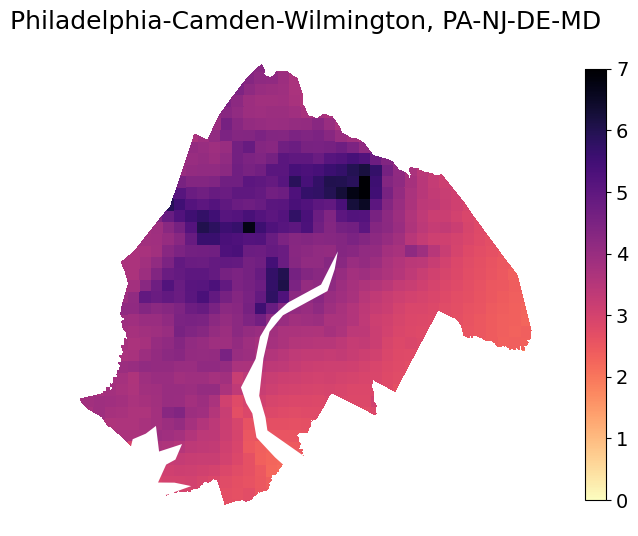

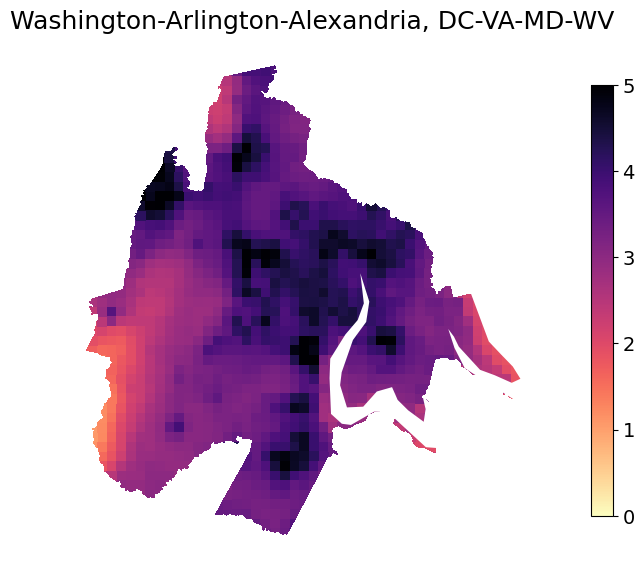

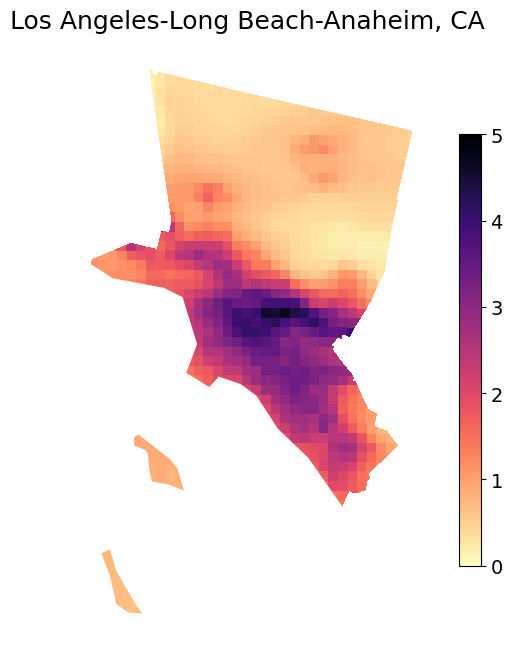

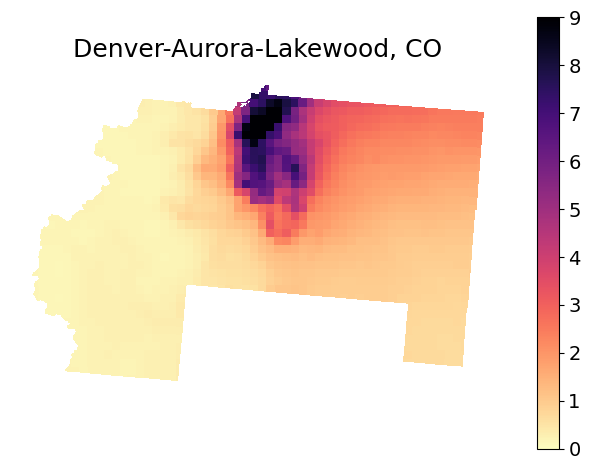

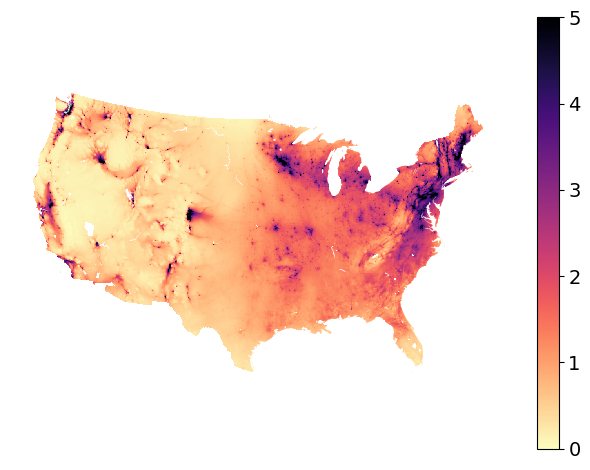

In [129]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Rectangle

# Initialize the figure
target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))

fig = plt.figure(figsize=(16, 14))  # Larger figure to accommodate everything

# Custom positions (x1, x2, y1, y2) for each subplot, adjusted for add_axes format
positions = {
    "Seattle-Tacoma-Bellevue, WA": (0, 0.2, 0, 0.3),  # Top left
    "Minneapolis-St. Paul-Bloomington, MN-WI": (0.2, 0.52, 0, 0.3),  # Top-center-left
    "Chicago-Naperville-Elgin, IL-IN-WI": (0.52, 0.75, 0, 0.3),  # Top-center-right
    "Boston-Cambridge-Newton, MA-NH": (0.75, 1, 0, 0.4),  # Top-right
    "New York-Newark-Jersey City, NY-NJ-PA": (0.75, 1, 0.4, 0.7),  # Right-middle
    "Philadelphia-Camden-Wilmington, PA-NJ-DE-MD": (0.6, 1, 0.7, 1),  # Bottom-left
    "Washington-Arlington-Alexandria, DC-VA-MD-WV": (0.25, 0.6, 0.7, 1),  # Bottom-right
    "Los Angeles-Long Beach-Anaheim, CA": (0, 0.25, 0.65, 1),  # Right-middle
    "Denver-Aurora-Lakewood, CO": (0, 0.25, 0.3, 0.65),  # Bottom-left-center
    "": (0.25, 0.75, 0.3, 0.7),  # Bottom-center
}

# Convert positions to the format (left, bottom, width, height)
converted_positions = {
    key: (x1, 1 - y2, x2 - x1, y2 - y1)  # Calculate width and height from x1, x2, y1, y2
    for key, (x1, x2, y1, y2) in positions.items()
}

# Loop through each MSA and plot
for MSA, pos in list(converted_positions.items())[0:]:
    df = pmgdf  # Assuming pmgdf is the data frame

    fig, ax = plt.subplots(figsize=(8, 8), subplot_kw={'projection': target_proj})

    # Dynamically determine the upper bound for the color scale
    upper_bound = 5
    if MSA != "":
        if df.loc[df['CBSA'] == MSA]['PM25_RWC_2020'].quantile(0.99) >= 5:
            bound_2020 = np.ceil(df.loc[df['CBSA'] == MSA]['PM25_RWC_2020'].quantile(0.99))
            upper_bound = bound_2020
        place = MSA
    else:
        df = PWC_df
        if df['PM25_RWC_2020'].quantile(0.995) >= 5:
            bound_2020 = np.ceil(df['PM25_RWC_2020'].quantile(0.995))
            upper_bound = bound_2020
        place = "CONUS"


    sc, sm = plot_MSA(
        df=df,
        col="PM25_RWC_2020",
        cbsa=cbsa,
        MSA=MSA,
        title=f'{place}',
        cmap="magma_r",
        vs=[0, upper_bound],
        counties=False,
        difference=False,
        ax=ax,
        title_size=15
    )
    
    # Adjust colorbar
    cbar = fig.colorbar(sm, ax=ax, orientation="vertical", shrink=0.7)
    cbar.ax.tick_params(labelsize=14)
    
    # Adjust title position to ensure it fits within the axis
    ax.set_title(MSA, fontsize=18, pad=10)  # Adjust the pad value as necessary
    
    #ax.set_aspect('auto')
    #ax.set_clip_on(True)

# Manually adjust subplot layout to ensure everything fits well
plt.show()


## Poster Plotting

In [8]:
import matplotlib.pyplot as plt
from pyproj import CRS, Transformer
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from shapely.geometry import box
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize


def plot_MSA(df, cbsa, MSA, title, col="PM25", cmap="viridis", vs=False, counties=False, difference=False, state_color="white", ax=None, title_size = 16):
    from shapely.geometry import box
    
    # Define the target projection
    target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))
    
    # Generate map features
    resol = '50m'
    bodr = cfeature.NaturalEarthFeature(category='cultural', edgecolor='white', name='admin_0_boundary_lines_land', scale='50m', facecolor='none', alpha=0.7)
    ocean = cfeature.NaturalEarthFeature('physical', 'ocean', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    lakes = cfeature.NaturalEarthFeature('physical', 'lakes', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    states_provinces = cfeature.NaturalEarthFeature(category='cultural', name='admin_1_states_provinces_lines', scale='50m', edgecolor=state_color, facecolor='none')
    
    # Customize plot appearance
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.set_xticks([])
    ax.set_yticks([])
    
    # Add features to the map
    # if counties:
    #     ax.add_feature(COUNTIES, facecolor='none', edgecolor=state_color)
    ax.add_feature(ocean, linewidth=0, zorder=0, facecolor = "white")
    ax.add_feature(lakes, linewidth=0, zorder=0, facecolor = "white")
    # ax.add_feature(states_provinces, edgecolor=state_color, linewidth=0.5, zorder=0)
    
    # Get the geometry for the specified MSA
    if MSA != "":
        msa_geometry = cbsa.loc[cbsa["NAME"] == MSA, "geometry"].iloc[0]
        clipped_df = df.clip(mask=msa_geometry)
    else:
        msa_geometry = boundaries.geometry
        clipped_df = df  
    
    # Set visualization limits
    if vs:
        vmin = vs[0]
        vmax = vs[1]
    elif not difference:
        vmin = np.quantile(clipped_df[col], 0.025)
        vmax = np.quantile(clipped_df[col], 0.975)
    else:
        vmin = -max(abs(np.quantile(clipped_df[col], 0.025)), abs(np.quantile(clipped_df[col], 0.975)))
        vmin = max(vmin, -20)
        vmax = -vmin
    
    # Plot clipped data
    legend_bool = True
    sc = clipped_df.plot(ax=ax, column=col, cmap=cmap, legend=False, vmin=vmin, vmax=vmax, zorder=-1, edgecolor="none", antialiased=False)

    # Create the ScalarMappable for the color bar
    norm = Normalize(vmin=vmin, vmax=vmax)
    sm = ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])  # Required for colorbar
    
    
    # Add the CBSA boundary
    #ax.add_geometries([msa_geometry], crs=target_proj, edgecolor=state_color, facecolor='none', linewidth=1.5)
    ax.set_title(title, fontsize=title_size)
    # Add title
    #set_centered_title(ax, title, title_size)
    #ax.set_title(title, fontsize=title_size, loc='center', pad=5, x=0.5, y=-1.05)
    #ax.text(0.5, ax.get_ylim()[1] + 0.05 * (ax.get_ylim()[1] - ax.get_ylim()[0]), title, ha='center', va='bottom', fontsize=title_size, transform=ax.transAxes)

    ax.axis("off")
    return sc, sm




In [9]:
import pandas as pd

# most populous 20
cbsa_list = [
    "New York-Newark-Jersey City, NY-NJ-PA",
    "Los Angeles-Long Beach-Anaheim, CA",
    "Chicago-Naperville-Elgin, IL-IN-WI",
    "Dallas-Fort Worth-Arlington, TX",
    "Houston-The Woodlands-Sugar Land, TX",
    "Washington-Arlington-Alexandria, DC-VA-MD-WV",
    "Miami-Fort Lauderdale-Pompano Beach, FL",
    "Philadelphia-Camden-Wilmington, PA-NJ-DE-MD",
    "Atlanta-Sandy Springs-Alpharetta, GA",
    "Boston-Cambridge-Newton, MA-NH",
    "Phoenix-Mesa-Chandler, AZ",
    "San Francisco-Oakland-Berkeley, CA",
    "Riverside-San Bernardino-Ontario, CA",
    "Detroit-Warren-Dearborn, MI",
    "Seattle-Tacoma-Bellevue, WA",
    "Minneapolis-St. Paul-Bloomington, MN-WI",
    "San Diego-Chula Vista-Carlsbad, CA",
    "Tampa-St. Petersburg-Clearwater, FL",
    "Denver-Aurora-Lakewood, CO",
    "St. Louis, MO-IL"
]


# Initialize an empty list to hold the data
data = []

# Iterate through each CBSA in the list
for cbsa in cbsa_list:
    cbsa_df = pmgdf[pmgdf['CBSA'] == cbsa]
    pm_2014 = cbsa_df['PM25'].mean()
    pm_2020 = cbsa_df['PM25_2020'].mean()
    pm_2014_RWC = cbsa_df['PM25_RWC'].mean()
    pm_2020_RWC = cbsa_df['PM25_RWC_2020'].mean()
    percent_2014_RWC = pm_2014_RWC / pm_2014 * 100 if pm_2014 != 0 else None
    percent_2020_RWC = pm_2020_RWC / pm_2020 * 100 if pm_2020 != 0 else None
    
    # Append the results as a dictionary
    data.append({
        "CBSA": cbsa,
        "PM25_2014": pm_2014,
        "PM25_2020": pm_2020,
        "PM25_2014_RWC": pm_2014_RWC,
        "PM25_2020_RWC": pm_2020_RWC,
        "Percent_2014_RWC": percent_2014_RWC,
        "Percent_2020_RWC": percent_2020_RWC
    })

# Create a DataFrame from the data
result_df = pd.DataFrame(data)

# Display the resulting DataFrame
result_df

,CBSA,PM25_2014,PM25_2020,PM25_2014_RWC,PM25_2020_RWC,Percent_2014_RWC,Percent_2020_RWC
0,"New York-Newark-Jersey City, NY-NJ-PA",9.936447,9.524757,3.132652,2.720961,31.526878,28.567246
1,"Los Angeles-Long Beach-Anaheim, CA",7.706074,8.489700,0.646884,1.430511,8.394473,16.849963
2,"Chicago-Naperville-Elgin, IL-IN-WI",10.655350,10.350946,2.102511,1.798109,19.731979,17.371443
3,"Dallas-Fort Worth-Arlington, TX",10.390643,10.065053,1.323147,0.997556,12.734023,9.911084
4,"Houston-The Woodlands-Sugar Land, TX",11.684503,11.111420,1.646722,1.073640,14.093214,9.662487
5,"Washington-Arlington-Alexandria, DC-VA-MD-WV",10.770737,11.215643,2.987552,3.432459,27.737674,30.604210
6,"Miami-Fort Lauderdale-Pompano Beach, FL",5.858727,5.526706,0.678805,0.346784,11.586218,6.274699
7,"Philadelphia-Camden-Wilmington, PA-NJ-DE-MD",13.029241,12.713652,4.220122,3.904533,32.389623,30.711338
8,"Atlanta-Sandy Springs-Alpharetta, GA",12.619260,11.965722,2.298345,1.644809,18.212996,13.746005
9,"Boston-Cambridge-Newton, MA-NH",7.496204,8.276896,2.614211,3.394903,34.873796,41.016623


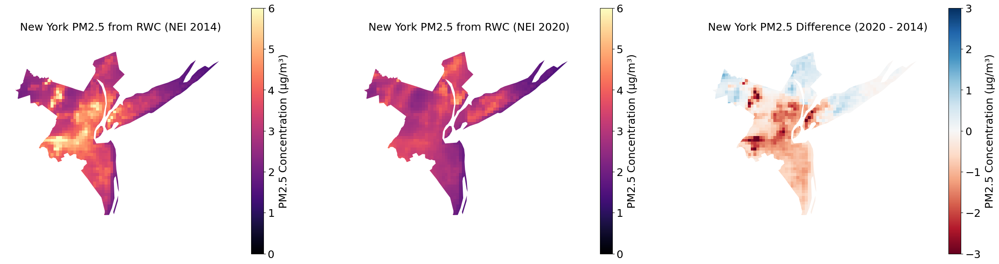

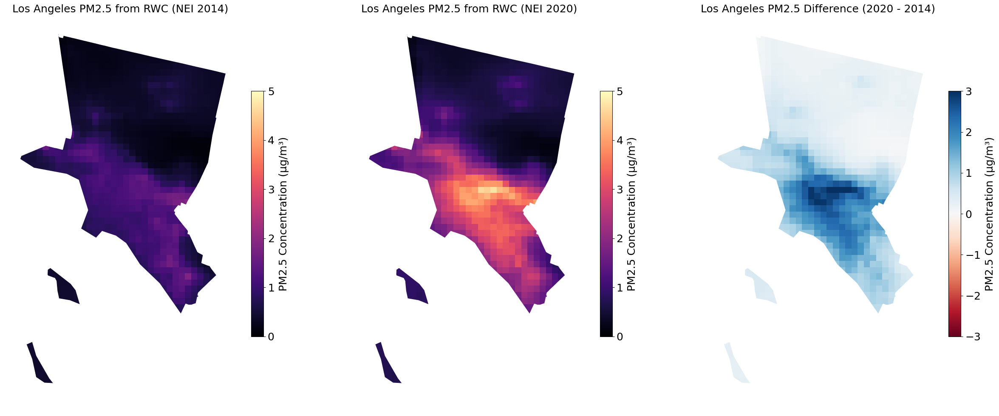

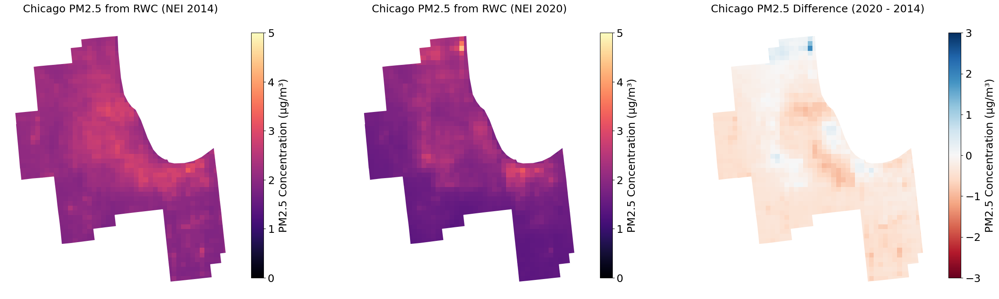

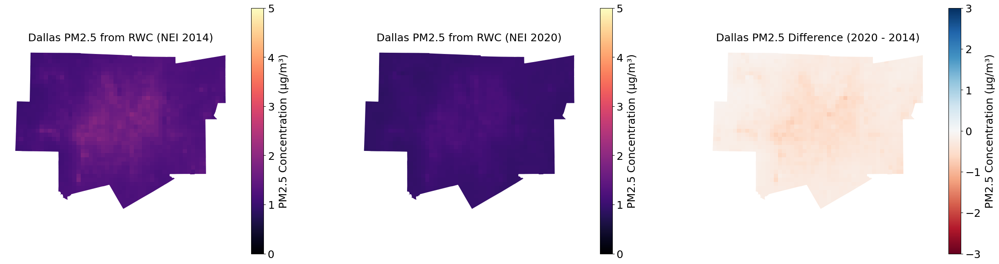

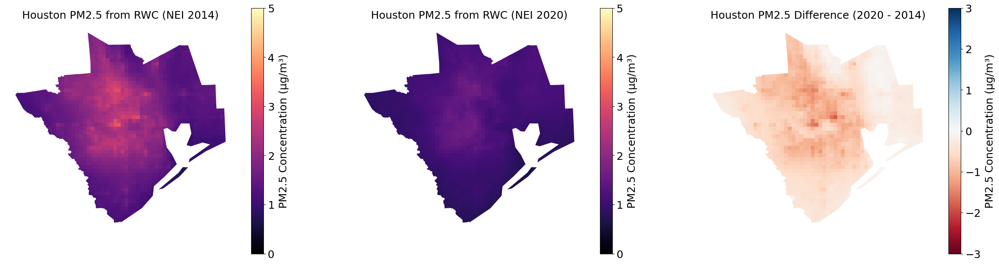

...

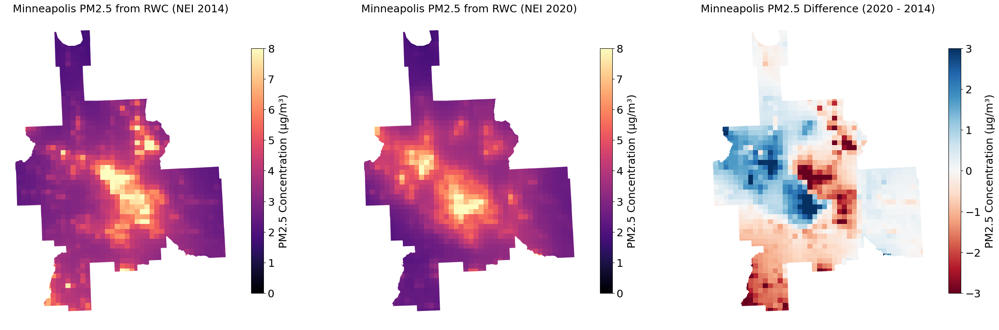

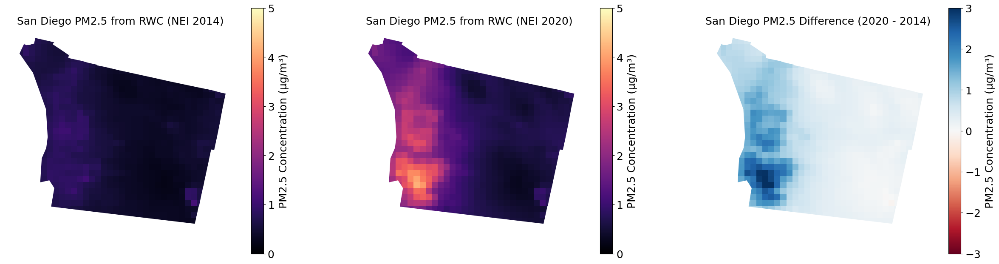

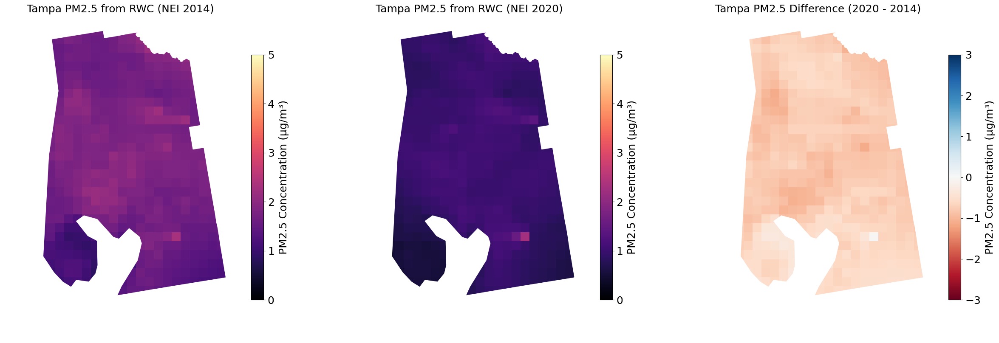

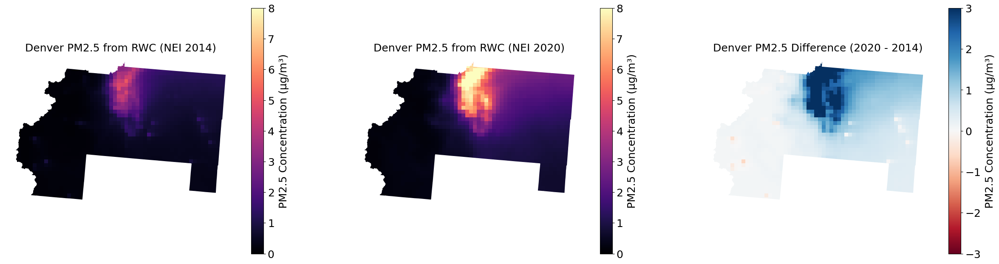

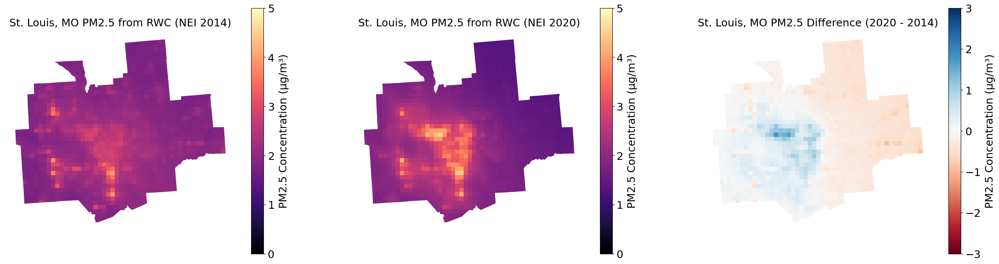

In [32]:
for MSA in cbsa_list:
    df = pmgdf

    upper_bound = 5
    if df.loc[df['CBSA'] == MSA]['PM25_RWC'].quantile(0.98) >= 5 or  df.loc[df['CBSA'] == MSA]['PM25_RWC_2020'].quantile(0.98) >= 5:
        bound_2014 = np.ceil(df.loc[df['CBSA'] == MSA]['PM25_RWC_2020'].quantile(0.98))
        bound_2020 = np.ceil(df.loc[df['CBSA'] == MSA]['PM25_RWC'].quantile(0.98))
        upper_bound = max(bound_2014, bound_2020)
    
    # Create a Matplotlib figure with 1 row and 3 columns
    target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30, 30), subplot_kw={'projection': target_proj})
    
    place = MSA.split('-')[0]
    
    sc, sm = plot_MSA(
            df=df,
            col="PM25_RWC",
            cbsa = cbsa,
            MSA=MSA,
            title=f'{place} PM2.5 from RWC (NEI 2014)',
            cmap="magma_r",
            vs=[0, upper_bound],
            counties=False,
            difference=False,
            ax=axes[0],
            title_size = 18
        )
    colorbar_title_size = 18
    colorbar_tick_size = 18
    
    cbar = fig.colorbar(sm, ax=axes[0], orientation="vertical", shrink=0.25)
    cbar.ax.tick_params(labelsize=18)
    cbar.ax.set_ylabel("PM2.5 Concentration (µg/m³)", rotation=90, fontsize=18, labelpad = 7)


    sc, sm = plot_MSA(
            df=df,
            col="PM25_RWC_2020",
            cbsa = cbsa,
            MSA=MSA,
            title=f'{place} PM2.5 from RWC (NEI 2020)',
            cmap="magma_r",
            vs=[0, upper_bound],
            counties=False,
            difference=False,
            ax=axes[1],
            title_size = 18
        )
    cbar = fig.colorbar(sm, ax=axes[1], orientation="vertical", shrink=0.25)
    cbar.ax.tick_params(labelsize=18)
    cbar.ax.set_ylabel("PM2.5 Concentration (µg/m³)", rotation=90, fontsize=18, labelpad = 7)   
    
    sc, sm = plot_MSA(
            df=df,
            col="PM25_diff",
            cbsa = cbsa,
            MSA=MSA,
            title=f'{place} PM2.5 Difference (2020 - 2014)',
            cmap="RdBu",
            vs=[-3, 3],
            counties=False,
            difference=True,
            ax=axes[2],
            title_size = 18
        )
    colorbar_title_size = 18
    colorbar_tick_size = 18
    
    cbar = fig.colorbar(sm, ax=axes[2], orientation="vertical", shrink=0.25)
    cbar.ax.tick_params(labelsize=18)
    cbar.ax.set_ylabel("PM2.5 Concentration (µg/m³)", rotation=90, fontsize=18, labelpad = 7)
    plt.show()


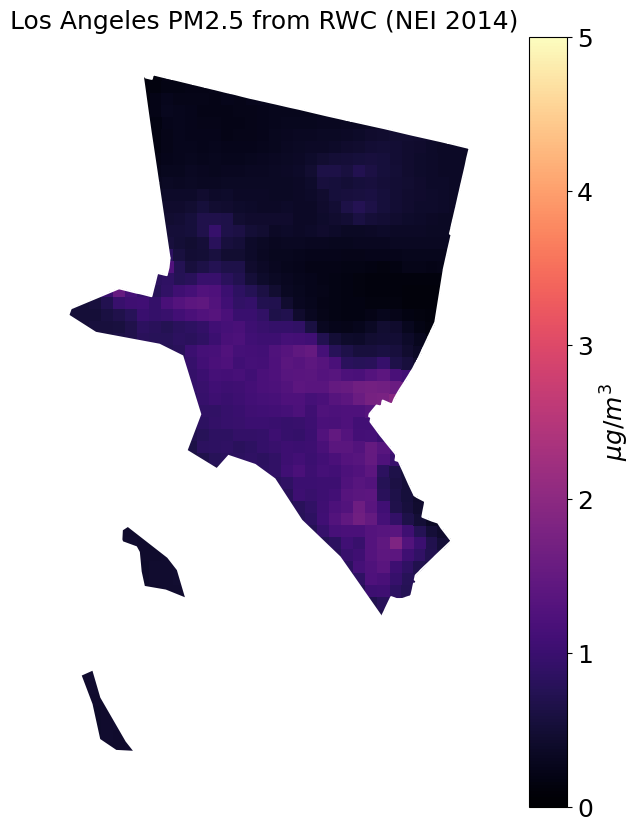

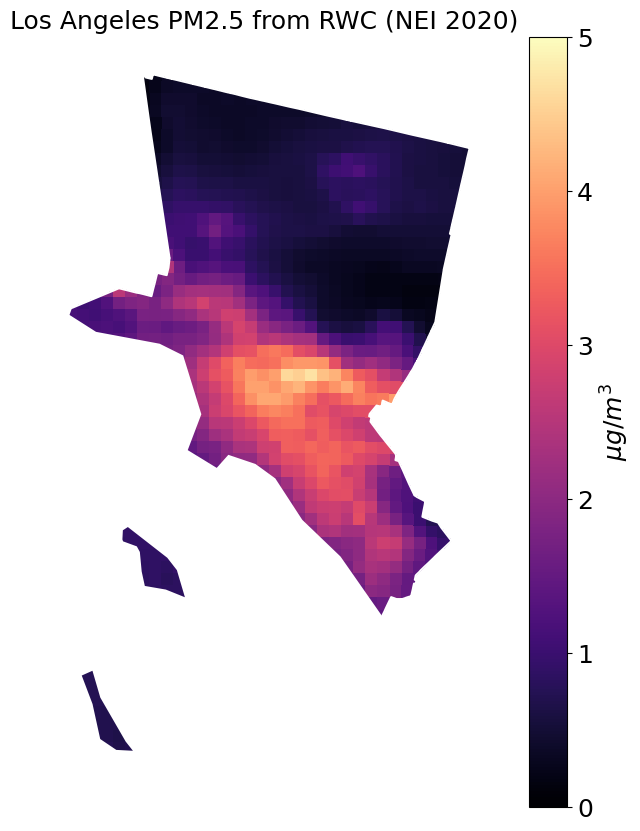

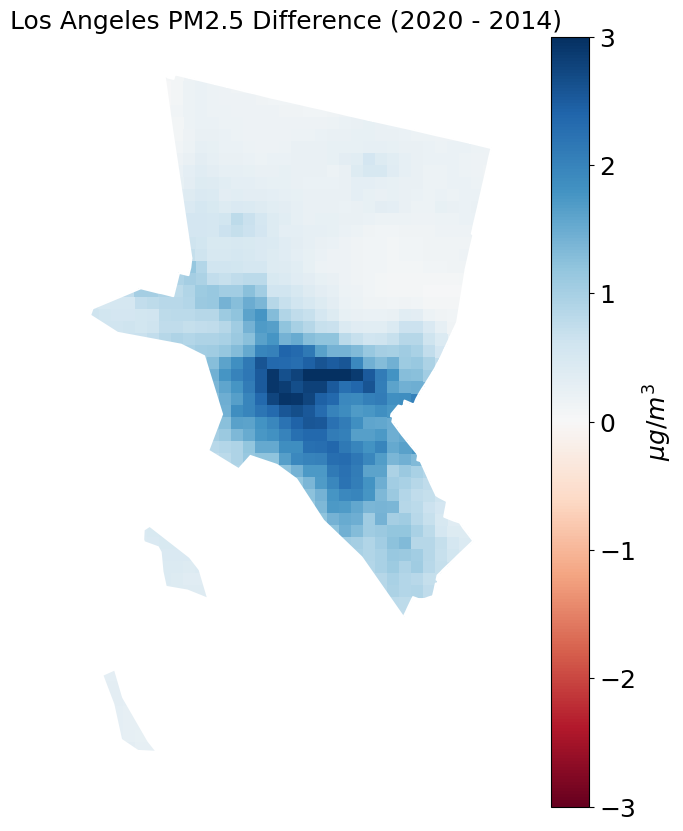

In [220]:
df = pmgdf
MSA='Los Angeles-Long Beach-Anaheim, CA'

# Create a Matplotlib figure with 1 row and 3 columns
target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 10), subplot_kw={'projection': target_proj})

place = MSA.split('-')[0]

sc = plot_MSA(
        df=df,
        col="PM25_RWC",
        cbsa = cbsa,
        MSA=MSA,
        title=f'{place} PM2.5 from RWC (NEI 2014)',
        cmap="magma",
        vs=[0, 5],
        counties=False,
        difference=False,
        ax=axes,
        title_size = 18
    )
colorbar_title_size = 18
colorbar_tick_size = 18

cbar = axes.get_figure().axes[-1]  # The colorbar is typically the last axis
cbar.set_ylabel(r"$\mu g/m^3$", fontsize=colorbar_title_size)  # Add label
cbar.tick_params(labelsize=colorbar_tick_size)
plt.show()


fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 10), subplot_kw={'projection': target_proj})

sc = plot_MSA(
        df=df,
        col="PM25_RWC_2020",
        cbsa = cbsa,
        MSA=MSA,
        title=f'{place} PM2.5 from RWC (NEI 2020)',
        cmap="magma",
        vs=[0, 5],
        counties=False,
        difference=False,
        ax=axes,
        title_size = 18
    )

cbar = axes.get_figure().axes[-1]  # The colorbar is typically the last axis
cbar.set_ylabel(r"$\mu g/m^3$", fontsize=colorbar_title_size)  # Add label
cbar.tick_params(labelsize=colorbar_tick_size)
plt.show()

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 10), subplot_kw={'projection': target_proj})

sc = plot_MSA(
        df=df,
        col="PM25_diff",
        cbsa = cbsa,
        MSA=MSA,
        title=f'{place} PM2.5 Difference (2020 - 2014)',
        cmap="RdBu",
        vs=[-3, 3],
        counties=False,
        difference=True,
        ax=axes,
        title_size = 18
    )
colorbar_title_size = 18
colorbar_tick_size = 18

cbar = axes.get_figure().axes[-1]  # The colorbar is typically the last axis
cbar.set_ylabel(r"$\mu g/m^3$", fontsize=colorbar_title_size)  # Add label
cbar.tick_params(labelsize=colorbar_tick_size)
plt.show()


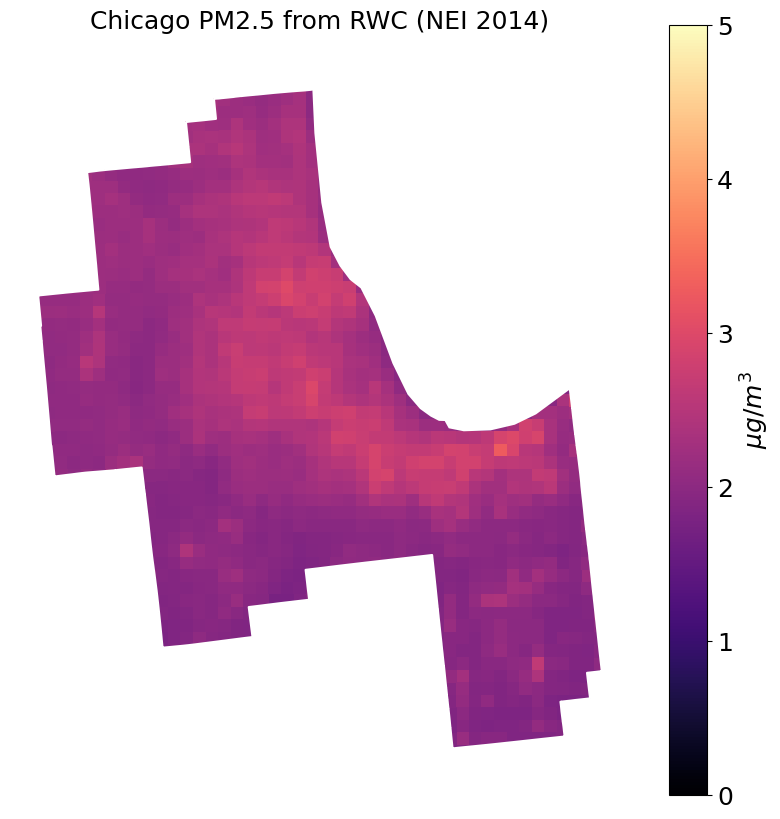

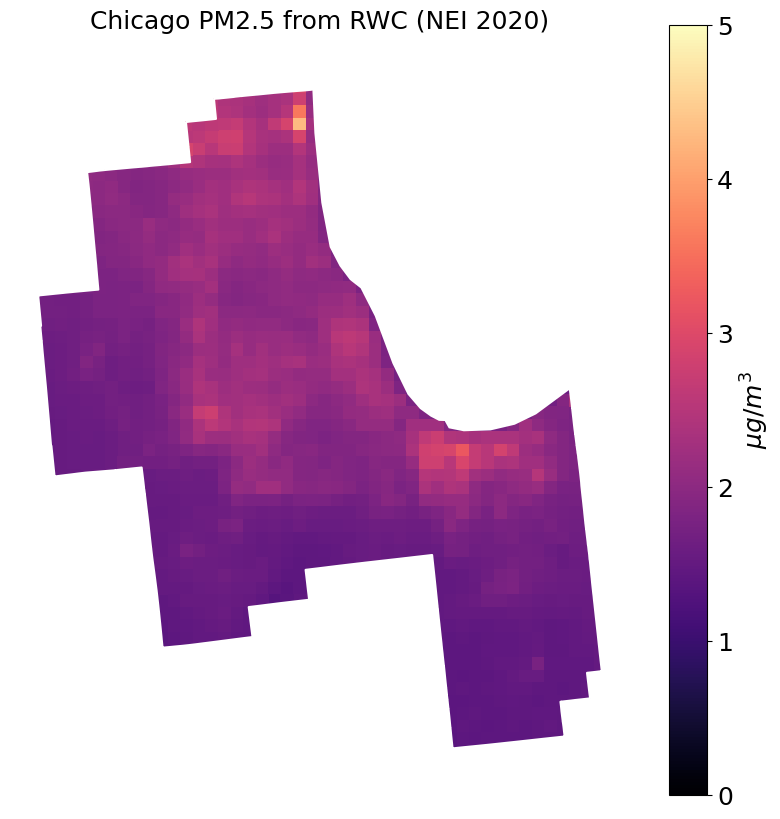

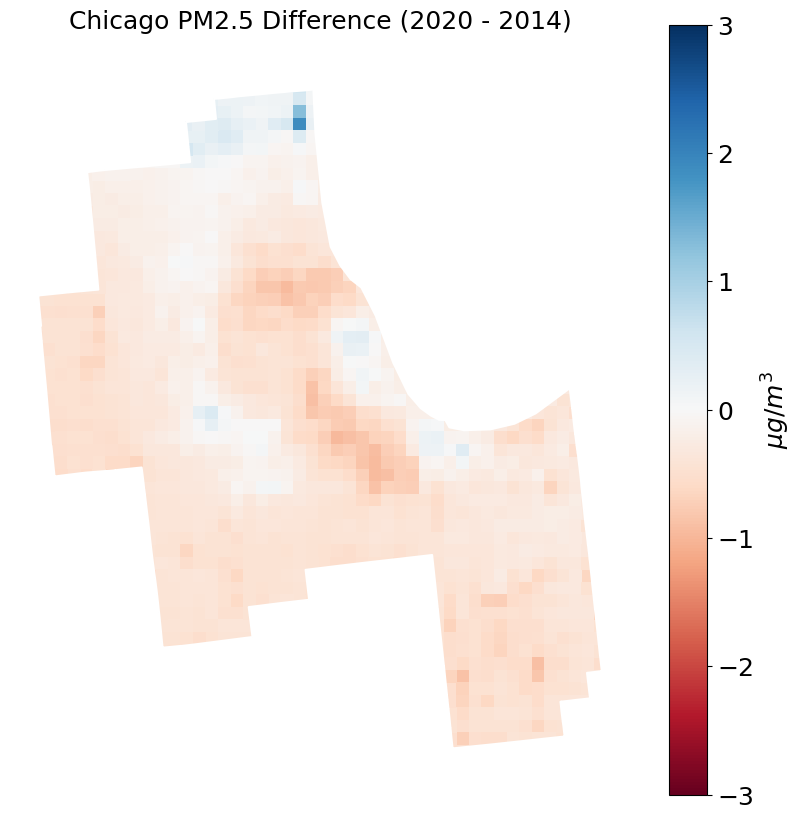

In [63]:
df = pmgdf
MSA='Chicago-Naperville-Elgin, IL-IN-WI'

# Create a Matplotlib figure with 1 row and 3 columns
target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 10), subplot_kw={'projection': target_proj})

place = MSA.split('-')[0]

sc = plot_MSA(
        df=df,
        col="PM25_RWC",
        cbsa = cbsa,
        MSA=MSA,
        title=f'{place} PM2.5 from RWC (NEI 2014)',
        cmap="magma",
        vs=[0, 5],
        counties=False,
        difference=False,
        ax=axes,
        title_size = 18
    )
colorbar_title_size = 18
colorbar_tick_size = 18

cbar = axes.get_figure().axes[-1]  # The colorbar is typically the last axis
cbar.set_ylabel(r"$\mu g/m^3$", fontsize=colorbar_title_size)  # Add label
cbar.tick_params(labelsize=colorbar_tick_size)
plt.show()


fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 10), subplot_kw={'projection': target_proj})

sc = plot_MSA(
        df=df,
        col="PM25_RWC_2020",
        cbsa = cbsa,
        MSA=MSA,
        title=f'{place} PM2.5 from RWC (NEI 2020)',
        cmap="magma",
        vs=[0, 5],
        counties=False,
        difference=False,
        ax=axes,
        title_size = 18
    )

cbar = axes.get_figure().axes[-1]  # The colorbar is typically the last axis
cbar.set_ylabel(r"$\mu g/m^3$", fontsize=colorbar_title_size)  # Add label
cbar.tick_params(labelsize=colorbar_tick_size)
plt.show()

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 10), subplot_kw={'projection': target_proj})

sc = plot_MSA(
        df=df,
        col="PM25_diff",
        cbsa = cbsa,
        MSA=MSA,
        title=f'{place} PM2.5 Difference (2020 - 2014)',
        cmap="RdBu",
        vs=[-3, 3],
        counties=False,
        difference=True,
        ax=axes,
        title_size = 18
    )
colorbar_title_size = 18
colorbar_tick_size = 18

cbar = axes.get_figure().axes[-1]  # The colorbar is typically the last axis
cbar.set_ylabel(r"$\mu g/m^3$", fontsize=colorbar_title_size)  # Add label
cbar.tick_params(labelsize=colorbar_tick_size)
plt.show()


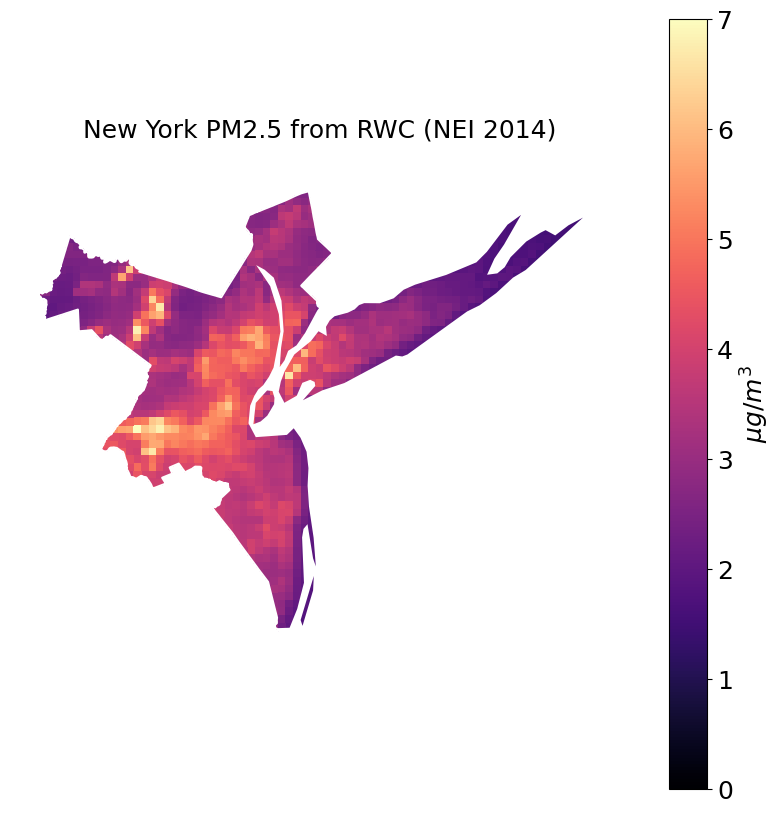

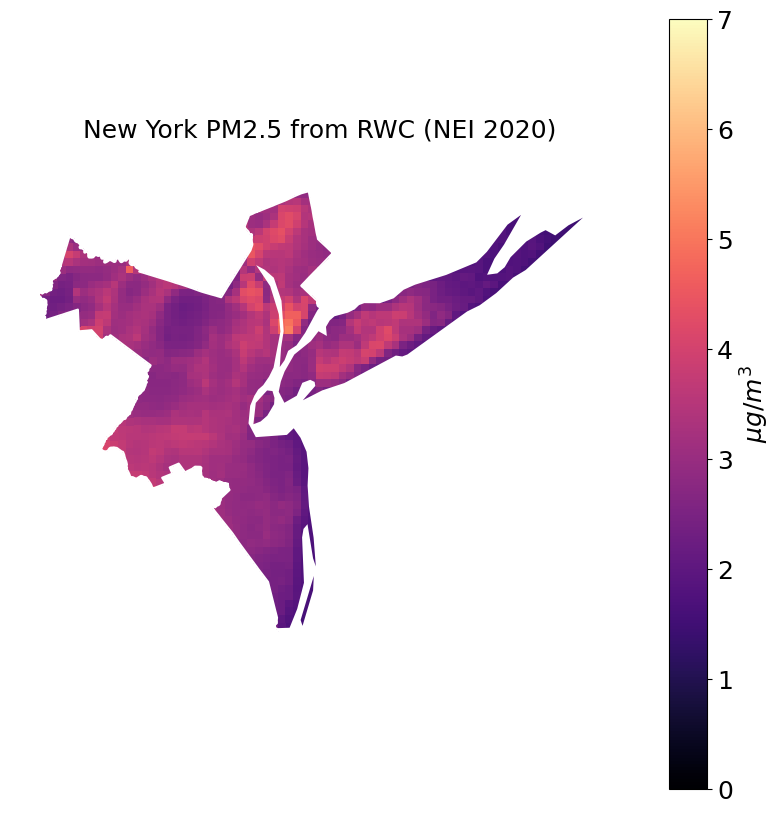

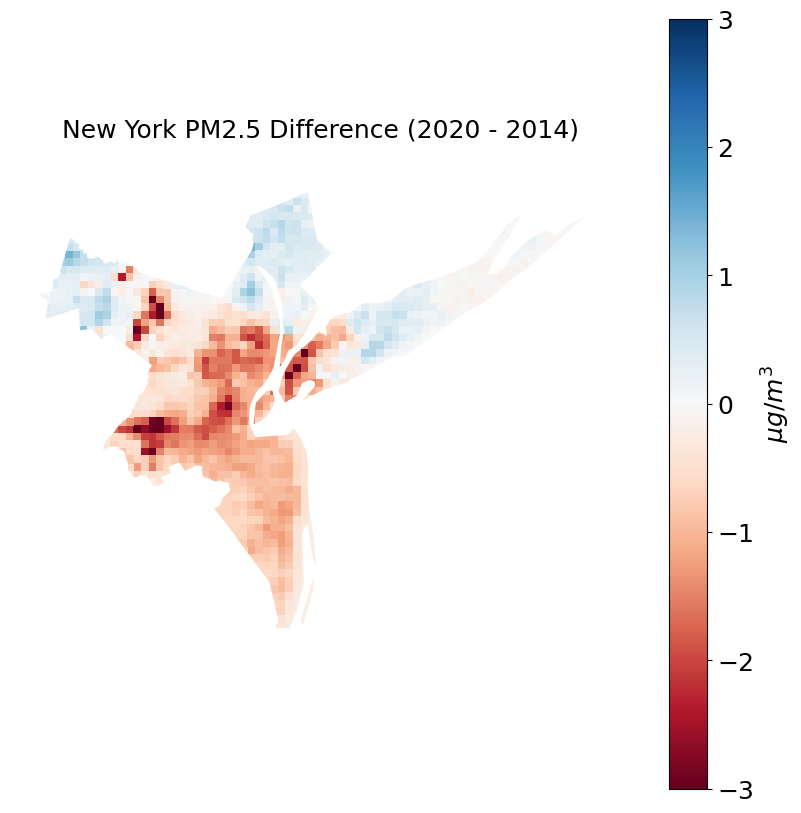

In [66]:
MSA = 'New York-Newark-Jersey City, NY-NJ-PA'
# Create a Matplotlib figure with 1 row and 3 columns
target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 10), subplot_kw={'projection': target_proj})

place = MSA.split('-')[0]

sc = plot_MSA(
        df=df,
        col="PM25_RWC",
        cbsa = cbsa,
        MSA=MSA,
        title=f'{place} PM2.5 from RWC (NEI 2014)',
        cmap="magma",
        vs=[0, 7],
        counties=False,
        difference=False,
        ax=axes,
        title_size = 18
    )
colorbar_title_size = 18
colorbar_tick_size = 18

cbar = axes.get_figure().axes[-1]  # The colorbar is typically the last axis
cbar.set_ylabel(r"$\mu g/m^3$", fontsize=colorbar_title_size)  # Add label
cbar.tick_params(labelsize=colorbar_tick_size)
plt.show()


fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 10), subplot_kw={'projection': target_proj})

sc = plot_MSA(
        df=df,
        col="PM25_RWC_2020",
        cbsa = cbsa,
        MSA=MSA,
        title=f'{place} PM2.5 from RWC (NEI 2020)',
        cmap="magma",
        vs=[0, 7],
        counties=False,
        difference=False,
        ax=axes,
        title_size = 18
    )

cbar = axes.get_figure().axes[-1]  # The colorbar is typically the last axis
cbar.set_ylabel(r"$\mu g/m^3$", fontsize=colorbar_title_size)  # Add label
cbar.tick_params(labelsize=colorbar_tick_size)
plt.show()

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 10), subplot_kw={'projection': target_proj})

sc = plot_MSA(
        df=df,
        col="PM25_diff",
        cbsa = cbsa,
        MSA=MSA,
        title=f'{place} PM2.5 Difference (2020 - 2014)',
        cmap="RdBu",
        vs=[-3, 3],
        counties=False,
        difference=True,
        ax=axes,
        title_size = 18
    )
colorbar_title_size = 18
colorbar_tick_size = 18

cbar = axes.get_figure().axes[-1]  # The colorbar is typically the last axis
cbar.set_ylabel(r"$\mu g/m^3$", fontsize=colorbar_title_size)  # Add label
cbar.tick_params(labelsize=colorbar_tick_size)
plt.show()


In [10]:
# MSA data
cbsa = gpd.read_file('cbsa/tl_2019_us_cbsa.shp', engine="pyogrio")

# Convert the GeoDataFrame to the target CRS
cbsa = cbsa.to_crs("+proj=lcc +lat_1=33 +lat_2=45 +lon_0=-97 +lat_0=40")

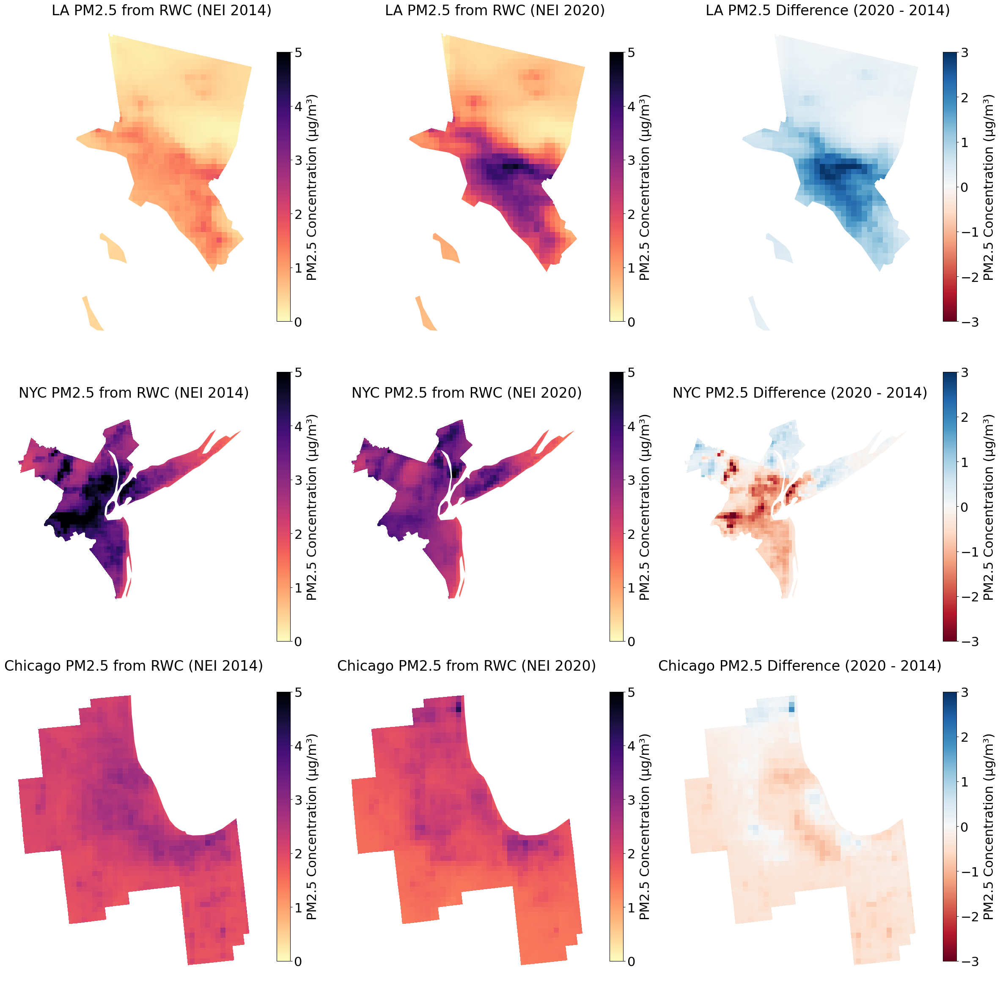

In [13]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

# List of MSAs to plot
MSAs = [
    'Los Angeles-Long Beach-Anaheim, CA',
    'New York-Newark-Jersey City, NY-NJ-PA',
    'Chicago-Naperville-Elgin, IL-IN-WI'
]

# Create a Matplotlib figure with 3 rows and 3 columns
target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(30, 30), subplot_kw={'projection': target_proj})

# Adjust spacing between subplots
fig.subplots_adjust(hspace=-0.05, wspace=0.05)

df = pmgdf

# Iterate through MSAs and plot data
for i, MSA in enumerate(MSAs):
    place = MSA.split('-')[0]

    if place == "Los Angeles": place = "LA"
    if place == "New York": place = "NYC"

    # Plot for 2014 PM2.5 data
    sc, sm = plot_MSA(
        df=df,
        col="PM25_RWC",
        cbsa=cbsa,
        MSA=MSA,
        title=f'{place} PM2.5 from RWC (NEI 2014)',
        cmap="magma_r",
        vs=[0, 5],
        counties=False,
        difference=False,
        ax=axes[i, 0],  # Use the first column for 2014 data
        title_size=24
    )
    #Add color bar
    cbar = fig.colorbar(sm, ax=axes[i, 0], orientation="vertical", shrink=0.8)
    cbar.ax.tick_params(labelsize=22)
    cbar.ax.set_ylabel("PM2.5 Concentration (µg/m³)", rotation=90, fontsize=22, labelpad = 7)
    
    # Plot for 2020 PM2.5 data
    sc, sm = plot_MSA(
        df=df,
        col="PM25_RWC_2020",
        cbsa=cbsa,
        MSA=MSA,
        title=f'{place} PM2.5 from RWC (NEI 2020)',
        cmap="magma_r",
        vs=[0, 5],
        counties=False,
        difference=False,
        ax=axes[i, 1],  # Use the second column for 2020 data
        title_size=24
    )
    # Add color bar
    cbar = fig.colorbar(sm, ax=axes[i, 1], orientation="vertical", shrink=0.8)
    cbar.ax.tick_params(labelsize=22)
    cbar.ax.set_ylabel("PM2.5 Concentration (µg/m³)", rotation=90, fontsize=22, labelpad = 7)

    # Plot for PM2.5 difference data
    sc, sm  = plot_MSA(
        df=df,
        col="PM25_diff",
        cbsa=cbsa,
        MSA=MSA,
        title=f'{place} PM2.5 Difference (2020 - 2014)',
        cmap="RdBu",
        vs=[-3, 3],
        counties=False,
        difference=True,
        ax=axes[i, 2],  # Use the third column for difference data
        title_size=24
    )
    # Add color bar
    cbar = fig.colorbar(sm, ax=axes[i, 2], orientation="vertical", shrink=0.8)
    cbar.ax.tick_params(labelsize=22)
    cbar.ax.set_ylabel("PM2.5 Concentration (µg/m³)", rotation=90, fontsize=22, labelpad = 7)
# Show the plot
plt.show()


## City Plotting With Validation

In [120]:
import matplotlib.pyplot as plt
from pyproj import CRS, Transformer
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from shapely.geometry import box


def plot_MSA(df, MSA, title, validation_df, col="PM25", cmap="viridis", vs=False, counties=False, difference=False, state_color="white", ax=None):
    # Define the target projection
    # Define the target projection
    target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))
    
    # Generate map features
    resol = '50m'  # use data at this scale
    bodr = cfeature.NaturalEarthFeature(category='cultural', edgecolor='black', name='admin_0_boundary_lines_land', scale='50m', facecolor='none', alpha=0.7)
    ocean = cfeature.NaturalEarthFeature('physical', 'ocean', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    lakes = cfeature.NaturalEarthFeature('physical', 'lakes', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    states_provinces = cfeature.NaturalEarthFeature(category='cultural', name='admin_1_states_provinces_lines', scale='50m', edgecolor=state_color, facecolor='none')
    
    # # Customize plot appearance
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.set_xticks([])
    ax.set_yticks([])
    
    # # Add features to the map
    if counties:
        ax.add_feature(COUNTIES, facecolor='none', edgecolor=state_color)
    ax.add_feature(ocean, linewidth=0.2, zorder=0)
    ax.add_feature(lakes, linewidth=0.2, zorder=0)
    ax.add_feature(states_provinces, edgecolor=state_color, linewidth=0.5, zorder=0)
    #ax.add_feature(bodr, linestyle='--', edgecolor=state_color, alpha=1)
    msa_bounds = df.loc[df["CBSA"] == MSA].total_bounds  # [minx, miny, maxx, maxy]
    
    #ax.set_extent([msa_bounds[0], msa_bounds[2], msa_bounds[1], msa_bounds[3]], crs=target_proj)

    buffer_size = 20000  # Example buffer size in the unit of the projection (e.g., meters)
    
    # Apply the buffer to expand the bounding box
    buffered_bounds = [
        msa_bounds[0] - buffer_size,  # minx
        msa_bounds[1] - buffer_size,  # miny
        msa_bounds[2] + buffer_size,  # maxx
        msa_bounds[3] + buffer_size   # maxy
    ]
    
    # Create a box polygon with the buffered bounds
    plot_area = box(*buffered_bounds)
    ax.set_extent([msa_bounds[0] -buffer_size , msa_bounds[2] + buffer_size, msa_bounds[1] - buffer_size, msa_bounds[3] + buffer_size], crs=target_proj)

    
    # Filter the main dataframe for data within the buffered plot area
    sub_df = df[df.geometry.within(plot_area)]
    
    if vs:
        vmin = vs[0]
        vmax = vs[1]
    elif not difference:
        vmin = np.quantile(sub_df[col], 0.025)
        vmax = np.quantile(sub_df[col], 0.975)
    else:
        vmin = -max( [abs(np.quantile(sub_df[col], 0.025)), abs(np.quantile(sub_df[col], 0.975))] )
        if vmin > -20:
            vmin = -20
        vmax = -vmin
    
    # # Plot MSA area data
    legend_bool = (validation_df.empty or difference == True)
    sc = sub_df.plot(ax=ax, column=col, cmap=cmap, legend=legend_bool, vmin=vmin, vmax=vmax, zorder=-1)
    
    msa_geometry = df.loc[df["CBSA"] == MSA, "geometry"].unary_union  # Get combined geometry for the MSA
    # Simplify the geometry to reduce jagged edges
    tolerance = 4000  # Adjust this value as needed for smoother lines (in coordinate units)
    simplified_msa_geometry = msa_geometry.simplify(tolerance, preserve_topology=True)
    
    # Plot the simplified geometry
    ax.add_geometries([simplified_msa_geometry], crs=target_proj, edgecolor=state_color, facecolor='none', linewidth=1.5)
    
    # Plot validation points
    if not validation_df.empty:
        # MSA bounds in Lambert Conformal coordinates (convert from kilometers to degrees)
        #bounds = sub_df.total_bounds
    
        # Define the projection used for the MSA bounds (Lambert Conformal)
        msa_proj = CRS(proj='lcc', lat_1=33, lat_2=45, lon_0=-97, lat_0=40, x_0=0, y_0=0)
    
        # Define the transformer for converting from Lambert Conformal to geographic (EPSG:4326)
        transformer = Transformer.from_crs(msa_proj, CRS.from_epsg(4326), always_xy=True)
    
        # Transform bounding box to geographic coordinates (longitude/latitude)
        lon_min, lat_min = transformer.transform(msa_bounds[0], msa_bounds[1])
        lon_max, lat_max = transformer.transform(msa_bounds[2], msa_bounds[3])
    
        # Subselect validation points that fall within the MSA's transformed bounding box
        validation_within_MSA = validation_df[
            (validation_df['Longitude'] >= lon_min) & (validation_df['Longitude'] <= lon_max) &
            (validation_df['Latitude'] >= lat_min) & (validation_df['Latitude'] <= lat_max)
        ]
    
        # Plot validation points as large dots
        sc = ax.scatter(validation_within_MSA['Longitude'], validation_within_MSA['Latitude'],
                        c=validation_within_MSA['μd'], cmap=cmap,
                        s=100, edgecolor='black', transform=ccrs.PlateCarree(), vmin=vmin, vmax=vmax, zorder=3)
    
    
    # Add title and return the subset of the data
    ax.set_title(title)
    return sc

def plot_multiple_MSA(df, validation_df, MSA, vs1, vs2, vs3 = [0,5]):
    # Create a Matplotlib figure with 1 row and 3 columns
    target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))
    fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(18, 14), subplot_kw={'projection': target_proj})

    place = MSA.split('-')[0]
    
    # Plot for PM2.5
    sc1 = plot_MSA(
        df=df,
        col="PM25",
        MSA=MSA,
        title=f'{place} PM2.5',
        validation_df=validation_df,
        cmap="magma",
        vs=[vs1[0], vs1[1]],
        counties=False,
        difference=False,
        ax=axes[0][0]  # Pass the first axis
    )

    # Plot for PM2.5 2020
    sc2 = plot_MSA(
        df=df,
        col="PM25_2020",
        MSA=MSA,
        title=f'{place} PM2.5 2020',
        validation_df=validation_df,
        cmap="magma",
        vs=[vs1[0], vs1[1]],
        counties=False,
        difference=False,
        ax=axes[0][1]  # Pass the second axis
    )

    # Plot for PM2.5 difference
    sc3 = plot_MSA(
        df=df,
        col="PM25_diff",
        MSA=MSA,
        title=f'{place} PM2.5 2020 - baseline',
        validation_df=pd.DataFrame(),  # No validation points for difference
        cmap="RdBu",
        vs=[vs2[0], vs2[1]],
        counties=False,
        difference=True,
        ax=axes[0][2],
        state_color="black"# Pass the third axis
    )

    #rwc_bounds = max

        # Plot for PM2.5 difference
    sc4 = plot_MSA(
        df=df,
        col="PM25_RWC",
        MSA=MSA,
        title=f'{place} PM2.5 RWC baseline',
        validation_df=pd.DataFrame(),  # No validation points for difference
        cmap="magma",
        vs=[vs3[0], vs3[1]],
        counties=False,
        difference=False,
        ax=axes[1][0],
    )

        # Plot for PM2.5 difference
    sc5 = plot_MSA(
        df=df,
        col="PM25_RWC_2020",
        MSA=MSA,
        title=f'{place} PM2.5 RWC 2020',
        validation_df=pd.DataFrame(),  # No validation points for difference
        cmap="magma",
        vs=[vs3[0], vs3[1]],
        counties=False,
        difference=False,
        ax=axes[1][1],
    )

    sc6 = plot_MSA(
        df=df,
        col="RWC_percent_diff",
        MSA=MSA,
        title=f'{place} PM2.5 RWC % Difference',
        validation_df=pd.DataFrame(),  # No validation points for difference
        cmap="RdBu",
        vs=False,
        counties=False,
        difference=True,
        ax=axes[1][2],
        state_color="black"# Pass the third axis
    )

    # Add colorbars for the first two subplots
    cbar1 = fig.colorbar(sc1, ax=axes[0][0], orientation='vertical')
    cbar1.set_label('Mean Concentration')

    cbar2 = fig.colorbar(sc2, ax=axes[0][1], orientation='vertical')
    cbar2.set_label('Mean Concentration')

    # cbar4 = fig.colorbar(sc4, ax=axes[0][0], orientation='vertical')
    # cbar4.set_label('Mean Concentration')

    # cbar5 = fig.colorbar(sc5, ax=axes[0][1], orientation='vertical')
    # cbar5.set_label('Mean Concentration')

    plt.show()

In [121]:

def plot_multiple_MSA_RWC(df, validation_df, MSA, vs3 = [0,5]):
    # Create a Matplotlib figure with 1 row and 3 columns
    target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(10, 20), subplot_kw={'projection': target_proj})

    place = MSA.split('-')[0]
    
    #rwc_bounds = max

        # Plot for PM2.5 difference
    sc4 = plot_MSA(
        df=df,
        col="PM25_RWC",
        MSA=MSA,
        title=f'{place} PM2.5 RWC baseline',
        validation_df=pd.DataFrame(),  # No validation points for difference
        cmap="turbo",
        vs=[vs3[0], vs3[1]],
        counties=False,
        difference=False,
        ax=axes[0],
    )

        # Plot for PM2.5 difference
    sc5 = plot_MSA(
        df=df,
        col="PM25_RWC_2020",
        MSA=MSA,
        title=f'{place} PM2.5 RWC 2020',
        validation_df=pd.DataFrame(),  # No validation points for difference
        cmap="turbo",
        vs=[vs3[0], vs3[1]],
        counties=False,
        difference=False,
        ax=axes[1],
    )

    sc6 = plot_MSA(
        df=df,
        col="RWC_percent_diff",
        MSA=MSA,
        title=f'{place} PM2.5 RWC % Difference',
        validation_df=pd.DataFrame(),  # No validation points for difference
        cmap="RdBu",
        vs=False,
        counties=False,
        difference=True,
        ax=axes[2],
        state_color="black"# Pass the third axis
    )

    plt.show()

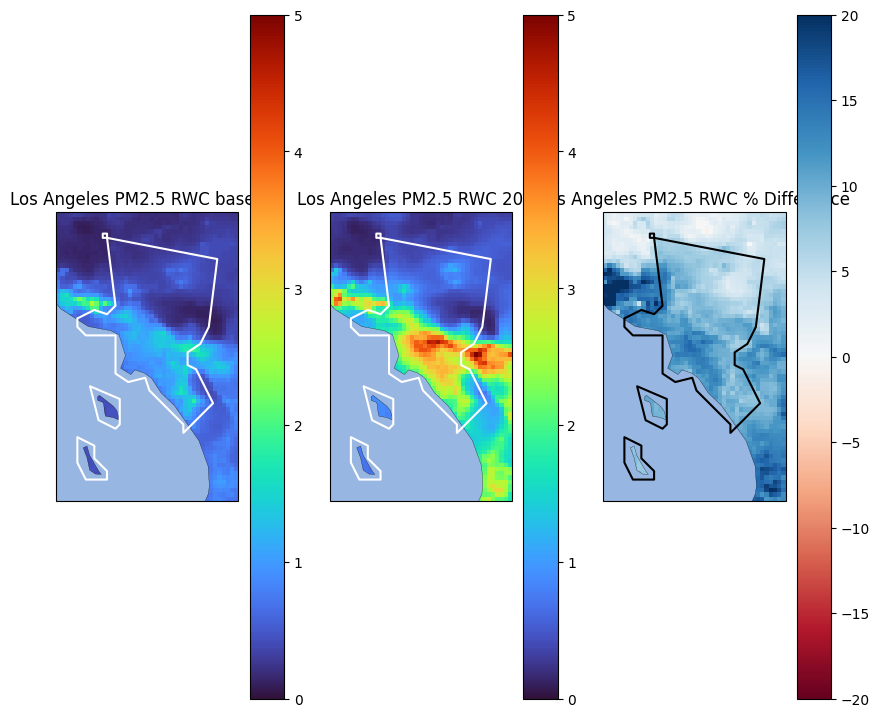

In [122]:
plot_multiple_MSA_RWC(
    df=pmgdf,
    validation_df=validation_baseline,
    MSA='Los Angeles-Long Beach-Anaheim, CA',
    #vs2=[-5, 5]
)

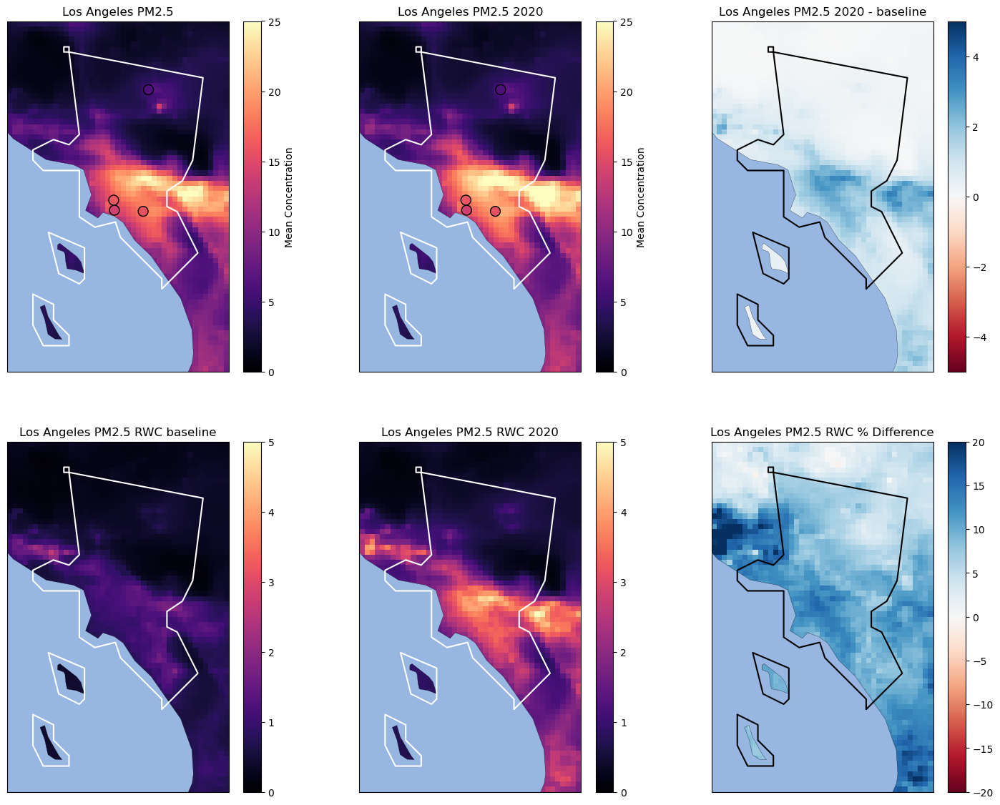

In [160]:
plot_multiple_MSA(
    df=pmgdf,
    validation_df=validation_baseline,
    MSA='Los Angeles-Long Beach-Anaheim, CA',
    vs1=[0, 25],
    vs2=[-5, 5]
)

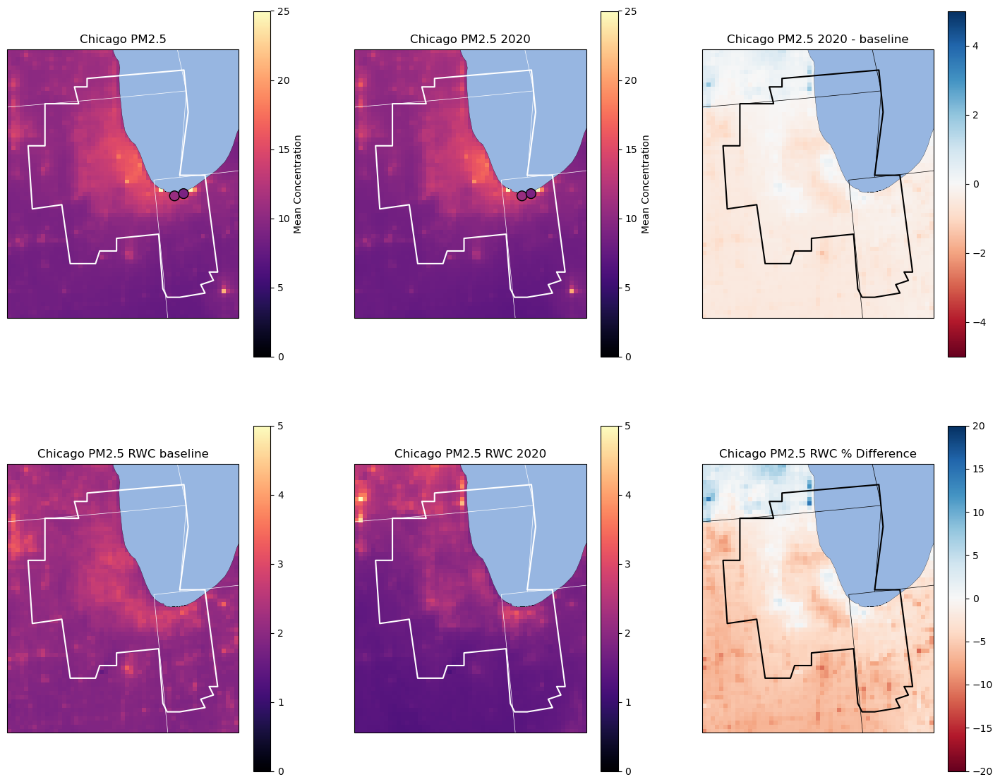

In [161]:

plot_multiple_MSA(
    df=pmgdf,
    validation_df=validation_baseline,
    MSA='Chicago-Naperville-Elgin, IL-IN-WI',
    vs1=[0, 25],
    vs2=[-5, 5]
)


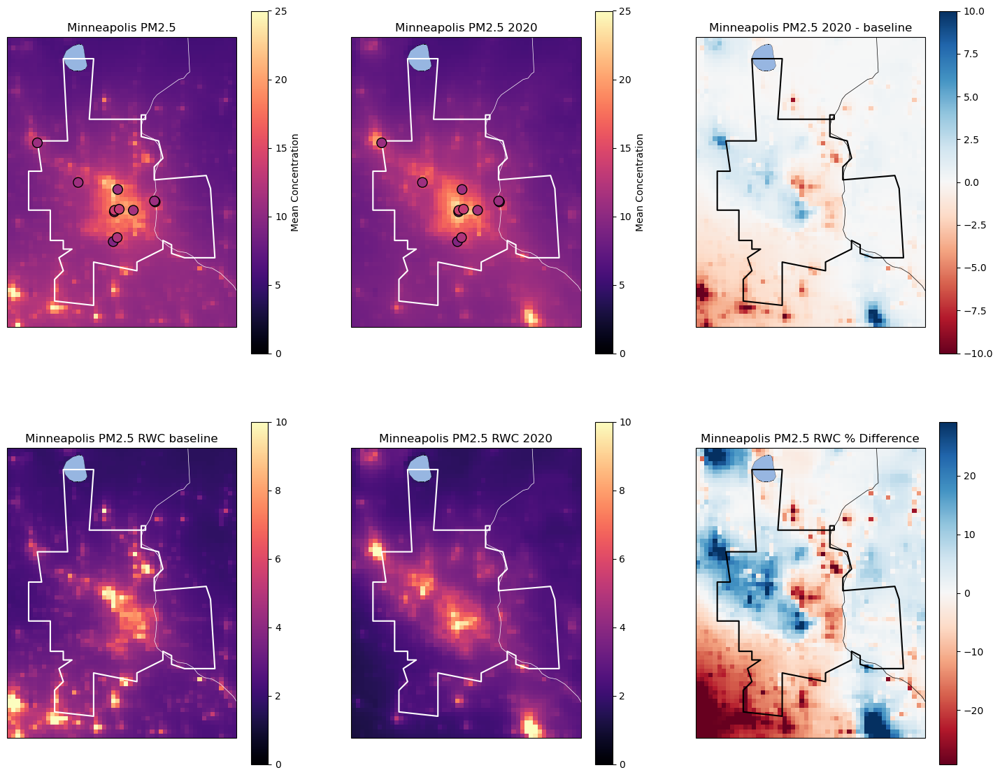

In [168]:

plot_multiple_MSA(
    df=pmgdf,
    validation_df=validation_baseline,
    MSA='Minneapolis-St. Paul-Bloomington, MN-WI',
    vs1=[0, 25],
    vs2=[-10, 10],
    vs3 = [0,10]
)

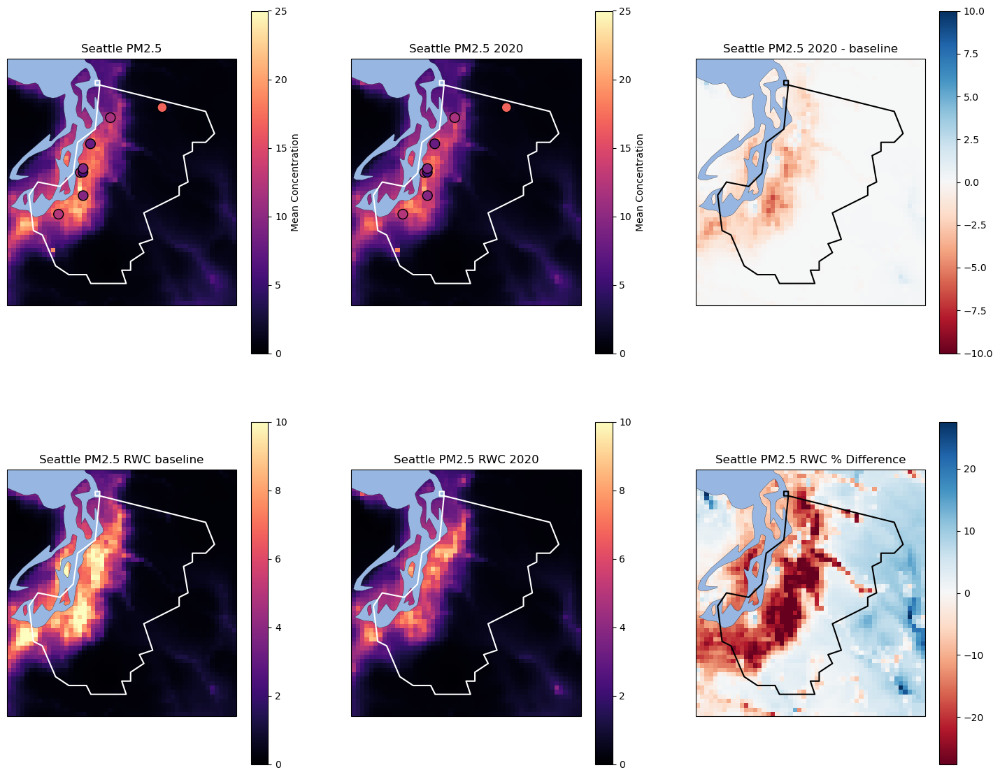

In [169]:
plot_multiple_MSA(
    df=pmgdf,
    validation_df=validation_baseline,
    MSA='Seattle-Tacoma-Bellevue, WA',
    vs1=[0, 25],
    vs2=[-10, 10],
    vs3 = [0, 10]
)

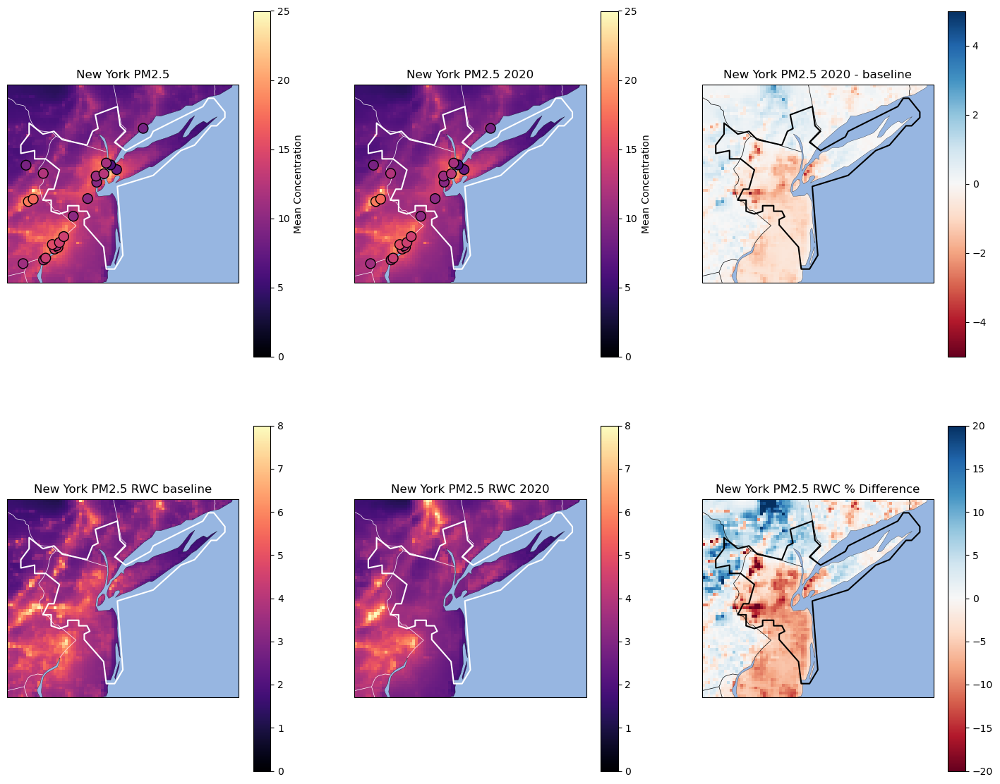

In [164]:
plot_multiple_MSA(
    df=pmgdf,
    validation_df=validation_baseline,
    MSA='New York-Newark-Jersey City, NY-NJ-PA',
    vs1=[0, 25],
    vs2=[-5, 5],
    vs3 = [0,8]
)

In [ ]:
plot_multiple_MSA(
    df=pmgdf,
    validation_df=validation_baseline,
    MSA='Houston-The Woodlands-Sugar Land, TX',
    vs1=[0, 25],
    vs2=[-5, 5]
)

In [ ]:
plot_multiple_MSA(
    df=pmgdf,
    validation_df=validation_baseline,
    MSA='Phoenix-Mesa-Chandler, AZ',
    vs1=[0, 25],
    vs2=[-5, 5]
)

In [ ]:
plot_multiple_MSA(
    df=pmgdf,
    validation_df=validation_baseline,
    MSA='Philadelphia-Camden-Wilmington, PA-NJ-DE-MD',
    vs1=[0, 25],
    vs2=[-5, 5]
)

In [ ]:

plot_multiple_MSA(
    df=pmgdf,
    validation_df=validation_baseline,
    MSA='Washington-Arlington-Alexandria, DC-VA-MD-WV',
    vs1=[0, 25],
    vs2=[-5, 5]
)

In [ ]:
plot_multiple_MSA(
    df=pmgdf,
    validation_df=validation_baseline,
    MSA='Atlanta-Sandy Springs-Alpharetta, GA',
    vs1=[0, 25],
    vs2=[-5, 5]
)

In [ ]:
plot_multiple_MSA(
    df=pmgdf,
    validation_df=validation_baseline,
    MSA='Denver-Aurora-Lakewood, CO',
    vs1=[0, 25],
    vs2=[-5, 5]
)

In [ ]:
plot_multiple_MSA(
    df=pmgdf,
    validation_df=validation_baseline,
    MSA='Salt Lake City, UT',
    vs1=[0, 25],
    vs2=[-5, 5]
)

In [ ]:

plot_multiple_MSA(
    df=pmgdf,
    validation_df=validation_baseline,
    MSA='Kansas City, MO-KS',
    vs1=[0, 25],
    vs2=[-5, 5]
)

In [ ]:

plot_multiple_MSA(
    df=pmgdf,
    validation_df=validation_baseline,
    MSA='St. Louis, MO-IL',
    vs1=[0, 25],
    vs2=[-5, 5]
)

In [ ]:

plot_multiple_MSA(
    df=pmgdf,
    validation_df=validation_baseline,
    MSA='Dallas-Fort Worth-Arlington, TX',
    vs1=[0, 25],
    vs2=[-5, 5]
)

## CONUS Plotting

In [ ]:
plot(data = baseline['PM25_TOT'][0,0,:,:],
     vs = [0,20],
     label =  "PM2.5 Concentrations (u/m^3)", 
     title = "January 2016 PM2.5 Concentrations",
     lon = lon,
     lat = lat
    )

In [ ]:
plot(data = rwc_2020['PM25_TOT'][0,0,:,:],
     vs = [0,20],
     label =  "PM2.5 Concentrations (u/m^3)", 
     title = "January 2016 PM2.5 Concentrations",
     lon = lon,
     lat = lat
    )

In [116]:
def plot(data, label, title, lat, lon, cbar="viridis", vs=False, counties=False, bounds=False, difference=False, state_color="white"):
    if not bounds:
        bounds = [[0, lat.shape[0]], [0, lon.shape[1]]]
    
    # Create a mask for areas outside the bounds and fill with zeros
    masked_data = np.zeros_like(data)
    masked_data[bounds[0][0]:bounds[0][1], bounds[1][0]:bounds[1][1]] = data[bounds[0][0]:bounds[0][1], bounds[1][0]:bounds[1][1]]

    # Create matplotlib figure
    plt.figure(figsize=(15, 8))

    # Create subplot with the Mollweide projection
    ax = plt.subplot(111, projection=ccrs.PlateCarree(central_longitude=-97.0, globe=None))

    # Create map
    if difference:
        mm = ax.pcolormesh(
            lon,
            lat,
            masked_data,
            transform=ccrs.PlateCarree(),
            cmap=cbar
        )
    else:
        mm = ax.pcolormesh(
            lon,
            lat,
            masked_data,
            transform=ccrs.PlateCarree(),
            cmap=cbar
        )
    
    # Map coastlines on the map with resolution 110m
    ax.coastlines(resolution='110m')
    
    colormap = plt.get_cmap(cbar)  # Use the provided colormap
    zero_color = colormap(0)  # Get the color at zero value (this is RGBA)

    # Generate features
    resol = '10m'  # use data at this scale
    bodr = cfeature.NaturalEarthFeature(category='cultural', edgecolor=state_color,
                                        name='admin_0_boundary_lines_land', scale=resol, facecolor='none', alpha=0.7)
    ocean = cfeature.NaturalEarthFeature('physical', 'ocean', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    lakes = cfeature.NaturalEarthFeature('physical', 'lakes', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    states_provinces = cfeature.NaturalEarthFeature(category='cultural', name='admin_1_states_provinces_lines',
                                                    scale='50m', edgecolor=state_color, facecolor='none')
    
    # Add features
    if counties:
        ax.add_feature(COUNTIES, facecolor='none', edgecolor=state_color)
    ax.add_feature(ocean, linewidth=0.2)
    ax.add_feature(states_provinces, edgecolor=state_color, linewidth=0.5)
    ax.add_feature(bodr, linestyle='--', edgecolor=state_color, alpha=1)
    
    if vs:
        mm.set_clim(vmin=vs[0], vmax=vs[1])
    else:
        mm.set_clim(vmin=np.quantile(data, 0.025), vmax=np.quantile(data, 0.975))

    # Plot colorbar legend
    cbar = plt.colorbar(mm, ax=ax, orientation='vertical', shrink=0.7, pad=0.02)  # Shrink adjusts the height

    # Get the color corresponding to zero from the colormap

    # Generate land feature with the zero color
    #land = cfeature.NaturalEarthFeature('physical', 'land', scale='10m', edgecolor='black', facecolor=zero_color)

    # Add the land feature to the bottom layer
    #ax.add_feature(land, zorder=-10)  # Use a negative zorder to ensure it's at the bottom
    
    cbar.outline.set_visible(True)  # Make colorbar outline visible
    cbar.ax.set_ylabel(label, rotation=90, fontsize=18,  labelpad=9)
    cbar.ax.tick_params(labelsize=18)

    ax.set_title(title, fontsize = 20)
    ax.set_extent([-127, -66.5, 25, 50.5], crs=ccrs.PlateCarree())

    # Remove the axis frame and borders
    ax.set_frame_on(False)
    ax.spines['geo'].set_visible(False)  # Hide geographic spines


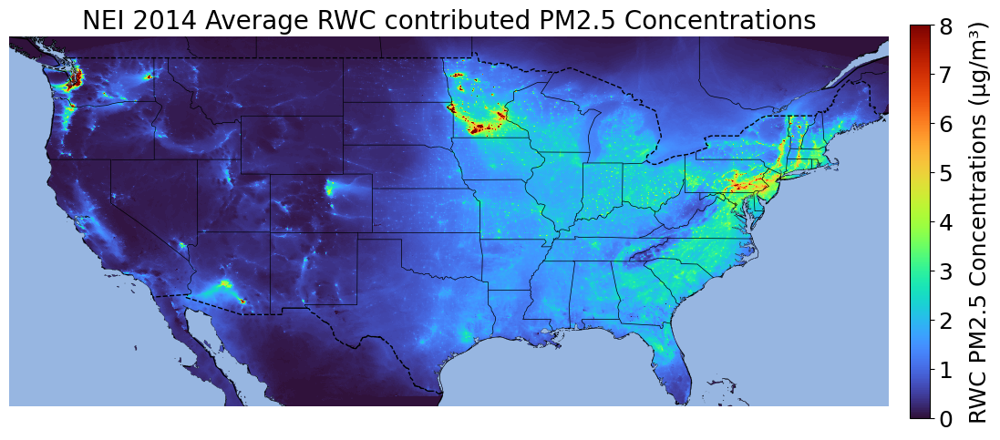

In [112]:
plot(data = baseline['PM25_TOT'][0,0,:,:] - no_rwc['PM25_TOT'][0,0,:,:],
     vs = [0,8],
     label =  "RWC PM2.5 Concentrations (µg/m³)", 
     title = "NEI 2014 Average RWC contributed PM2.5 Concentrations",
     lon = lon,
     lat = lat,
     cbar = "turbo",
     state_color = "black"
    )

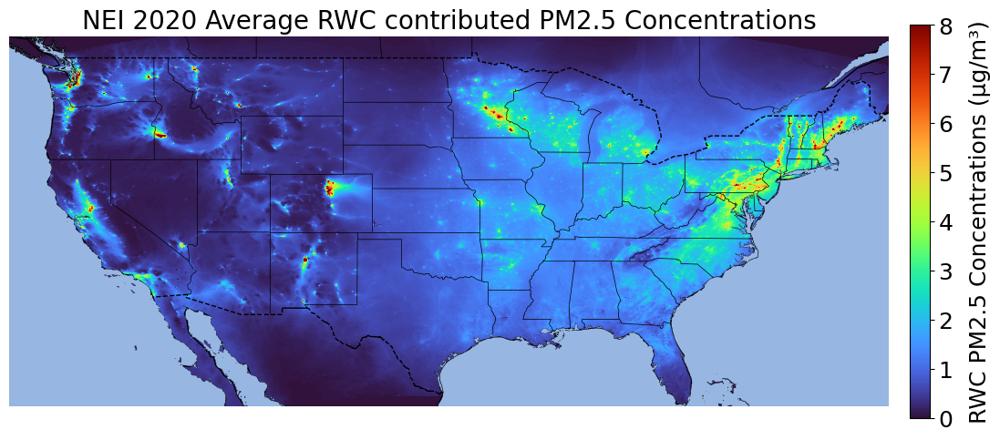

In [113]:
plot(data = rwc_2020['PM25_TOT'][0,0,:,:] - no_rwc['PM25_TOT'][0,0,:,:],
     vs = [0,8],
     label =  "RWC PM2.5 Concentrations (µg/m³)", 
     title = "NEI 2020 Average RWC contributed PM2.5 Concentrations",
     lon = lon,
     lat = lat,
     cbar = "turbo",
     state_color = "black"
    )

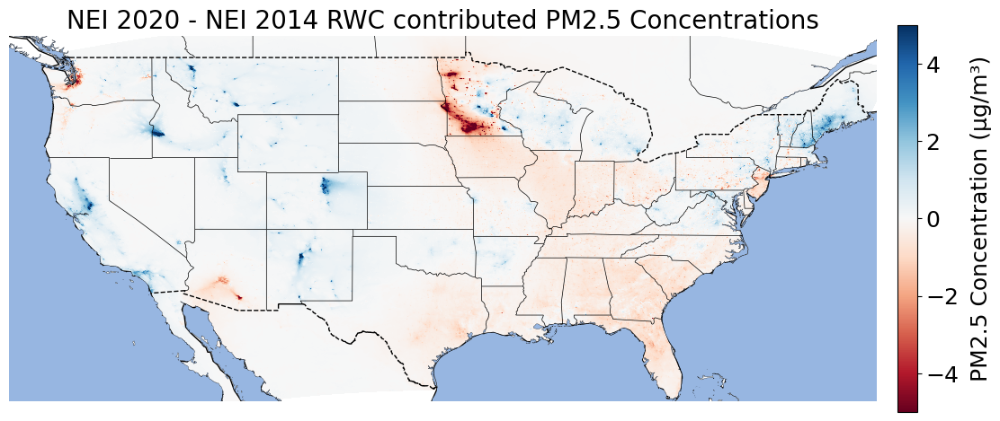

In [117]:
plot(data = rwc_2020['PM25_TOT'][0,0,:,:] - baseline['PM25_TOT'][0,0,:,:],
     vs = [-5,5],
     label =  "PM2.5 Concentration (µg/m³)", 
     title = "NEI 2020 - NEI 2014 RWC contributed PM2.5 Concentrations",
     lon = lon,
     lat = lat,
     difference = True,
     state_color = "black",
     cbar = 'RdBu'
    )

In [ ]:
plot(data = (rwc_2020['PM25_TOT'][0,0,:,:] - baseline['PM25_TOT'][0,0,:,:])/(baseline['PM25_TOT'][0,0,:,:] - no_rwc['PM25_TOT'][0,0,:,:]) * 100,
     vs = [-100,100],
     label =  "Percent Difference in RWC PM2.5 Concentrations", 
     title = "Percent Difference from 2020_RWC to Baseline January 2016 RWC Contributed PM2.5 Concentrations",
     lon = lon,
     lat = lat,
     difference = True,
    )

In [ ]:
plot(data = (rwc_2020['PM25_TOT'][0,0,:,:] - no_w- baseline['PM25_TOT'][0,0,:,:])/baseline['PM25_TOT'][0,0,:,:] * 100,
     vs = [-50,50],
     label =  "Percent Difference in PM2.5 Concentrations", 
     title = "Percent Difference from 2020_RWC to Baseline January 2016 PM2.5 Concentrations",
     lon = lon,
     lat = lat,
     difference = True,
    )

In [ ]:
rwc_2020['PM25_EC'][0,0,:,:].sum()

In [ ]:
rwc_2020['PM25_OC'][0,0,:,:].sum()

In [ ]:
rwc_2020['PM25_TOT'][0,0,:,:].sum()

In [ ]:
baseline['PM25_TOT'][0,0,:,:].sum()

## RWC City Plotting --> Comparisons to SA study Data

In [ ]:
# plot MSA data
def plot_MSA(df, MSA, title, col = "PM25",cmap = "viridis", vs = False, counties = False, difference = False,  state_color = "white" ):
    # Define the target projection
    target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))

    #create matplotlib figure
    fig, ax = plt.subplots(figsize=(12,7), subplot_kw={'projection': target_proj}) #subplot_kw={'projection': ccrs.PlateCarree(central_longitude=-97.0, globe=None)})

    # subselect df
    sub_df = df.loc[df["CBSA"] == MSA]
    
    if vs:
        vmin=vs[0]
        vmax=vs[1]
    else:
        vmin = np.quantile(sub_df[col], 0.025)
        vmax = np.quantile(sub_df[col], 0.975)

    #plot
    sub_df.plot(ax = ax, column = col, cmap=cmap, legend=True, vmin = vmin, vmax = vmax)


    #generate features
    resol = '10m'  # use data at this scale
    bodr = cfeature.NaturalEarthFeature(category='cultural',  edgecolor = 'black',name='admin_0_boundary_lines_land', scale=resol, facecolor='none', alpha=0.7)
    ocean = cfeature.NaturalEarthFeature('physical', 'ocean', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    lakes = cfeature.NaturalEarthFeature('physical', 'lakes', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    #rivers = cfeature.NaturalEarthFeature('physical', 'rivers_lake_centerlines', scale=resol, edgecolor='black', facecolor='none')
    states_provinces = cfeature.NaturalEarthFeature(category='cultural', name='admin_1_states_provinces_lines', scale='50m',edgecolor = state_color, facecolor='none')

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.set_xticks([])
    ax.set_yticks([])

    #add features
    if counties:
        ax.add_feature(COUNTIES, facecolor='none', edgecolor=state_color)
    #ax.add_feature(rivers, linewidth=0.5,edgecolor='blue')
    ax.add_feature(ocean, linewidth=0.2 )
    ax.add_feature(lakes, linewidth = 0)
    ax.add_feature(states_provinces, edgecolor=state_color, linewidth=0.5)
    ax.add_feature(bodr, linestyle='--', edgecolor=state_color, alpha=1)

    #plot colorbar legend
    #cbar = plt.colorbar(mm)
    #cbar.ax.set_ylabel(label,rotation = 90)

    ax.set_title(title)
    return sub_df

In [ ]:

la_df = plot_MSA(
    df = pmgdf,
    MSA = 'Los Angeles-Long Beach-Anaheim, CA',
    title = 'LA PM2.5 from RWC',
    cmap = "magma",
    vs = [0,5],
    counties = True,
    difference = False
)

plot_MSA(
    df = pmgdf,
    MSA = 'Los Angeles-Long Beach-Anaheim, CA',
    title = 'LA PM2.5 % from RWC',
    col = "PM25_percent",
    cmap = "magma",
    vs = [0,45],
    counties = True,
    difference = False
)

plot_MSA(
    df = pmgdf,
    MSA = 'Los Angeles-Long Beach-Anaheim, CA',
    title = 'LA PM2.5 % from RWC',
    col = "PM25_percent_2020",
    cmap = "magma",
    vs = [0,45],
    counties = True,
    difference = False
)

la_df['PM25_percent'].mean()

In [ ]:
# San Jose, USA 42% heatingseason PM10 (SA) – – Chow et al. (1995)
# https://trid.trb.org/View/425534

#very much underestimated here ~20%, but less understimated in the 2020 version :)

sf_df = plot_MSA(
    df = pmgdf,
    MSA = 'San Jose-Sunnyvale-Santa Clara, CA',
    title = 'San Jose PM2.5 from RWC',
    cmap = "magma",
    vs = [0,5],
    counties = True,
    difference = False
)

plot_MSA(
    df = pmgdf,
    MSA = 'San Jose-Sunnyvale-Santa Clara, CA',
    title = 'San Jose PM2.5 % from RWC',
    col = "PM25_percent",
    cmap = "magma",
    vs = [0,45],
    counties = True,
    difference = False
)

sf_df['PM25_percent'].mean()

In [ ]:
print(np.quantile(sf_df['PM25'], 0.9))
print(np.quantile(sf_df['PM25'], 1))
print(np.quantile(sf_df['PM25_percent'], 0.9))
print(np.quantile(sf_df['PM25_percent'], 1))

In [ ]:
chi_df = plot_MSA(
    df = pmgdf,
    MSA =  'Chicago-Naperville-Elgin, IL-IN-WI',
    title = 'Chicago PM2.5 from RWC',
    cmap = "magma",
    vs = [0,5],
    counties = True,
    difference = False
)

plot_MSA(
    df = pmgdf,
    MSA =  'Chicago-Naperville-Elgin, IL-IN-WI',
    title = 'Chicago PM2.5 % from RWC',
    col = "PM25_percent",
    cmap = "magma",
    vs = [0,45],
    counties = True,
    difference = False
)

chi_df['PM25_percent'].mean()

In [ ]:
pmgdf['CBSA'].unique()

In [ ]:
print(np.quantile(chi_df['PM25'], 0.8))
print(np.quantile(chi_df['PM25'], 1))
print(np.quantile(chi_df['PM25_percent'], 0.8))
print(np.quantile(chi_df['PM25_percent'], 1))

In [ ]:
# Atlanta, USA: 11% winter PM2.5 ––Polissar et al. (2001), Sarnat et al., 2008
#  https://www.ncbi.nlm.nih.gov/pmc/articles/PMC2290994/
atlanta_df = plot_MSA(
    df = pmgdf,
    MSA = 'Atlanta-Sandy Springs-Alpharetta, GA',
    title = 'Atlanta PM2.5 from RWC',
    cmap = "magma",
    vs = [0,3],
    counties = True,
    difference = False
)

plot_MSA(
    df = pmgdf,
    MSA = 'Atlanta-Sandy Springs-Alpharetta, GA',
    title = 'Atlanta PM2.5 from RWC',
    col = "PM25_percent",
    cmap = "magma",
    vs = [10,30],
    counties = True,
    difference = False
)

atlanta_df['PM25_percent'].mean()

In [ ]:
print(np.quantile(atlanta_df['PM25'], 0.9))
print(np.quantile(atlanta_df['PM25'], 1))
print(np.quantile(atlanta_df['PM25_percent'], 0.9))
print(np.quantile(atlanta_df['PM25_percent'], 1))

In [ ]:


burlington_df = plot_MSA(
    df = pmgdf,
    MSA = 'Burlington-South Burlington, VT',
    title = 'Burlington PM2.5 from RWC',
    cmap = "magma",
    vs = [0,10],
    counties = True,
    difference = False
)

burlington_df['PM25_percent'].mean()

In [ ]:
# Montana (5 communities), USA 55–77% heating-season PM2.5 (SA) 7–11 – Ward et al. (2010)
# measured in Libby Montana, the northwest corner city (the tiny spot)
# https://www.tandfonline.com/doi/pdf/10.3155/1047-3289.60.6.688

# Substantially increased Montana emissions in 2020 version would improve on this

plot(data = baseline['PM25_TOT'][0,0,:,:] - no_rwc['PM25_TOT'][0,0,:,:],
     vs = [0,3],
     label =  "RWC PM2.5 Contribution (u/m^3)", 
     title = "Montana January 2016 RWC contributed PM2.5 Concentrations",
     lon = lon,
     lat = lat,
     cbar = "magma",
     counties = False,
     bounds = [ [660,666], [227,233] ]
    )

plot(data = percent_RWC,
     vs = [0,50],
     label =  "RWC PM2.5 Contribution (%)", 
     title = "Montana % January 2016 RWC contributed PM2.5 Concentrations",
     lon = lon,
     lat = lat,
     cbar = "magma",
     counties = False,
     bounds = [ [660,666], [227,233] ]
    )
print(f"Bounds Max: {int(percent_RWC[662:665,229:231].max())}")
print(f"Bounds Max: {int(percent_RWC[662:665,229:231].mean())}")

In [ ]:
# Seattle: 11 ug/m3, ~30% in heating season Allen et al. (2008), Kim & Hopke 2008, Wu et al. (2007)
# This actually matches up very well

seattle_df = plot_MSA(
    df = pmgdf,
    MSA = 'Seattle-Tacoma-Bellevue, WA',
    title = 'Seattle PM2.5 from RWC',
    cmap = "magma",
    vs = [0,15],
    counties = True,
    difference = False
)

plot_MSA(
    df = pmgdf,
    MSA = 'Seattle-Tacoma-Bellevue, WA',
    title = 'Seattle PM2.5 % from RWC',
    col = "PM25_percent",
    cmap = "magma",
    vs = [0,80],
    counties = True,
    difference = False
)

seattle_df['PM25_percent'].mean()

In [ ]:
print(np.quantile(seattle_df['PM25_percent'], 0.7))
print(np.quantile(seattle_df['PM25_percent'], 1))

In [ ]:
print(np.quantile(seattle_df['PM25'], 0.85))
print(np.quantile(seattle_df['PM25'], 1))

In [ ]:
# Portlan: ~27% in heating season Kim & Hopke 2008
# This  matches up pretty well
portland_df = plot_MSA(
    df = pmgdf,
    MSA = 'Portland-Vancouver-Hillsboro, OR-WA',
    title = 'Portland PM2.5 from RWC',
    cmap = "magma",
    vs = [0,15],
    counties = True,
    difference = False
)

plot_MSA(
    df = pmgdf,
    MSA = 'Portland-Vancouver-Hillsboro, OR-WA',
    title = 'Portland PM2.5 % from RWC',
    col = "PM25_percent",
    cmap = "magma",
    vs = [0,80],
    counties = True,
    difference = False
)

portland_df['PM25_percent'].mean()

In [ ]:
print(np.quantile(portland_df['PM25'], 0.95))
print(np.quantile(portland_df['PM25'], 1))
print(np.quantile(portland_df['PM25_percent'], 0.75))
print(np.quantile(portland_df['PM25_percent'], 0.95))

In [ ]:
#Las Vegas 11–21% annual PM2.5 (SA) – Individual sites: 11.3 ±9.8%, 15.9 ±12.9%, 11.1 ±8.0, 20.8 ±12.5% contributions to annual PM2.5
# OC: 8–16% contribution from residential wood combustion; EC: 3–7% contribution from residential wood combustion Green et al. (2013)"""

LV_df = plot_MSA(
    df = pmgdf,
    MSA = 'Las Vegas-Henderson-Paradise, NV',
    title = 'Las Vegas PM2.5 from RWC',
    cmap = "magma",
    vs = [0,5],
    counties = True,
    difference = False
)

plot_MSA(
    df = pmgdf,
    MSA = 'Las Vegas-Henderson-Paradise, NV',
    title = 'Las Vegas PM2.5 % from RWC',
    col = "PM25_percent",
    cmap = "magma",
    vs = [0,30],
    counties = True,
    difference = False
)

LV_df['PM25_percent'].mean()

In [ ]:
print(np.quantile(LV_df['PM25_percent'], 0.2))
print(np.quantile(LV_df['PM25_percent'], 0.9))

In [ ]:
print(np.quantile(LV_df['PM25'], 0.96))
print(np.quantile(LV_df['PM25'], 1))

In [ ]:
# San Joaquin Valley 24% winter PM2.5 https://pubmed.ncbi.nlm.nih.gov/17533844/
# 2014 RWC underesimates this, but it would do a little better in the 2020 version

plot(data = baseline['PM25_TOT'][0,0,:,:] - no_rwc['PM25_TOT'][0,0,:,:],
     vs = [0,4],
     label =  "RWC PM2.5 Concentrations (u/m^3)", 
     title = "San Joaquin Valley January 2016 RWC contributed PM2.5 Concentrations",
     lon = lon,
     lat = lat,
     cbar = "magma",
     counties = True,
     bounds = [ [300,440], [30,100] ]
    )

plot(data = 100*(baseline['PM25_TOT'][0,0,:,:] - no_rwc['PM25_TOT'][0,0,:,:])/baseline['PM25_TOT'][0,0,:,:],
     vs = [0,25],
     label =  "RWC PM2.5 Contribution (%)", 
     title = "San Joaquin Valley % January 2016 RWC contributed PM2.5 Concentrations",
     lon = lon,
     lat = lat,
     cbar = "magma",
     counties = True,
     bounds = [ [300,440], [30,100] ]
    )

# print(f"Bounds Mean: {int(percent_RWC[300:340,150:190].mean())}")

In [ ]:
# Truckee, USA 11–15% winter PM2.5 (SA) – – Chen et al. (2012) 
# Truckee has nothing on the map from RWC for 2014 but much more for 2020 RWC.

truckee_df = plot_MSA(
    df = pmgdf,
    MSA = 'Truckee-Grass Valley, CA',
    title = 'Truckee PM2.5 from RWC',
    cmap = "magma",
    vs = [0,2],
    counties = True,
    difference = False
)

plot_MSA(
    df = pmgdf,
    MSA = 'Truckee-Grass Valley, CA',
    title = 'Truckee PM2.5 % from RWC',
    col = "PM25_percent",
    cmap = "magma",
    vs = [0,50],
    counties = True,
    difference = False
)


In [ ]:
print(np.quantile(truckee_df['PM25_percent'], 0.2))
print(np.quantile(truckee_df['PM25_percent'], 0.95))

In [ ]:
# Rochester, New York, USA 17% winter PM2.5 (SA) 3.2 ug/m3 
# Wood smoke contribution to PM2.5 increased to 27% when the corresponding hourly PM2.5 concentrations were greater than 15 μg/m3 
# Wang et al. (2011)

# measures about 3.8 ug/m3 but more like 20-25% winter pm25
rochester_df = plot_MSA(
    df = pmgdf,
    MSA = 'Rochester, NY',
    title = 'Rochester PM2.5 from RWC',
    cmap = "magma",
    vs = [0,5],
    counties = True,
    difference = False
)

plot_MSA(
    df = pmgdf,
    MSA = 'Rochester, NY',
    title = 'Rochester PM2.5 % from RWC',
    col = "PM25_percent",
    cmap = "magma",
    vs = [0,50],
    counties = True,
    difference = False
)

print(rochester_df["PM25"].mean())

In [ ]:
print(np.quantile(rochester_df['PM25_percent'], 0.2))
print(np.quantile(rochester_df['PM25_percent'], 0.9))

print('\n',np.quantile(rochester_df['PM25'], 0.75))
print(np.quantile(rochester_df['PM25'], 0.975))
print(np.quantile(rochester_df['PM25'], 1))

In [ ]:
pmgdf['CBSA'].unique()

In [ ]:

mn_df = plot_MSA(
    df = pmgdf,
    MSA = 'Minneapolis-St. Paul-Bloomington, MN-WI',
    title = 'Minneapolis PM2.5 from RWC',
    cmap = "magma",
    vs = [0,12],
    counties = True,
    difference = False
)

plot_MSA(
    df = pmgdf,
    MSA = 'Minneapolis-St. Paul-Bloomington, MN-WI',
    title = 'Minneapolis PM2.5 % from RWC',
    col = "PM25_percent",
    cmap = "magma",
    vs = [0,80],
    counties = True,
    difference = False
)

mn_df['PM25_percent'].mean()

In [ ]:
print(np.quantile(mn_df['PM25'], 0.975))
print(np.quantile(mn_df['PM25'], 1))

In [ ]:
phil_df = plot_MSA(
    df = pmgdf,
    MSA =  'Philadelphia-Camden-Wilmington, PA-NJ-DE-MD',
    title = 'Philadelphia PM2.5 from RWC',
    cmap = "magma",
    vs = [0,7],
    counties = True,
    difference = False
)

plot_MSA(
    df = pmgdf,
    MSA =  'Philadelphia-Camden-Wilmington, PA-NJ-DE-MD',
    title = 'Philadelphia PM2.5 % from RWC',
    col = "PM25_percent",
    cmap = "magma",
    vs = [0,50],
    counties = True,
    difference = False
)

phil_df['PM25_percent'].mean()

In [ ]:

nyc_df = plot_MSA(
    df = pmgdf,
    MSA =  'New York-Newark-Jersey City, NY-NJ-PA',
    title = 'NYC PM2.5 from RWC',
    cmap = "magma",
    vs = [0,7],
    counties = True,
    difference = False
)

plot_MSA(
    df = pmgdf,
    MSA =  'New York-Newark-Jersey City, NY-NJ-PA',
    title = 'NYC PM2.5 % from RWC',
    col = "PM25_percent",
    cmap = "magma",
    vs = [0,50],
    counties = True,
    difference = False
)

nyc_df['PM25_percent'].mean()

In [ ]:
print(np.quantile(mn_df['PM25'], 0.7))
print(np.quantile(mn_df['PM25'], 0.96))

In [ ]:
print(np.quantile(mn_df['PM25_percent'], 0.01))
print(np.quantile(mn_df['PM25_percent'], 0.9))

In [ ]:

phoenix_df = plot_MSA(
    df = pmgdf,
    MSA =  'Phoenix-Mesa-Chandler, AZ',
    title = 'Phoenix PM2.5 from RWC',
    cmap = "magma",
    vs = [0,7],
    counties = True,
    difference = False
)

plot_MSA(
    df = pmgdf,
    MSA =  'Phoenix-Mesa-Chandler, AZ',
    title = 'Phoenix PM2.5 % from RWC',
    col = "PM25_percent",
    cmap = "magma",
    vs = [0,50],
    counties = True,
    difference = False
)

phoenix_df['PM25_percent'].mean()

In [ ]:
print(np.quantile(mn_df['PM25'], 0.7))
print(np.quantile(mn_df['PM25'], 0.96))

# Population weighting

In [24]:
# Read the .txt file into a pandas DataFrame
population_df = pd.read_csv("../SMOKE_sensitivity_analyses/population.txt", delimiter='\t', header=None, skiprows=25)

# Specify coordinates to align population and emission data
population_df = population_df.rename(columns = {2:"COLS", 3:"ROWS"})
population_df["COLS"] -= 111 
population_df["ROWS"] -= 126   

In [25]:
len(population_df['COLS'].unique())

1151

In [26]:
len(pmgdf['col'].unique())

1155

In [8]:
pm_df = baseline['PM25_TOT'][0,0,:,:].to_dataframe()
pm_df['PM25_2020'] = (rwc_2020['PM25_TOT'][0,0,:,:]).to_dataframe()
pm_df['PM25_diff'] = (rwc_2020['PM25_TOT'][0,0,:,:] - baseline['PM25_TOT'][0,0,:,:]).to_dataframe()

pm_df['PM25_RWC'] = (baseline['PM25_TOT'][0,0,:,:] - no_rwc['PM25_TOT'][0,0,:,:]).to_dataframe()
pm_df['PM25_RWC_2020'] = (rwc_2020['PM25_TOT'][0,0,:,:] - no_rwc['PM25_TOT'][0,0,:,:]).to_dataframe()

pm_df['PM25_RWC_percent'] =(100* (baseline['PM25_TOT'][0,0,:,:] - no_rwc['PM25_TOT'][0,0,:,:])/baseline['PM25_TOT'][0,0,:,:]).to_dataframe()
pm_df['PM25_RWC_percent_2020'] = (percent_RWC_2020).to_dataframe()

pm_df['RWC_percent_diff'] = (pm_df['PM25_RWC_2020'] - pm_df['PM25_RWC'])/ pm_df['PM25_TOT'] * 100 
pm_df = pm_df.reset_index()

In [9]:
PWC_df = pd.merge(pm_df, population_df, left_on=['ROW', 'COL'], right_on=['ROWS', 'COLS'])
PWC_df['population'] = PWC_df[6]

PWC_df['PWC_TOT'] = PWC_df['PM25_TOT'] * PWC_df['population']
PWC_df['PWC_RWC'] = PWC_df['PM25_RWC'] * PWC_df['population']
PWC_df['PWC_TOT_2020'] = PWC_df['PM25_2020'] * PWC_df['population']
PWC_df['PWC_RWC_2020'] = PWC_df['PM25_RWC_2020'] * PWC_df['population']


total_PWC = PWC_df['PWC_TOT'].sum()
RWC_PWC = PWC_df['PWC_RWC'].sum()

total_PWC_2020 = PWC_df['PWC_TOT_2020'].sum()
RWC_PWC_2020 = PWC_df['PWC_RWC_2020'].sum()

In [11]:
print(f"Percent of PWC from RWC: {round(RWC_PWC/total_PWC * 100,3)}%")

Percent of PWC from RWC: 21.395%


In [12]:
print(f"population weighted mean concentration {round(RWC_PWC/PWC_df['population'].sum(), 2)} ug/m^3") 
#population weighted mean concentration

population weighted mean concentration 2.36 ug/m^3


In [13]:
print(f"population weighted mean concentration 2020 {round(RWC_PWC_2020/PWC_df['population'].sum(), 2)} ug/m^3") 

population weighted mean concentration 2020 2.43 ug/m^3


In [14]:
print(f"Percent of PWC from RWC 2020: {round(PWC_df['PWC_RWC_2020'].sum()/total_PWC_2020 * 100,3)}%")

Percent of PWC from RWC 2020: 21.923%


In [15]:
print(f"mean concentration {str(round(PWC_df['PM25_RWC'].mean(), 2))} ug/m^3") 

mean concentration 1.12 ug/m^3


In [16]:
print(f"mean concentration {str(round(PWC_df['PM25_RWC_2020'].mean(), 2))} ug/m^3") 

mean concentration 1.08 ug/m^3


In [17]:
100 * np.mean(PWC_df['PM25_RWC'] / PWC_df['PM25_TOT'])

19.65566575527191

In [19]:
100 * np.mean(PWC_df['PM25_RWC_2020'] / PWC_df['PM25_2020'])

21.38587385416031

In [21]:
PWC_df.shape

(583666, 24)

In [24]:
pm_df.loc[pm_df['PM25_TOT'] == pm_df['PM25_TOT'].max()] #southwestern Kansas

,ROW,COL,PM25_TOT,PM25_2020,PM25_diff,PM25_RWC,PM25_RWC_2020,PM25_RWC_percent,PM25_RWC_percent_2020,RWC_percent_diff
379306,328,466,369.856293,371.910553,2.05426,2.358154,4.412415,0.637587,1.186418,0.555421


In [25]:
pm_df.loc[pm_df['PM25_2020'] == pm_df['PM25_2020'].max()]

,ROW,COL,PM25_TOT,PM25_2020,PM25_diff,PM25_RWC,PM25_RWC_2020,PM25_RWC_percent,PM25_RWC_percent_2020,RWC_percent_diff
379306,328,466,369.856293,371.910553,2.05426,2.358154,4.412415,0.637587,1.186418,0.555421


In [34]:
from pyproj import Proj, Transformer

# Grid indices (row 328, column 466)
row, col = 328, 466
xorig = -2292000
yorig = -1584000

# Calculate the center of the grid cell in the projection coordinates
x_center = xorig + (col) * cell_size
y_center = yorig + (row) * cell_size

# Set up a transformer to convert from LCC to latitude/longitude (WGS84)
transformer = Transformer.from_crs(proj_params, "EPSG:4326", always_xy=True)

# Transform to latitude and longitude
lon, lat = transformer.transform(x_center, y_center)

# Print the results
print(f"Latitude: {lat}, Longitude: {lon}")

Latitude: 37.432839063454615, Longitude: -101.86277724833853


In [27]:
pm_df.loc[pm_df['PM25_TOT'] == pm_df['PM25_TOT'].min()] #southwestern Kansas

,ROW,COL,PM25_TOT,PM25_2020,PM25_diff,PM25_RWC,PM25_RWC_2020,PM25_RWC_percent,PM25_RWC_percent_2020,RWC_percent_diff
750856,650,106,0.121552,0.125044,0.003493,0.022602,0.026094,18.594172,20.86796,2.873412


In [28]:
pm_df.loc[pm_df['PM25_2020'] == pm_df['PM25_2020'].min()]

,ROW,COL,PM25_TOT,PM25_2020,PM25_diff,PM25_RWC,PM25_RWC_2020,PM25_RWC_percent,PM25_RWC_percent_2020,RWC_percent_diff
750856,650,106,0.121552,0.125044,0.003493,0.022602,0.026094,18.594172,20.86796,2.873412


In [30]:
from pyproj import Proj, Transformer

# Grid indices (row 328, column 466)
row, col = 650, 106

# Calculate the center of the grid cell in the projection coordinates
x_center = xorig + (col) * cell_size
y_center = yorig + (row) * cell_size

# Set up a transformer to convert from LCC to latitude/longitude (WGS84)
transformer = Transformer.from_crs(proj_params, "EPSG:4326", always_xy=True)

# Transform to latitude and longitude
lon, lat = transformer.transform(x_center, y_center)

# Print the results
print(f"Latitude: {lat}, Longitude: {lon}")

Latitude: 46.858764460607055, Longitude: -121.69930821555799


In [32]:
pm_df.loc[pm_df['PM25_RWC'] == pm_df['PM25_RWC'].max()] #southwestern Kansas

,ROW,COL,PM25_TOT,PM25_2020,PM25_diff,PM25_RWC,PM25_RWC_2020,PM25_RWC_percent,PM25_RWC_percent_2020,RWC_percent_diff
581575,503,610,125.801689,7.588713,-118.212975,119.266838,1.053861,94.805435,13.887212,-93.96772


In [35]:
x_center = xorig + (610) * cell_size
y_center = yorig + (503) * cell_size
lon, lat = transformer.transform(x_center, y_center)
print(f"Latitude: {lat}, Longitude: {lon}")

Latitude: 43.85536451171422, Longitude: -95.15552365636722


In [33]:
pm_df.loc[pm_df['PM25_RWC_2020'] == pm_df['PM25_RWC_2020'].max()]

,ROW,COL,PM25_TOT,PM25_2020,PM25_diff,PM25_RWC,PM25_RWC_2020,PM25_RWC_percent,PM25_RWC_percent_2020,RWC_percent_diff
620417,537,182,16.939304,43.375988,26.436684,3.708152,30.144836,21.890816,69.496597,156.067123


In [36]:
x_center = xorig + (182) * cell_size
y_center = yorig + (537) * cell_size
lon, lat = transformer.transform(x_center, y_center)
print(f"Latitude: {lat}, Longitude: {lon}")

Latitude: 43.571725695939584, Longitude: -116.55722245382394


# Population Characteristics

## Backend to generate pm25 per census tract

In [ ]:
import pandas as pd
census_tract_df = pd.read_csv('census_tract_race.csv', header = 0, encoding='latin1')
census_tract_df.drop(['YEAR',
                      'COUSUBA',
                      'PLACEA',
                      'BLKGRPA',
                      'CONCITA',
                      'AIANHHA',
                      'RES_ONLYA',
                      'TRUSTA',
                      'AIHHTLI',
                      'ANRCA',
                      'NECTAA',
                      'CNECTAA',
                      'NECTADIVA',
                      'CDCURRA',
                    'SLDUA',
                    'SLDLA',
                    'ZCTA5A',
                    'SUBMCDA',
                    'SDELMA',
                    'SDSECA',
                    'SDUNIA',
                    'PCI',
                    'PUMAA',
                    'BTBGA'], axis=1, inplace=True)

In [ ]:
census_tract_df[['GISJOIN', 'STUSAB', 'REGIONA', 'DIVISIONA', 'STATE', 'STATEA',
       'COUNTY', 'COUNTYA', 'TRACTA', 'AITSCEA', 'CBSAA', 'CSAA', 'METDIVA',
       'UAA', 'GEOID', 'BTTRA']]

In [ ]:
import geopandas as gpd
gdf = gpd.read_file("../SMOKE_sensitivity_analyses/US_census_shapefiles/US_tract_2018.shp")

In [ ]:
import geopandas as gpd
from shapely.geometry import Polygon
import numpy as np

# Projection parameters
proj_params = {'proj': 'lcc',
               'lat_1': 33,
               'lat_2': 45,
               'lon_0': -97,
               'lat_0': 40}

# Coordinates of the origin
xorig = -2292000
yorig = -1584000

# Number of grid cells in x and y directions
num_cells_x = 1155
num_cells_y = 726

# Size of each grid cell (in meters)
cell_size = 4000  # 4km

# Generate grid coordinates using NumPy
x_coords = np.linspace(xorig, xorig + cell_size * num_cells_x, num_cells_x + 1)
y_coords = np.linspace(yorig, yorig + cell_size * num_cells_y, num_cells_y + 1)

# Create vertices for all grid cells using NumPy
x1, y1 = np.meshgrid(x_coords[:-1], y_coords[:-1])
x2, y2 = np.meshgrid(x_coords[1:], y_coords[:-1])
x3, y3 = np.meshgrid(x_coords[1:], y_coords[1:])
x4, y4 = np.meshgrid(x_coords[:-1], y_coords[1:])

# Reshape to 1D arrays
x1, x2, x3, x4 = x1.ravel(), x2.ravel(), x3.ravel(), x4.ravel()
y1, y2, y3, y4 = y1.ravel(), y2.ravel(), y3.ravel(), y4.ravel()

# Create GeoDataFrame with polygons
polygons = [Polygon([(x1[i], y1[i]), (x2[i], y2[i]), (x3[i], y3[i]), (x4[i], y4[i])]) for i in range(len(x1))]
grid_gdf = gpd.GeoDataFrame(geometry=polygons, crs=proj_params)

In [ ]:
census_tract_gdf = gdf.merge(census_tract_df, how='left', 
                       left_on='GISJOIN', right_on='GISJOIN')
census_tract_gdf = census_tract_gdf.rename(columns={
           "ALUKE001":    "Total",
           "ALUKE003":    "White alone",
           "ALUKE004":    "Black or African American alone",
           "ALUKE005":    "American Indian and Alaska Native alone",
           "ALUKE006":    "Asian alone",
           "ALUKE007":    "Native Hawaiian and Other Pacific Islander alone",
           "ALUKE008":    "Some Other Race alone",
           "ALUKE009":    "Two or More Races",
           "ALUKE010":    "Two or More Races: Two races including Some Other Race",
           "ALUKE011":    "Two or More Races: Two races excluding Some Other Race, and three or more races",
           'ALUKE012': 'Hispanic or Latino',
           'ALUKE013': 'Hispanic or Latino: White alone',
           'ALUKE014': 'Hispanic or Latino: Black or African American alone',
           'ALUKE015': 'Hispanic or Latino: American Indian and Alaska Native alone',
           'ALUKE016': 'Hispanic or Latino: Asian alone',
           'ALUKE017': 'Hispanic or Latino: Native Hawaiian and Other Pacific Islander alone',
           'ALUKE018': 'Hispanic or Latino: Some other race alone',
           'ALUKE019': 'Hispanic or Latino: Two or more races',
           'ALUKE020': 'Hispanic or Latino: Two or more races: Two races including Some other race',
           'ALUKE021': 'Hispanic or Latino: Two or more races: Two races excluding Some other race, and three or more races'
                   })

# Projection parameters
proj_params = {'proj': 'lcc',
               'lat_1': 33,
               'lat_2': 45,
               'lon_0': -97,
               'lat_0': 40}

census_tract_gdf = census_tract_gdf.to_crs(proj_params) # convert to the same SMOKE CRS projection 

In [ ]:
var = 'PM25_TOT'
RWC_var = (baseline[var] - no_rwc[var])[0,0,:,:].to_numpy().ravel()
grid_gdf["RWC_"+var] = RWC_var
grid_gdf = grid_gdf.reset_index().rename(columns={'index': 'iD'})

In [ ]:
grid_gdf = grid_gdf.rename(columns = {"RWC_PM25_TOT":"PM25_conc"})

In [ ]:
# # Create intersections shapefile
grid_gdf = grid_gdf.reset_index().rename(columns={'index': 'iD'})
merged_shapes = merged_gdf[['GISJOIN','geometry']]
intersection = gpd.overlay(grid_gdf, merged_shapes, how='intersection')
intersection.to_file("intersection.shp")

1) merge together
2) get the fraction of each census tract made up of each intersection
3) Sum the concentration * the fraction of the area to get a total averaged concentration
4) Save the geodataframe

In [ ]:
import geopandas as gpd
intersectin = gpd.read_file('intersection_pm25/intersection.shp')

In [ ]:
# intersectin = intersectin.merge(grid_gdf[['iD', 'PM25_conc']], on='iD')
# # merge on GISJOIN
# intersectin = intersectin.merge(census_tract_df[['GISJOIN', 'STUSAB', 'REGIONA', 'DIVISIONA', 'STATE', 'STATEA',
#        'COUNTY', 'COUNTYA', 'TRACTA', 'AITSCEA', 'CBSAA', 'CSAA', 'METDIVA',
#        'UAA', 'GEOID', 'BTTRA']], on='GISJOIN')
# intersectin = intersectin.drop('RWC_PM25_T', axis = 1)
# intersectin.to_pickle("grid_intersections.pkl")

In [ ]:
from shapely.geometry import Polygon

# Assuming df is your DataFrame with a column of polygons
# Assuming the polygon column is named 'geometry'

# Define a function to calculate the area of a polygon
def calculate_polygon_area(polygon):
    return polygon.area

# Apply the function to calculate the area for each polygon
intersectin['census_tract_area'] = intersectin['geometry_y'].apply(calculate_polygon_area)
intersectin['intersection_area'] = intersectin['geometry_x'].apply(calculate_polygon_area)
intersectin['area_fraction'] = intersectin['intersection_area']/intersectin['census_tract_area']

In [ ]:
# concentration * fraction column
# sum concentration fractions and save
intersectin['concentration_fraction'] = intersectin['RWC_PM25_TOT'] * intersectin['area_fraction']

In [ ]:
summed_df = intersectin.groupby('GISJOIN')["concentration_fraction"].sum().reset_index()

In [ ]:
census_tract_gdf = census_tract_gdf.merge(summed_df, on='GISJOIN')
census_tract_gdf['concentration_fraction'].mean()

In [ ]:
census_tract_gdf.to_file("2016_rwc_census_tract_pm25.shp")

## Population Data Science

### Mortality Calculations

#### Import Census Tract Data and Add CBSA

In [11]:
import pandas as pd
EJ_index = pd.read_csv('EJ_index.csv')

In [12]:
import geopandas as gpd
def import_rwc_shapefile(loc = 'census_tract_data/2016_rwc_census_tract_pm25.shp'):
    rwc_census_tract_baseline = gpd.read_file(loc)
    rwc_census_tract_baseline = rwc_census_tract_baseline.rename(columns={
               "White alon":    "White",
               "Black or A":    "Black",
               "American I":    "American Indian",
               "Asian alon":    "Asian",
               "Native Haw":    "Native Hawaiian or Pacific Islander",
               'Some Other': 'Other', 
               'Two or Mor': 'Two or More Races',
               'Hispanic o': 'Hispanic'
                       })
    
    rwc_census_tract_baseline['GEOID_x'] = rwc_census_tract_baseline['GEOID_x'].astype(int)
    rwc_census_tract_baseline = rwc_census_tract_baseline.merge(EJ_index[['GEOID', 'SPL_EJI']], left_on='GEOID_x', right_on='GEOID', how='left')
    rwc_census_tract_baseline['COUNTYFP'] = rwc_census_tract_baseline['COUNTYFP'].astype(int)
    rwc_census_tract_baseline['STATEFP'] = rwc_census_tract_baseline['STATEFP'].astype(float)
    return rwc_census_tract_baseline

In [13]:
rwc_census_tract_2020 = import_rwc_shapefile(loc = 'census_tract_data/2020_rwc_census_tract_pm25.shp')
#rwc_census_tract_baseline = import_rwc_shapefile(loc = 'census_tract_data/2016_rwc_census_tract_pm25.shp')

In [14]:
# MSA data
cbsa = gpd.read_file('cbsa/tl_2019_us_cbsa.shp', engine="pyogrio")

# Convert the GeoDataFrame to the target CRS
cbsa = cbsa.to_crs(rwc_census_tract_2020.crs)
cbsa['CBSA'] = cbsa['NAME']

In [17]:
def add_CBSA(rwc_census_tract_baseline, cbsa):
    # Convert centroid to GeoDataFrame to use in spatial join
    rwc_census_tract_baseline = rwc_census_tract_baseline.copy(deep = True)
    rwc_census_tract_baseline['centroid'] = rwc_census_tract_baseline.geometry.centroid
    centroids_gdf = rwc_census_tract_baseline.set_geometry('centroid')
    
    
    # Perform spatial join based on centroid within cbsa geometry
    rwc_census_tract_baseline_merged = gpd.sjoin(centroids_gdf, cbsa[['geometry', 'CBSA']], predicate='within', how = 'left')
    
    # Merge the CBSA column back to the original rwc_census_tract_baseline dataframe
    rwc_census_tract_baseline['CBSA'] = rwc_census_tract_baseline_merged['CBSA']
    return rwc_census_tract_baseline

In [18]:
#rwc_census_tract_baseline = add_CBSA(rwc_census_tract_baseline, cbsa)
rwc_census_tract_2020 = add_CBSA(rwc_census_tract_2020, cbsa)

#### Create baseline mortality rate statistics

In [17]:
import pandas as pd
mortality_data = pd.read_csv("BenMAP_mortality.csv")

# Ensure the column is of string type
mortality_data['Row'] = mortality_data['Row'].astype(str)
mortality_data['Column'] = mortality_data['Column'].astype(str)

# Step 1: Format 'Row' to be a 5-digit County FIPS code
mortality_data['County_FIPS'] = mortality_data['Row'].astype(str).str.zfill(5)

# Step 2: Format 'Column' to be a 6-digit Tract FIPS code
mortality_data['Tract_FIPS'] = mortality_data['Column'].astype(str).str.zfill(6)

# Step 3: Derive State FIPS Code (first 2 digits of the Tract FIPS code)
mortality_data['State_FIPS'] = mortality_data['County_FIPS'].str[:2]
mortality_data['County_FIPS'] = mortality_data['County_FIPS'].str[2:]

# Step 4: Create GISJOIN by concatenating 'G' + State FIPS + County FIPS + Tract FIPS + Suffix
mortality_data['GISJOIN'] = 'G' + mortality_data['State_FIPS'] + '0' +  mortality_data['County_FIPS'] + '0' + mortality_data['Tract_FIPS']

mortality_data["Age Range"] = mortality_data["Start Age"].astype(str) + "-" + mortality_data["End Age"].astype(str)

# Step 2: Pivot the table
pivoted_df = mortality_data.pivot_table(index=["GISJOIN", "Endpoint"],
                            columns="Age Range", values="Value").reset_index()

age_mapping = {
    "0-0": ["0-5"],
    "1-4": ["0-5"],
    "5-14": ["5-9", "10-14"],
    "15-24": ["15-17", "18-19", "20-21", "22-24"],
    "25-34": ["25-29", "30-34"],
    "35-44": ["35-39", "40-44"],
    "45-54": ["45-49", "50-54"],
    "55-64": ["55-59", "60-64"],
    "65-74": ["65-69", "70-74"],
    "75-84": ["75-79", "80-84"],
    "85-99": ["85+"]
}


# Function to sum columns based on the mapping
# Create a new DataFrame for the mapped age ranges
mapped_df = pd.DataFrame()
mapped_df['GISJOIN'] = pivoted_df['GISJOIN']

for mapped_range, age_ranges in age_mapping.items():
    # Sum the columns corresponding to the age ranges in the mapping
    for col in age_ranges:
        mapped_df[col] = pivoted_df[mapped_range]

# Add non-age columns (GISJOIN, Endpoint) to the new DataFrame
mapped_df['Endpoint'] = pivoted_df['Endpoint']
mortality_data = mapped_df

FileNotFoundError: [Errno 2] No such file or directory: 'BenMAP_mortality.csv'

In [ ]:
age_data = pd.read_csv("nhgis_ages/nhgis0006_ds244_20195_tract.csv")

# Define age range groups for summing, with column ranges for males and females
age_ranges = {
    '0-5': ['ALT0M003', 'ALT0M027'],
    '5-9': ['ALT0M004', 'ALT0M028'],
    '10-14': ['ALT0M005', 'ALT0M029'],
    '15-17': ['ALT0M006', 'ALT0M030'],
    '18-19': ['ALT0M007', 'ALT0M031'],
    '20-21': ['ALT0M008', 'ALT0M009', 'ALT0M032', 'ALT0M033'],
    '22-24': ['ALT0M010', 'ALT0M034'],
    '25-29': ['ALT0M011', 'ALT0M035'],
    '30-34': ['ALT0M012', 'ALT0M036'],
    '35-39': ['ALT0M013', 'ALT0M037'],
    '40-44': ['ALT0M014', 'ALT0M038'],
    '45-49': ['ALT0M015', 'ALT0M039'],
    '50-54': ['ALT0M016', 'ALT0M040'],
    '55-59': ['ALT0M017', 'ALT0M041'],
    '60-64': ['ALT0M018', 'ALT0M019', 'ALT0M042', 'ALT0M043'],
    '65-69': ['ALT0M020', 'ALT0M021', 'ALT0M044', 'ALT0M045'],
    '70-74': ['ALT0M022', 'ALT0M046'],
    '75-79': ['ALT0M023', 'ALT0M047'],
    '80-84': ['ALT0M024', 'ALT0M048'],
    '85+': ['ALT0M025', 'ALT0M049']
}

# Calculate total population for each age range
for age_range, columns in age_ranges.items():
    age_data[age_range] = age_data[columns].sum(axis=1)

# Drop the original columns
age_data = age_data.drop(columns=[col for cols in age_ranges.values() for col in cols])


for col in [
    "YEAR", "STUSAB", "REGIONA", "DIVISIONA", "STATE", "STATEA", "COUNTY", 
    "COUNTYA", "COUSUBA", "PLACEA", "TRACTA", "BLKGRPA", "CONCITA", "AIANHHA", 
    "RES_ONLYA", "TRUSTA", "AIHHTLI", "AITSCEA", "ANRCA", "CBSAA", "CSAA", 
    "METDIVA", "NECTAA", "CNECTAA", "NECTADIVA", "UAA", "CDCURRA", "SLDUA", 
    "SLDLA", "ZCTA5A", "SUBMCDA", "SDELMA", "SDSECA", "SDUNIA", "PCI", 
    "PUMAA", "GEOID", "BTTRA", "BTBGA", "NAME_E", "ALT0E001", "ALT0E002", 
    "ALT0E003", "ALT0E004", "ALT0E005", "ALT0E006", "ALT0E007", "ALT0E008", 
    "ALT0E009", "ALT0E010", "ALT0E011", "ALT0E012", "ALT0E013", "ALT0E014", 
    "ALT0E015", "ALT0E016", "ALT0E017", "ALT0E018", "ALT0E019", "ALT0E020", 
    "ALT0E021", "ALT0E022", "ALT0E023", "ALT0E024", "ALT0E025", "ALT0E026", 
    "ALT0E027", "ALT0E028", "ALT0E029", "ALT0E030", "ALT0E031", "ALT0E032", 
    "ALT0E033", "ALT0E034", "ALT0E035", "ALT0E036", "ALT0E037", "ALT0E038", 
    "ALT0E039", "ALT0E040", "ALT0E041", "ALT0E042", "ALT0E043", "ALT0E044", 
    "ALT0E045", "ALT0E046", "ALT0E047", "ALT0E048", "ALT0E049", "NAME_M", 
    "ALT0M001", "ALT0M002", "ALT0M026"
]:
    del age_data[col]


In [9]:
old_data = pd.read_csv("mortality_data.csv")
old_data['Tract ID'].unique().shape # missing lots of tracts

(67148,)

In [10]:
merged_data = pd.merge(age_data, mortality_data, on='GISJOIN', suffixes=('_population', '_mortality'))
# Compute mortality * population for each age bin
age_bins = ['0-5', '5-9', '10-14', '15-17', '18-19', '20-21', '22-24',
            '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59',
            '60-64', '65-69', '70-74', '75-79', '80-84']#, '85+']

# Initialize a list to store the results
mortality_rates = []

# Iterate over each GISJOIN
for _, row in merged_data.iterrows():
    total_population = row[[col + '_population' for col in age_bins]].sum()  # Sum of population for all age bins
    total_mortality = sum(row[age_bin + '_mortality'] * row[age_bin + '_population'] for age_bin in age_bins)  # Sum of mortality * population for each bin
    overall_mortality_rate = total_mortality / total_population if total_population != 0 else 0  # Avoid division by zero
    mortality_rates.append(overall_mortality_rate)

# Add the calculated mortality rates to the DataFrame
merged_data['overall_mortality_rate'] = mortality_rates

In [11]:
# Age bins to consider for age > 25
age_bins_over_25 = ['25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59',
                    '60-64', '65-69', '70-74', '75-79', '80-84']#,'85+']

# Initialize a list to store the results
mortality_rates_over_25 = []

# Iterate over each GISJOIN
for _, row in merged_data.iterrows():
    total_population_over_25 = row[[col + '_population' for col in age_bins_over_25]].sum()  # Sum of population for age bins > 25
    total_mortality_over_25 = sum(row[age_bin + '_mortality'] * row[age_bin + '_population'] for age_bin in age_bins_over_25)  # Sum of mortality * population for age bins > 25
    overall_mortality_rate_over_25 = total_mortality_over_25 / total_population_over_25 if total_population_over_25 != 0 else 0  # Avoid division by zero
    mortality_rates_over_25.append(overall_mortality_rate_over_25)

# Add the calculated mortality rates for age > 25 to the DataFrame
merged_data['overall_mortality_rate_over_25'] = mortality_rates_over_25

In [12]:
merged_data.to_csv("merged_baseline_mortality_rate.csv")

#### Calculate Old Mortality Rates

In [12]:
mortality_data = pd.read_csv("mortality_data.csv")

In [13]:
# Define a function to convert Census Tract ID to GISJOIN
def tract_to_gisjoin(tract_id):
    # Extract state, county, and tract components
    tract_id = f'{tract_id:011}'
    state_code = tract_id[:2]
    county_code = tract_id[2:5]
    tract_code = tract_id[5:]
    
    # Format county code to meet GISJOIN requirements
    gisjoin_county_code = f'{int(county_code):03}'
    
    # Format tract code to meet GISJOIN requirements
    gisjoin_tract_code = f'{int(tract_code):07}'
    
    # Combine components to create GISJOIN
    gisjoin = f'G{state_code}0{gisjoin_county_code}{gisjoin_tract_code}'
    return gisjoin

# Apply function to the DataFrame
mortality_data['GISJOIN'] = mortality_data['Tract ID'].apply(tract_to_gisjoin)

In [14]:
mortality_data['Age Group'] = mortality_data['Age Group'].replace({'4-Jan': '1-4', '14-May': '5-14'})

# First, filter the rows with the age group '25-34'
split_25_34 = mortality_data[mortality_data['Age Group'] == '25-34']

# Create two new age groups: '25-30' and '30-34'
split_25_30 = split_25_34.copy()
split_30_34 = split_25_34.copy()

# Update the age group labels
split_25_30['Age Group'] = '25-30'
split_30_34['Age Group'] = '30-34'

# Now, combine these two back with the rest of the data
mortality_data = pd.concat([mortality_data[mortality_data['Age Group'] != '25-34'], split_25_30, split_30_34])

# Define a function to map age groups to their duration in years
def age_group_duration(age_group):
    if age_group == 'Under 1':
        return 1
    elif '-' in age_group:
        # Split the range, convert to integers, and find the difference + 1 for inclusivity
        start, end = map(int, age_group.split('-'))
        return end - start + 1
    else:
        # Handle "85 and older" or similar cases
        return 100  # Assuming a large number as an open-ended interval (you may adjust this)

# Apply the function to create the 'Total Years' column
mortality_data['Total Years'] = mortality_data['Age Group'].apply(age_group_duration)
mortality_data['Expected Deaths per Year'] = mortality_data['nd(x)'] / mortality_data['Total Years']
mortality_data['Mortality Rate'] = mortality_data['Expected Deaths per Year'] / mortality_data['l(x)']

In [16]:
# Step 2: Calculate weighted baseline mortality rate for each GISJOIN across all age groups
# Group by GISJOIN, then calculate a weighted average of the mortality rate using l(x) as weights
df_baseline_mortality = mortality_data.groupby('GISJOIN').apply(
    lambda x: x['Expected Deaths per Year'].sum() / x['l(x)'].sum()
).reset_index(name='Overall Baseline Mortality Rate')

/tmp/ipykernel_33367/42785722.py:3: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df_baseline_mortality = mortality_data.groupby('GISJOIN').apply(


In [17]:
df_baseline_mortality

,GISJOIN,Overall Baseline Mortality Rate
0,G0100010020100,0.009354
1,G0100010020200,0.007384
2,G0100010020400,0.006417
3,G0100010020500,0.006047
4,G0100010020600,0.008955
...,...,...
67143,G5600430000200,0.007129
67144,G5600430000301,0.005773
67145,G5600430000302,0.005829
67146,G5600450951100,0.006309


#### Attributable Mortality Calculations

In [14]:
mortality_data = pd.read_csv("health_data/merged_baseline_mortality_rate.csv")

In [15]:
# pm_mortality_data_df_baseline =  pd.merge(rwc_census_tract_baseline, mortality_data, on = "GISJOIN")
# pm_mortality_data_df_baseline['2016_pm2.5'] = pm_mortality_data_df_baseline['concentrat']

pm_mortality_data_df_2020 =  pd.merge(rwc_census_tract_2020, mortality_data, on = "GISJOIN")
pm_mortality_data_df_2020['2016_pm2.5'] = pm_mortality_data_df_2020['RWC_PM25_T'] / pm_mortality_data_df_2020.geometry.area * 4000 ** 2
pm_mortality_data_df_2020['2016_pm10'] = pm_mortality_data_df_2020['RWC_PM10_w'] / pm_mortality_data_df_2020.geometry.area * 4000 ** 2

In [16]:
pm_mortality_data_df_2020['2016_pm2.5'].mean()

2.5098266480357116

In [17]:
#pm_mortality_data_df_baseline['2016_pm2.5'].mean()

In [18]:
def mortality_function(pm_mortality_data_df, relative_risk = 1.08):
    pm_mortality_data_df = pm_mortality_data_df.copy(deep = True)
    pm_mortality_data_df['real_relative_risk'] = relative_risk ** (pm_mortality_data_df['2016_pm2.5'] / 10 /4) # divide by four because only winter
    pm_mortality_data_df['AF'] = (pm_mortality_data_df['real_relative_risk'] - 1) / pm_mortality_data_df['real_relative_risk']
    pm_mortality_data_df['Attributable_Mortality'] = pm_mortality_data_df['Total'] * pm_mortality_data_df['overall_mortality_rate_over_25'] * pm_mortality_data_df['AF']
    pm_mortality_data_df['Attributable_Mortality_Rate'] = pm_mortality_data_df['overall_mortality_rate_over_25'] * pm_mortality_data_df['AF']
    print("RR:", relative_risk, " - ", round(pm_mortality_data_df['Attributable_Mortality'].sum()))
    return pm_mortality_data_df

# pm_mortality_data_df_baseline = mortality_function(pm_mortality_data_df_baseline, relative_risk = 1.08)
# mortality_function(pm_mortality_data_df_baseline, relative_risk  = 1.06)
# mortality_function(pm_mortality_data_df_baseline, relative_risk = 1.09)
# _ = mortality_function(pm_mortality_data_df_baseline, relative_risk = 1.17)

In [19]:
pm_mortality_data_df_2020 = mortality_function(pm_mortality_data_df_2020, relative_risk = 1.08)
mortality_function(pm_mortality_data_df_2020, relative_risk  = 1.06)
mortality_function(pm_mortality_data_df_2020, relative_risk = 1.09)
_ = mortality_function(pm_mortality_data_df_2020, relative_risk = 1.17)

RR: 1.08  -  15529
RR: 1.06  -  11767
RR: 1.09  -  17382
RR: 1.17  -  31573


In [24]:
def short_term_mortality_function(pm_mortality_data_df, relative_risk=1.0132):
    # Convert yearly overall mortality rate to a daily rate
    pm_mortality_data_df['daily_mortality_rate'] = pm_mortality_data_df['overall_mortality_rate'] / 365
    
    # Calculate real relative risk for one day for 1 ug/m3
    pm_mortality_data_df['real_relative_risk'] = relative_risk ** (pm_mortality_data_df['2016_pm2.5'] / 10)
    
    # Calculate attributable fraction (AF) for short-term exposure
    pm_mortality_data_df['AF'] = (pm_mortality_data_df['real_relative_risk'] - 1) / pm_mortality_data_df['real_relative_risk']
    
    # Calculate daily attributable mortality
    pm_mortality_data_df['Daily_Attributable_Mortality'] = pm_mortality_data_df['Total'] * pm_mortality_data_df['daily_mortality_rate'] * pm_mortality_data_df['AF']
    
    # Scale daily mortality to the winter season (122 days)
    pm_mortality_data_df['Winter_Attributable_Mortality'] = pm_mortality_data_df['Daily_Attributable_Mortality'] * 122
    
    # Print summary of results
    print("Daily RR:", relative_risk, " - Winter Attributable Mortality 2020:", round(pm_mortality_data_df['Winter_Attributable_Mortality'].sum()))
    
    return pm_mortality_data_df

In [25]:
_ = short_term_mortality_function(pm_mortality_data_df_baseline, relative_risk = 1.0132)
_ = short_term_mortality_function(pm_mortality_data_df_baseline, relative_risk  = 1.0093)
_ = short_term_mortality_function(pm_mortality_data_df_baseline, relative_risk = 1.0172)

Daily RR: 1.0132  - Winter Attributable Mortality 2020: 2249
Daily RR: 1.0093  - Winter Attributable Mortality 2020: 1589
Daily RR: 1.0172  - Winter Attributable Mortality 2020: 2923


In [26]:
_ = short_term_mortality_function(pm_mortality_data_df_2020, relative_risk = 1.0132)
_ = short_term_mortality_function(pm_mortality_data_df_2020, relative_risk  = 1.0093)
_ = short_term_mortality_function(pm_mortality_data_df_2020, relative_risk = 1.0172)

Daily RR: 1.0132  - Winter Attributable Mortality 2020: 2315
Daily RR: 1.0093  - Winter Attributable Mortality 2020: 1636
Daily RR: 1.0172  - Winter Attributable Mortality 2020: 3009


### Quick CONUS health stats

In [33]:
pm_mortality_data_df_2020.groupby("STATE")["Attributable_Mortality"].sum().reset_index()

,STATE,Attributable_Mortality
0,Alabama,171.764411
1,Arizona,215.942550
2,Arkansas,159.486535
3,California,1708.818176
4,Colorado,439.260623
5,Connecticut,216.308903
6,Delaware,60.478092
7,District of Columbia,58.670255
8,Florida,355.185778
9,Georgia,363.869470


In [35]:
pm_mortality_data_df_2020.groupby("STATE").apply(
    lambda x: x["Attributable_Mortality"].sum() / x["Total"].sum() * 100000
).reset_index(name="Mortality_Ratio")


/tmp/ipykernel_225138/2488284996.py:1: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  pm_mortality_data_df_2020.groupby("STATE").apply(


,STATE,Mortality_Ratio
0,Alabama,3.522469
1,Arizona,3.062885
2,Arkansas,5.317334
3,California,4.349965
4,Colorado,7.829471
5,Connecticut,6.050473
6,Delaware,6.317913
7,District of Columbia,8.470001
8,Florida,1.700350
9,Georgia,3.497451


In [39]:
pm_mortality_data_df_2020.geometry.area

0        9.865326e+06
1        3.337834e+06
2        5.368744e+06
3        6.405191e+06
4        1.147540e+07
             ...     
72258    5.768939e+09
72259    1.986428e+06
72260    1.606213e+07
72261    6.081218e+09
72262    1.105486e+08
Length: 72263, dtype: float64

In [41]:
pm_mortality_data_df_2020['population_density_per_sqmile'] = (
    pm_mortality_data_df_2020['Total'] / (pm_mortality_data_df_2020.geometry.area / 2_589_988.11)
)

In [42]:
pm_mortality_data_df_2020["Urban_Rural"] = pm_mortality_data_df_2020["population_density_per_sqmile"].apply(
    lambda x: "Urban" if x >= 500 else "Rural"
)

In [48]:
pm_mortality_data_df_2020.groupby("Urban_Rural")["Attributable_Mortality"].sum().reset_index()

,Urban_Rural,Attributable_Mortality
0,Rural,3332.250732
1,Urban,12196.673285


In [49]:
pm_mortality_data_df_2020.groupby("Urban_Rural").apply(
    lambda x: x["Attributable_Mortality"].sum() / x["Total"].sum() * 100000
).reset_index(name="Mortality_Ratio")


/tmp/ipykernel_225138/1557910716.py:1: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  pm_mortality_data_df_2020.groupby("Urban_Rural").apply(


,Urban_Rural,Mortality_Ratio
0,Rural,3.832555
1,Urban,5.177297


In [50]:
pm_mortality_data_df_2020

,GISJOIN,STATEFP,COUNTYFP,TRACTCE,GEOID_x,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,...,overall_mortality_rate,overall_mortality_rate_over_25,2016_pm2.5,2016_pm10,real_relative_risk,AF,Attributable_Mortality,Attributable_Mortality_Rate,population_density_per_sqmile,Urban_Rural
0,G0100010020100,1.0,1,020100,1001020100,201,Census Tract 201,G5020,S,9.817813e+06,...,0.007680,0.011891,1.751850,1.859056,1.003376,0.003365,0.079742,0.000040,523.231204,Urban
1,G0100010020200,1.0,1,020200,1001020200,202,Census Tract 202,G5020,S,3.325679e+06,...,0.008994,0.012835,1.769398,1.840826,1.003410,0.003399,0.085453,0.000044,1520.083705,Urban
2,G0100010020300,1.0,1,020300,1001020300,203,Census Tract 203,G5020,S,5.349273e+06,...,0.008533,0.012444,1.752827,1.809247,1.003378,0.003367,0.146936,0.000042,1691.845927,Urban
3,G0100010020400,1.0,1,020400,1001020400,204,Census Tract 204,G5020,S,6.384276e+06,...,0.008998,0.013063,1.777519,1.835505,1.003426,0.003414,0.172952,0.000045,1568.099107,Urban
4,G0100010020500,1.0,1,020500,1001020500,205,Census Tract 205,G5020,S,1.140887e+07,...,0.005707,0.009047,1.783228,1.862725,1.003437,0.003425,0.328346,0.000031,2391.508876,Urban
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72258,G5600430000200,56.0,43,000200,56043000200,2,Census Tract 2,G5020,S,5.780716e+09,...,0.005931,0.008354,0.462900,0.477498,1.000891,0.000890,0.022690,0.000007,1.369759,Rural
72259,G5600430000301,56.0,43,000301,56043000301,3.01,Census Tract 3.01,G5020,S,1.993203e+06,...,0.006310,0.009581,3.038297,3.030430,1.005863,0.005829,0.138608,0.000056,3236.135070,Urban
72260,G5600430000302,56.0,43,000302,56043000302,3.02,Census Tract 3.02,G5020,S,1.542921e+07,...,0.005972,0.008771,2.364453,2.361310,1.004560,0.004539,0.099290,0.000040,402.152910,Rural
72261,G5600450951100,56.0,45,951100,56045951100,9511,Census Tract 9511,G5020,S,6.100010e+09,...,0.007482,0.011253,0.405311,0.416464,1.000780,0.000780,0.028895,0.000009,1.402913,Rural


In [47]:
pm_mortality_data_df_2020.loc[pm_mortality_data_df_2020["Urban_Rural"] == "Urban"]['Total'].sum()

235579965

In [51]:
import geopandas as gpd
from pyproj import Proj, transform

# Define projection
proj_lcc = Proj(proj='lcc', lat_1=33, lat_2=45, lon_0=-97, lat_0=40, x_0=0, y_0=0, datum='WGS84')

# Define WGS84 (lat/lon)
proj_wgs84 = Proj(proj="latlong", datum="WGS84")

# Convert 100°W longitude (with a reference latitude) to projected X coordinate
x_100w, _ = transform(proj_wgs84, proj_lcc, -100, 40)  # Using lat=40° as a reference

# Classify East vs. West
pm_mortality_data_df_2020["Region"] = pm_mortality_data_df_2020["geometry"].centroid.x.apply(
    lambda x: "West" if x < x_100w else "East"
)


/tmp/ipykernel_225138/3013800348.py:11: FutureWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1
  x_100w, _ = transform(proj_wgs84, proj_lcc, -100, 40)  # Using lat=40° as a reference


In [52]:
pm_mortality_data_df_2020.groupby("Region")["Attributable_Mortality"].sum().reset_index()

,Region,Attributable_Mortality
0,East,11617.710298
1,West,3911.213718


In [53]:
pm_mortality_data_df_2020.groupby("Region").apply(
    lambda x: x["Attributable_Mortality"].sum() / x["Total"].sum() * 100000
).reset_index(name="Mortality_Ratio")


/tmp/ipykernel_225138/12752814.py:1: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  pm_mortality_data_df_2020.groupby("Region").apply(


,Region,Mortality_Ratio
0,East,4.764385
1,West,4.970975


#### Economic Data Input

In [52]:
income_data = pd.read_csv("income_data/income_data.csv")
income_data = income_data[income_data['ALW1E001'] != '.']
income_data['median_household_income'] = income_data['ALW1E001'].astype(int)

In [53]:
pm_mortality_data_df_baseline = pd.merge(pm_mortality_data_df_baseline, income_data[['GISJOIN','median_household_income']], on = "GISJOIN")
pm_mortality_data_df_2020 = pd.merge(pm_mortality_data_df_2020, income_data[['GISJOIN','median_household_income']], on = "GISJOIN")

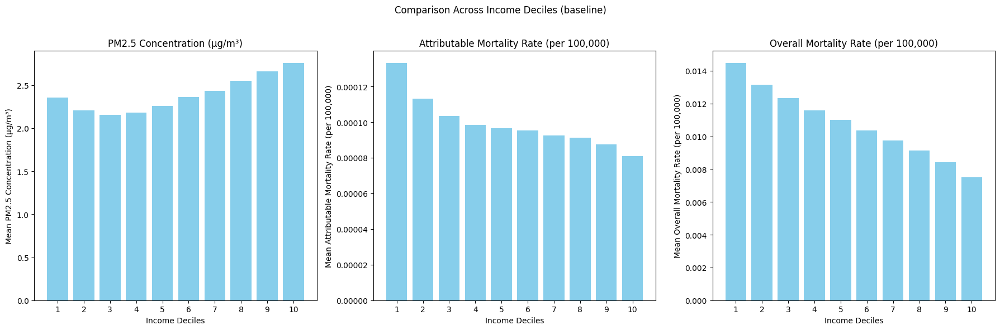

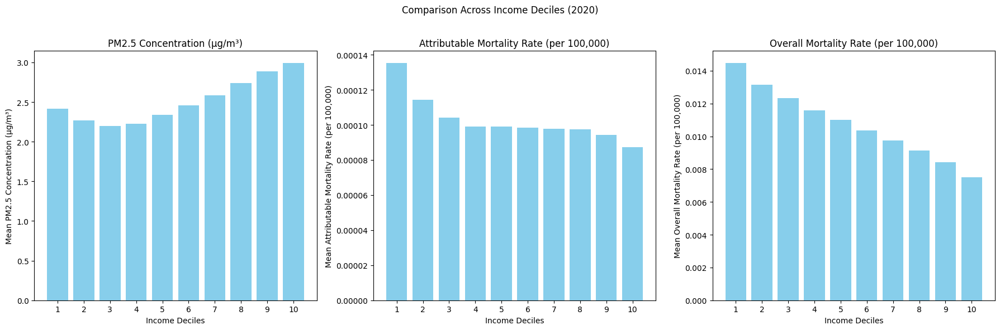

In [29]:
import matplotlib.pyplot as plt
def income_decile_comparison(df, loc = "", columns = ["2016_pm2.5", "Attributable_Mortality_Rate", "overall_mortality_rate_over_25"], version="baseline"):
    """
    Creates a figure with three panels comparing:
    - PM2.5 concentration
    - Attributable mortality rate
    - Overall mortality rate
    across income deciles.
    
    Parameters:
    - df: DataFrame containing the data.
    - version: Version label to include in the plot title.
    """
    # Define the columns for comparison
    #columns = ["2016_pm2.5", "Attributable_Mortality_Rate", "overall_mortality_rate_over_25"]
    
    labels = ["PM2.5 Concentration (µg/m³)", 
              "Attributable Mortality Rate (per 100,000)", 
              "Overall Mortality Rate (per 100,000)"]
    # Create income deciles
    # Copy and filter data if loc is specified
    df = df.copy(deep=True)
    if loc:
        df = df[df['CBSA'] == loc]
    
    df['income_decile'] = pd.qcut(df['median_household_income'], q=10, labels=range(1, 11))
    
    # Initialize the figure
    fig, axs = plt.subplots(1, 3, figsize=(18, 6), sharey=False)
    fig.suptitle(f"Comparison Across Income Deciles ({version})")

    for i, (col, label) in enumerate(zip(columns, labels)):
        # Calculate mean values of the column within each income decile
        decile_means = df.groupby('income_decile', observed = True)[col].mean()

        # Plot the results
        axs[i].bar(decile_means.index, decile_means.values, color='skyblue')
        axs[i].set_title(label)
        axs[i].set_xlabel("Income Deciles")
        axs[i].set_ylabel(f"Mean {label}")
        axs[i].set_xticks(range(1, 11))
        axs[i].set_xticklabels([str(d) for d in range(1, 11)])

    # Adjust layout
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

income_decile_comparison(pm_mortality_data_df_baseline, version="baseline")
income_decile_comparison(pm_mortality_data_df_2020, version="2020")


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


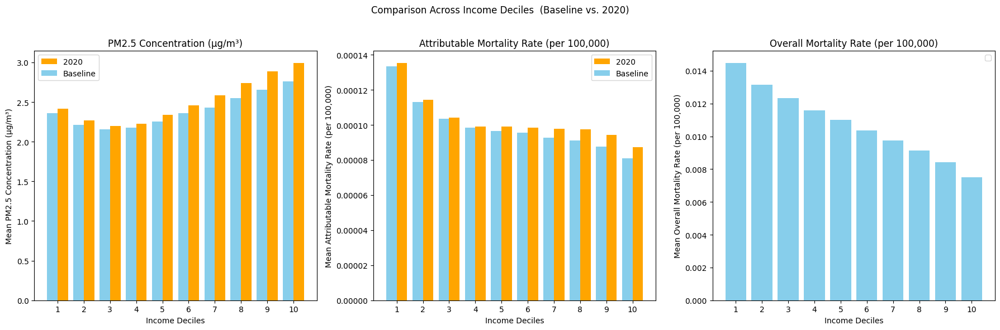

In [55]:
import pandas as pd
import matplotlib.pyplot as plt

def income_decile_comparison(df_baseline, df_2020, loc="", 
                              columns=["2016_pm2.5", "Attributable_Mortality_Rate", "overall_mortality_rate_over_25"]):
    """
    Creates a figure with three panels comparing:
    - PM2.5 concentration
    - Attributable mortality rate
    - Overall mortality rate
    across income deciles, showing baseline and 2020 data side by side.
    
    Parameters:
    - df_baseline: DataFrame containing the baseline data.
    - df_2020: DataFrame containing the 2020 data.
    - loc: Optional location filter for the data.
    - columns: Columns to compare across income deciles.
    """
    labels = ["PM2.5 Concentration (µg/m³)", 
              "Attributable Mortality Rate (per 100,000)", 
              "Overall Mortality Rate (per 100,000)"]
    
    # Filter data by location if specified
    df_baseline = df_baseline.copy()
    df_2020 = df_2020.copy()
    if loc:
        df_baseline = df_baseline[df_baseline['CBSA'] == loc]
        df_2020 = df_2020[df_2020['CBSA'] == loc]

    # Create income deciles for each dataset
    for df in [df_baseline, df_2020]:
        df['income_decile'] = pd.qcut(df['median_household_income'], q=10, labels=range(1, 11))
    
    # Initialize the figure
    fig, axs = plt.subplots(1, 3, figsize=(18, 6), sharey=False)
    fig.suptitle(f"Comparison Across Income Deciles {loc} (Baseline vs. 2020)")
    
    # Loop through each column and create a grouped bar chart
    bar_width = 0.4
    for i, (col, label) in enumerate(zip(columns, labels)):
        # Calculate mean values for each dataset
        decile_means_baseline = df_baseline.groupby('income_decile', observed=True)[col].mean()
        decile_means_2020 = df_2020.groupby('income_decile', observed=True)[col].mean()
        
        # Create positions for the bars
        x = range(1, 11)  # Deciles

        if col != 'overall_mortality_rate_over_25':
            x_baseline = [pos - bar_width / 2 for pos in x]
            x_2020 = [pos + bar_width / 2 for pos in x]
            axs[i].bar(x_2020, decile_means_2020.values, width=bar_width, label='2020', color='orange')
            axs[i].bar(x_baseline, decile_means_baseline.values, width=bar_width, label='Baseline', color='skyblue')

        else:
            x_baseline = [pos for pos in x]
            axs[i].bar(x_baseline, decile_means_baseline.values, width=bar_width*2,color='skyblue')

        # Set title, labels, and ticks
        axs[i].set_title(label)
        axs[i].set_xlabel("Income Deciles")
        axs[i].set_ylabel(f"Mean {label}")
        axs[i].set_xticks(range(1, 11))
        axs[i].set_xticklabels([str(d) for d in range(1, 11)])
        axs[i].legend()

    # Adjust layout
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

# Call the function with the baseline and 2020 datasets
income_decile_comparison(pm_mortality_data_df_baseline, pm_mortality_data_df_2020, loc="")


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


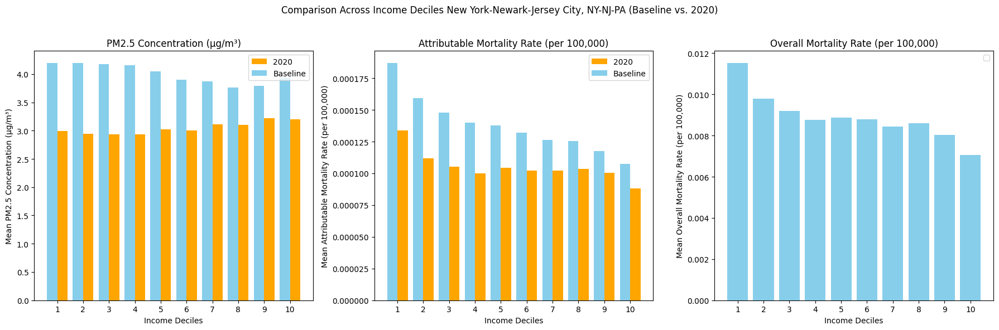

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


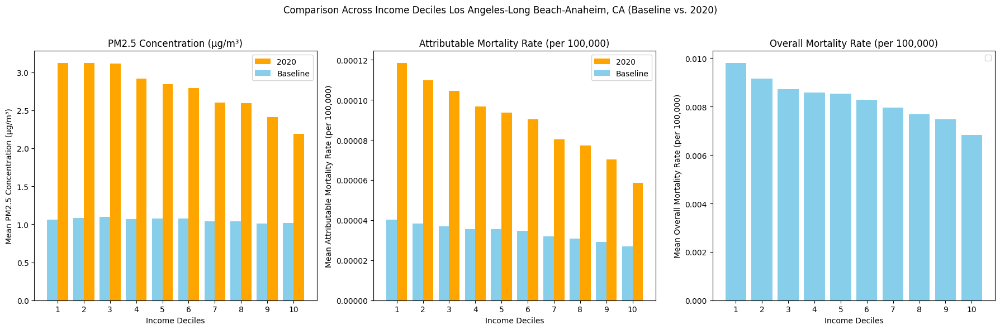

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


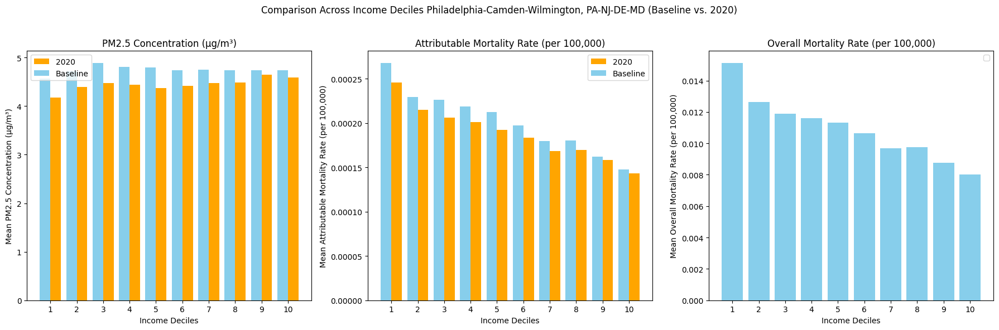

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


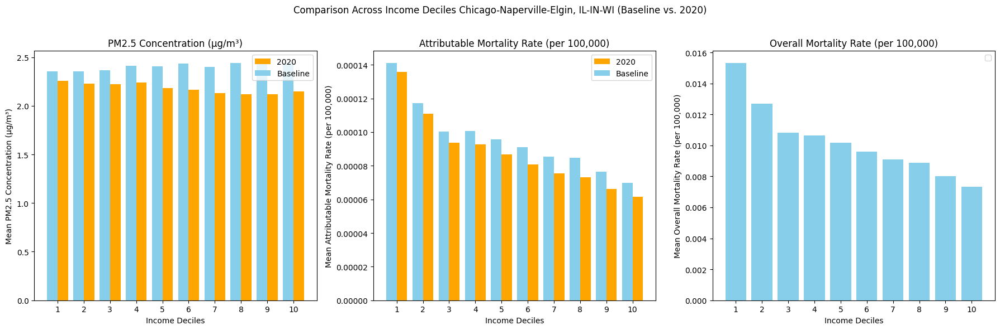

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


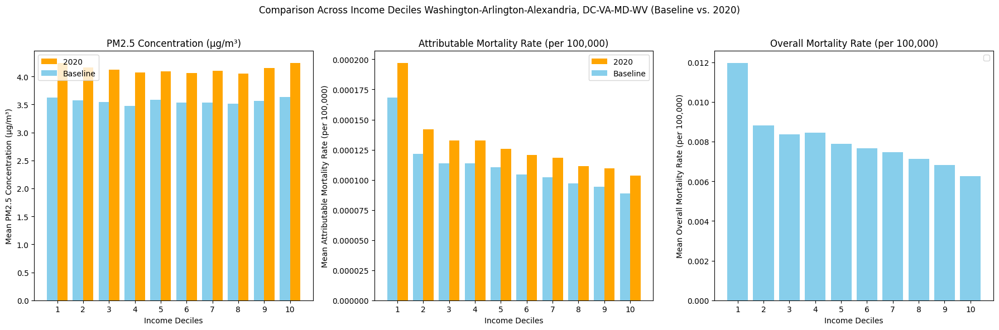

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


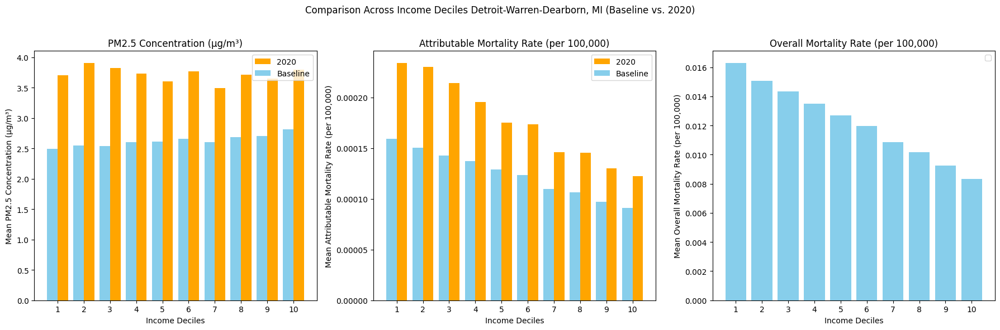

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


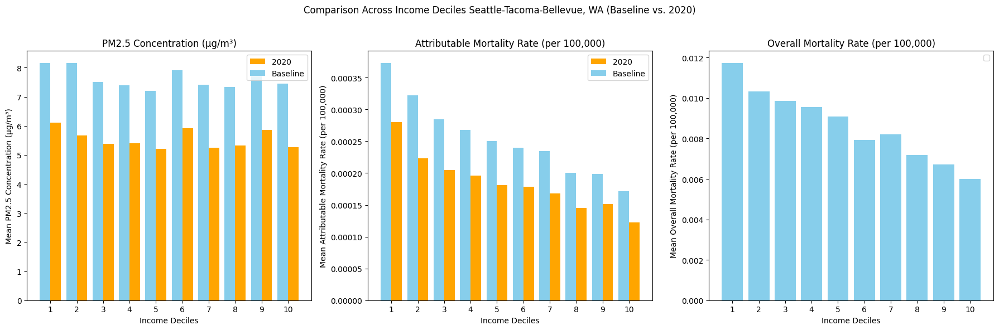

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


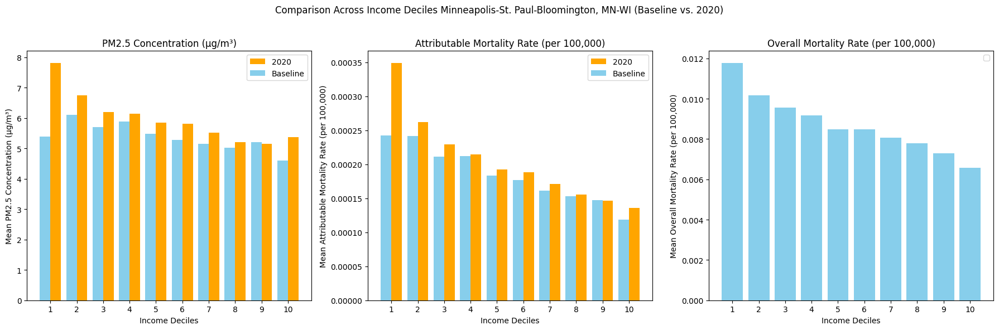

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


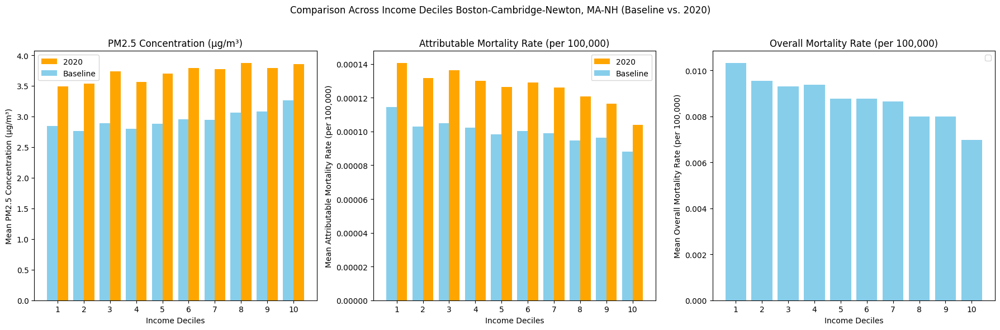

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


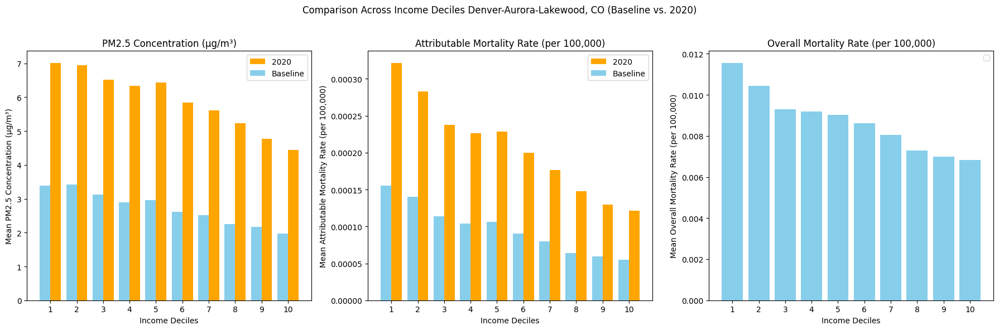

In [56]:
for cbsa in list(pm_mortality_data_df_2020.groupby('CBSA')[['Total', 'Attributable_Mortality']].sum().sort_values('Attributable_Mortality',ascending = False)[0:10].index):
    income_decile_comparison(pm_mortality_data_df_baseline, pm_mortality_data_df_2020, loc=cbsa)

##### For Poster

In [180]:
for cbsa in list(pm_mortality_data_df_2020.groupby('CBSA')[['Total', 'Attributable_Mortality']].sum().sort_values('Attributable_Mortality',ascending = False)[0:10].index):
    print(cbsa)

New York-Newark-Jersey City, NY-NJ-PA
Los Angeles-Long Beach-Anaheim, CA
Philadelphia-Camden-Wilmington, PA-NJ-DE-MD
Chicago-Naperville-Elgin, IL-IN-WI
Washington-Arlington-Alexandria, DC-VA-MD-WV
Detroit-Warren-Dearborn, MI
Seattle-Tacoma-Bellevue, WA
Minneapolis-St. Paul-Bloomington, MN-WI
Boston-Cambridge-Newton, MA-NH
Denver-Aurora-Lakewood, CO


/home/ksz4578/.conda/envs/WRF/lib/python3.10/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/ksz4578/.conda/envs/WRF/lib/python3.10/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/ksz4578/.conda/envs/WRF/lib/python3.10/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

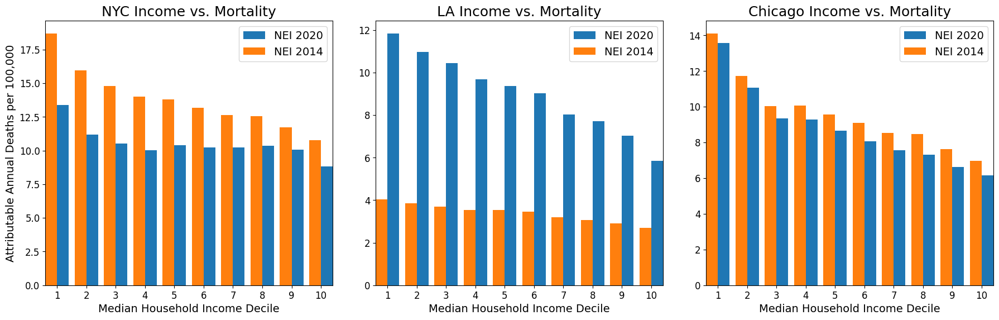

In [207]:
import pandas as pd
import matplotlib.pyplot as plt

def income_decile_comparison(df_baseline, df_2020, col="Attributable_Mortality_Rate", 
                             cities = ["New York-Newark-Jersey City, NY-NJ-PA", "Los Angeles-Long Beach-Anaheim, CA", "Chicago-Naperville-Elgin, IL-IN-WI"]):
    """
    Creates a figure with three panels comparing:
    - PM2.5 concentration
    - Attributable mortality rate
    - Overall mortality rate
    across income deciles, showing baseline and 2020 data side by side.
    
    Parameters:
    - df_baseline: DataFrame containing the baseline data.
    - df_2020: DataFrame containing the 2020 data.
    - loc: Optional location filter for the data.
    - columns: Columns to compare across income deciles.
    """
        
    # Filter data by location if specified
    df_baseline = df_baseline.copy()
    df_2020 = df_2020.copy()
    

    # Initialize the figure
    fig, axs = plt.subplots(1, 3, figsize=(18, 6), sharey=False)
    #fig.suptitle(f"Comparison Across Income Deciles {loc} (Baseline vs. 2020)")

    i = 0
    for loc in cities:
        place = loc.split("-")[0]
        if place == "Los Angeles": place = "LA"
        if place == "New York": place = "NYC"
        
        df_baseline_loc = df_baseline[df_baseline['CBSA'] == loc]
        df_2020_loc = df_2020[df_2020['CBSA'] == loc]

        if "Attributable" in col:
            df_baseline_loc[col] = df_baseline_loc[col] * 100000
            df_2020_loc[col] = df_2020_loc[col] * 100000
            axs[i].set_title(f"{place} Income vs. Mortality", fontsize = 18)
            if i == 0:
                axs[i].set_ylabel(f"Attributable Annual Deaths per 100,000", fontsize = 14)
        else:
            axs[i].set_title(f"{place} Income vs. PM2.5 Concentration", fontsize = 18)
            if i == 0:
                axs[i].set_ylabel("PM2.5 Concentration (µg/m³)", fontsize = 14)
            
        # Create income deciles for each dataset
        for df in [df_baseline_loc, df_2020_loc]:
            df['income_decile'] = pd.qcut(df['median_household_income'], q=10, labels=range(1, 11))
        
        # Loop through each column and create a grouped bar chart
        bar_width = 0.4

        # Calculate mean values for each dataset
        decile_means_baseline = df_baseline_loc.groupby('income_decile', observed=True)[col].mean()
        decile_means_2020 = df_2020_loc.groupby('income_decile', observed=True)[col].mean()
            
        # Create positions for the bars
        x = range(1, 11)  # Deciles

        x_baseline = [pos - bar_width / 2 for pos in x]
        x_2020 = [pos + bar_width / 2 for pos in x]
        axs[i].bar(x_2020, decile_means_2020.values, width=bar_width, label='NEI 2020')
        axs[i].bar(x_baseline, decile_means_baseline.values, width=bar_width, label='NEI 2014')
        axs[i].tick_params(axis='y', labelsize=12)

        # Set title, labels, and ticks
        axs[i].set_xlabel("Median Household Income Decile", fontsize = 14)


        # Get decile bounds
        decile_bounds = df_baseline_loc['median_household_income'].quantile([i/10 for i in range(11)]).values
        decile_labels = [f"${decile_bounds[i]:,.0f}–${decile_bounds[i+1]:,.0f}" for i in range(10)]
        
        # # Set tick positions and labels
        # axs[i].set_xticks(range(1, 11))
        # axs[i].set_xticklabels(decile_labels, fontsize=12, rotation=0, ha="right")
        
        axs[i].set_xticks(range(1, 11))
        axs[i].set_xticklabels([str(d) for d in range(1, 11)], fontsize=12)

    
        axs[i].legend(fontsize = 14)
        axs[i].set_xlim([0.6, 10.4])
        
        i+=1

    # Adjust layout
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.subplots_adjust(wspace=0.15)  # Adjust horizontal and vertical spacing
    plt.subplots_adjust(bottom=0.1)  # Adjust bottom padding to 0.75 inches
    plt.show()

# Call the function with the baseline and 2020 datasets
income_decile_comparison(pm_mortality_data_df_baseline, pm_mortality_data_df_2020, col="Attributable_Mortality_Rate", 
                             cities = ["New York-Newark-Jersey City, NY-NJ-PA", "Los Angeles-Long Beach-Anaheim, CA", "Chicago-Naperville-Elgin, IL-IN-WI"])

/home/ksz4578/.conda/envs/WRF/lib/python3.10/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/ksz4578/.conda/envs/WRF/lib/python3.10/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/ksz4578/.conda/envs/WRF/lib/python3.10/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

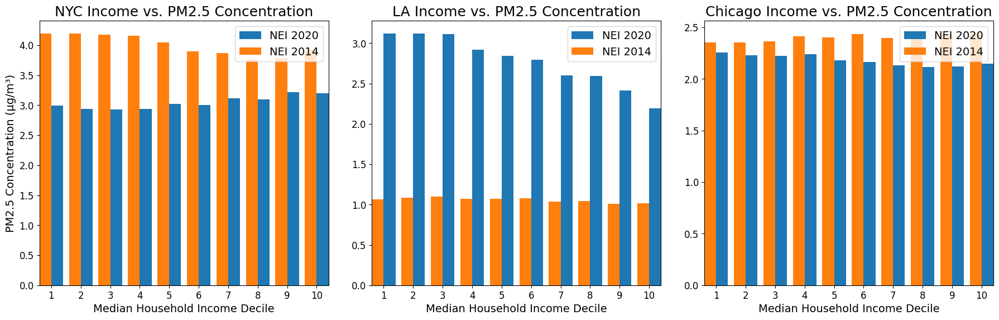

In [208]:
income_decile_comparison(pm_mortality_data_df_baseline, pm_mortality_data_df_2020, col="2016_pm2.5", 
                             cities = ["New York-Newark-Jersey City, NY-NJ-PA", "Los Angeles-Long Beach-Anaheim, CA", "Chicago-Naperville-Elgin, IL-IN-WI"])

### Emissions - Concentrations - Mortality Rates Plot

In [25]:
rwc_2020_new_surg =  xr.open_dataset('../SMOKE_sensitivity_analyses/2020_new_surrogates_avg.nc')

def add_pm25(dataset):
    # Extract variables representing PM2.5 components
    pm25_components = ['PAL', 'PCA', 'PCL', 'PEC', 'PFE', 'PH2O', 'PK', 'PMG', 'PMN', 'PMOTHR', 'PNA', 'PNCOM', 'PNH4', 'PNO3', 'POC', 'PSI', 'PSO4', 'PTI']
    pm25_concentrations = dataset[pm25_components]

    # Sum up the concentrations along the specified dimensions (if necessary)
    # Access the variables you want to sum
    #PSO4', 'PNO3', 'POC', 'PEC', 'PNH4',
    pm25_total =  pm25_concentrations.variables[pm25_components[0]]
    for component in pm25_components[1:]:
        pm25_total += pm25_concentrations.variables[component]
        
    # Sum the emissions for each grid cell across the variables
    #pm25_total = var1+ var2 + var3 + var4 + var5

    # # Create a new variable for PM2.5 total and assign the calculated values to it
    dataset['PM25_total'] = pm25_total

    # Optionally, you can add attributes to the new variable to provide metadata
    dataset['PM25_total'].attrs['long_name'] = 'PM25_total'
    dataset['PM25_total'].attrs['units'] = 'g/s'
    dataset['PM25_total'].attrs['var_desc'] = 'Total PM2.5 concentration'
    return dataset

rwc_2020_new_surg = add_pm25(rwc_2020_new_surg)

In [26]:
seconds_in_a_day = 24 * 60 * 60  # Number of seconds in a day
days_in_month = 31  # Approximate days in a month (adjust if necessary)
seconds_in_a_month = seconds_in_a_day * days_in_month
grams_to_tons = 1 / 1_000_000  # Conversion factor from grams to tons
gps_to_tons = seconds_in_a_month * grams_to_tons
rwc_2020_new_surg['PM25_total_tons'] = rwc_2020_new_surg['PM25_total'] * gps_to_tons

pmgdf['PM25_total_tons'] = rwc_2020_new_surg['PM25_total_tons'][0,0,:,:].to_numpy().flatten()

In [27]:
import matplotlib.pyplot as plt
from pyproj import CRS, Transformer
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from shapely.geometry import box
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize


def plot_MSA(df, cbsa, MSA, title, col="PM25", cmap="viridis", vs=False, counties=False, difference=False, state_color="white", ax=None, title_size = 20):
    from shapely.geometry import box
    
    # Define the target projection
    target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))
    
    # Generate map features
    resol = '50m'
    bodr = cfeature.NaturalEarthFeature(category='cultural', edgecolor='white', name='admin_0_boundary_lines_land', scale='50m', facecolor='none', alpha=0.7)
    ocean = cfeature.NaturalEarthFeature('physical', 'ocean', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    lakes = cfeature.NaturalEarthFeature('physical', 'lakes', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    states_provinces = cfeature.NaturalEarthFeature(category='cultural', name='admin_1_states_provinces_lines', scale='50m', edgecolor=state_color, facecolor='none')
    
    # Customize plot appearance
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.set_xticks([])
    ax.set_yticks([])
    
    # Add features to the map
    # if counties:
    #     ax.add_feature(COUNTIES, facecolor='none', edgecolor=state_color)
    ax.add_feature(ocean, linewidth=0, zorder=0, facecolor = "white")
    ax.add_feature(lakes, linewidth=0, zorder=0, facecolor = "white")
    # ax.add_feature(states_provinces, edgecolor=state_color, linewidth=0.5, zorder=0)
    
    # Get the geometry for the specified MSA
    msa_geometry = cbsa.loc[cbsa["NAME"] == MSA, "geometry"].iloc[0]
    
    # Clip the data to the CBSA boundary
    clipped_df = df.clip(mask=msa_geometry)
    #clipped_df = gpd.overlay(df, gpd.GeoDataFrame(geometry=[msa_geometry], crs=cbsa.crs), how='intersection')

    # Set visualization limits
    if vs:
        vmin = vs[0]
        vmax = vs[1]
    elif not difference:
        vmin = np.quantile(clipped_df[col], 0.025)
        vmax = np.quantile(clipped_df[col], 0.975)
    else:
        vmin = -max(abs(np.quantile(clipped_df[col], 0.025)), abs(np.quantile(clipped_df[col], 0.975)))
        vmin = max(vmin, -20)
        vmax = -vmin
    
    # Plot clipped data
    legend_bool = True
    sc = clipped_df.plot(ax=ax, column=col, cmap=cmap, legend=False, vmin=vmin, vmax=vmax, zorder=-1, edgecolor="none", antialiased=False)

    # Create the ScalarMappable for the color bar
    norm = Normalize(vmin=vmin, vmax=vmax)
    sm = ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])  # Required for colorbar
    
    
    # Add the CBSA boundary
    ax.add_geometries([msa_geometry], crs=target_proj, edgecolor=state_color, facecolor='none', linewidth=1.5)
    
    # Add title
    ax.set_title(title, fontsize = title_size)
    ax.axis("off")
    return sc, sm




In [28]:
import matplotlib.pyplot as plt
from pyproj import CRS, Transformer
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from shapely.geometry import box


def plot_MSA_mortality(df, MSA, title, validation_df, col="PM25", cmap="viridis", vs=False, counties=False, difference=False, state_color="white", ax=None, title_size = 20):
    # Define the target projection
    target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))
    
    # Generate map features
    resol = '50m'  # use data at this scale
    bodr = cfeature.NaturalEarthFeature(category='cultural', edgecolor='black', name='admin_0_boundary_lines_land', scale='50m', facecolor='none', alpha=0.7)
    ocean = cfeature.NaturalEarthFeature('physical', 'ocean', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    lakes = cfeature.NaturalEarthFeature('physical', 'lakes', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    states_provinces = cfeature.NaturalEarthFeature(category='cultural', name='admin_1_states_provinces_lines', scale='50m', edgecolor=state_color, facecolor='none')
    
    # # Customize plot appearance
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.set_xticks([])
    ax.set_yticks([])
    
    # # Add features to the map
    if counties:
        ax.add_feature(COUNTIES, facecolor='none', edgecolor=state_color)
    # ax.add_feature(ocean, linewidth=0.2, zorder=0)
    # ax.add_feature(lakes, linewidth=0.2, zorder=0)
    # ax.add_feature(states_provinces, edgecolor=state_color, linewidth=0.5, zorder=0)
    # msa_bounds = df.loc[df["CBSA"] == MSA].total_bounds  # [minx, miny, maxx, maxy]

    ax.add_feature(ocean, linewidth=0, zorder=0, facecolor = "white")
    ax.add_feature(lakes, linewidth=0, zorder=0, facecolor = "white")
    # ax.add_feature(states_provinces, edgecolor=state_color, linewidth=0.5, zorder=0)
    
    # Get the geometry for the specified MSA
    msa_geometry = cbsa.loc[cbsa["NAME"] == MSA, "geometry"].iloc[0]

    sub_df = df.loc[df['CBSA'] == MSA]
    
    # Drop rows where geometry is now None (no intersection)
    try:
        clipped_df = sub_df.clip(mask=msa_geometry)
    except Exception as e:
        clipped_df = sub_df
    
    if vs:
        vmin = vs[0]
        vmax = vs[1]
    elif not difference:
        vmin = np.quantile(clipped_df[col], 0.025)
        vmax = np.quantile(clipped_df[col], 0.975)
    else:
        vmin = -max( [abs(np.quantile(clipped_df[col], 0.025)), abs(np.quantile(clipped_df[col], 0.975))] )
        vmax =-vmin
        
    # # Plot MSA area data
    sc = clipped_df.plot(ax=ax, column=col, cmap=cmap, legend=False, vmin=vmin, vmax=vmax, zorder=-1, legend_kwds={'label': col})
    
    # Create the ScalarMappable for the color bar
    norm = Normalize(vmin=vmin, vmax=vmax)
    sm = ScalarMappable(cmap=cmap, norm=norm)

    ax.set_title(title, fontsize = title_size)
    ax.axis("off")
    return sc, sm


In [29]:
# most populous 20
cbsa_list = [
    "New York-Newark-Jersey City, NY-NJ-PA",
    "Los Angeles-Long Beach-Anaheim, CA",
    "Chicago-Naperville-Elgin, IL-IN-WI",
    "Dallas-Fort Worth-Arlington, TX",
    "Houston-The Woodlands-Sugar Land, TX",
    "Washington-Arlington-Alexandria, DC-VA-MD-WV",
    "Miami-Fort Lauderdale-Pompano Beach, FL",
    "Philadelphia-Camden-Wilmington, PA-NJ-DE-MD",
    "Atlanta-Sandy Springs-Alpharetta, GA",
    "Boston-Cambridge-Newton, MA-NH",
    "Phoenix-Mesa-Chandler, AZ",
    "San Francisco-Oakland-Berkeley, CA",
    "Riverside-San Bernardino-Ontario, CA",
    "Detroit-Warren-Dearborn, MI",
    "Seattle-Tacoma-Bellevue, WA",
    "Minneapolis-St. Paul-Bloomington, MN-WI",
    "San Diego-Chula Vista-Carlsbad, CA",
    "Tampa-St. Petersburg-Clearwater, FL",
    "Denver-Aurora-Lakewood, CO",
    "St. Louis, MO-IL"
]

pm_mortality_data_df_2020['Attributable_Mortality_Rate_100000'] = pm_mortality_data_df_2020['Attributable_Mortality_Rate'] * 100000

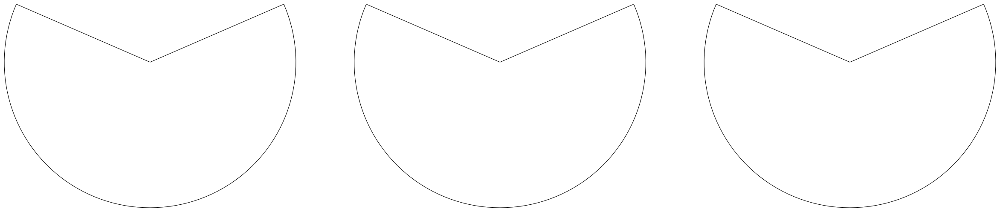

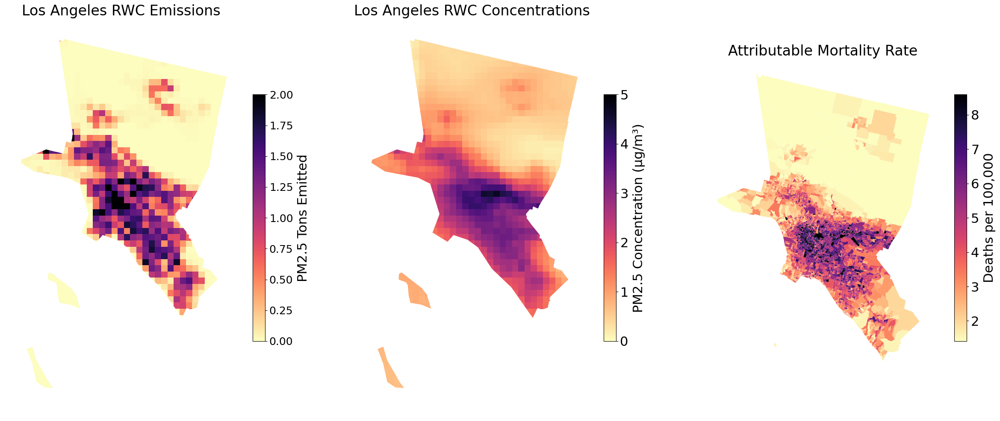

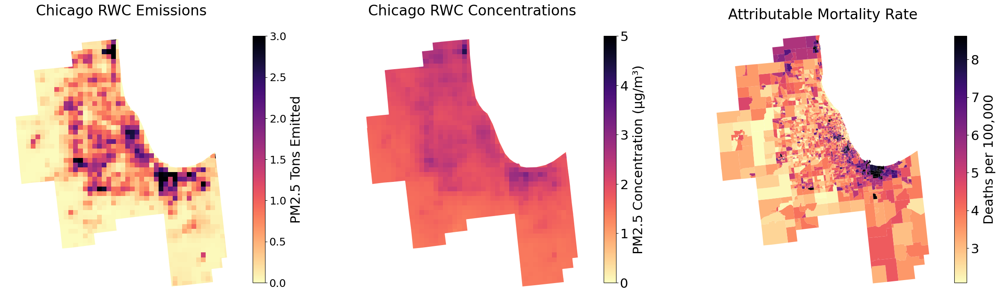

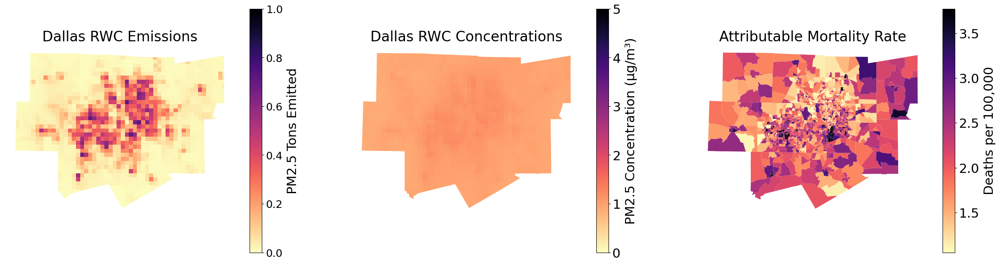

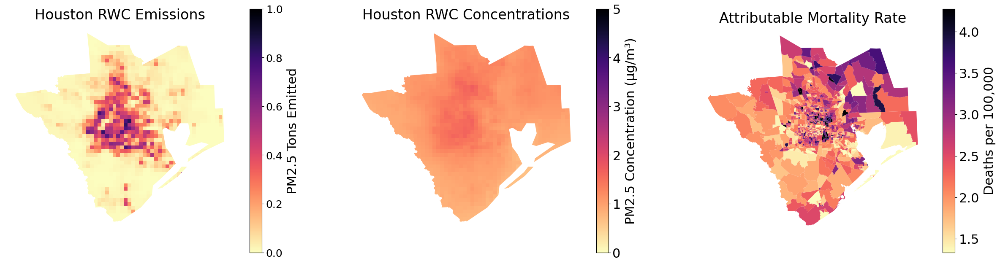

...

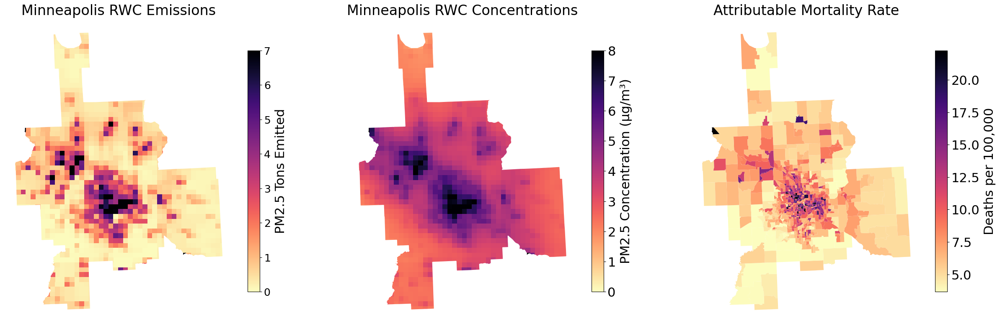

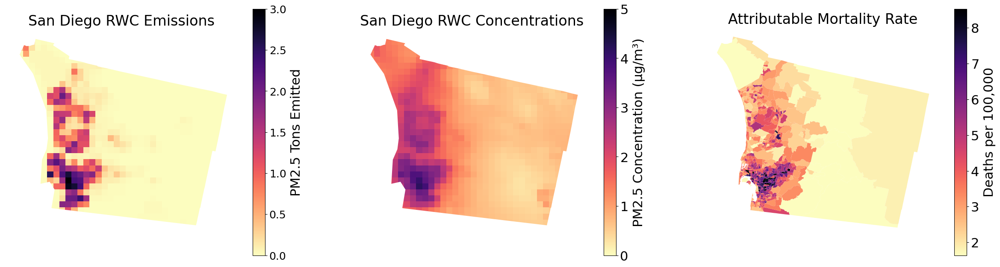

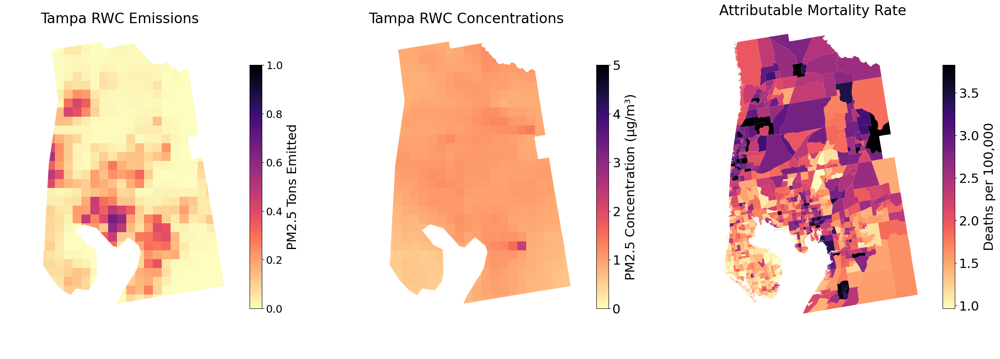

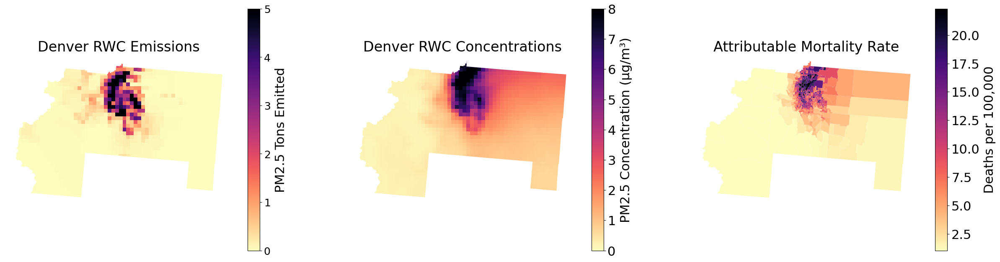

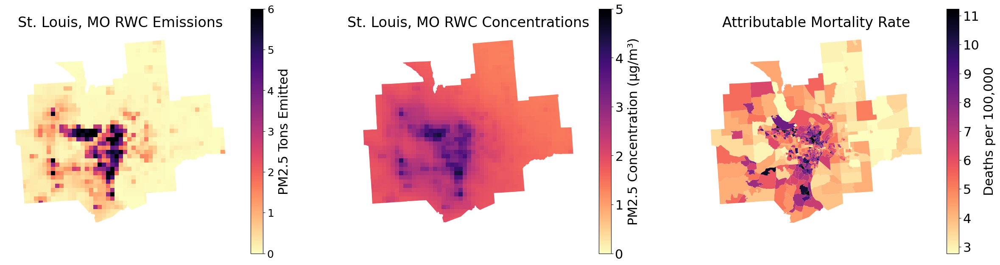

In [36]:
for MSA in cbsa_list[1:]:
    df = pmgdf

    upper_bound = 5
    if df.loc[df['CBSA'] == MSA]['PM25_RWC_2020'].quantile(0.98) >= 5:
        upper_bound = np.ceil(df.loc[df['CBSA'] == MSA]['PM25_RWC_2020'].quantile(0.98))

    emissions_upper_bound = 1
    if df.loc[df['CBSA'] == MSA]['PM25_total_tons'].quantile(0.98) >= 1:
        emissions_upper_bound = np.ceil(df.loc[df['CBSA'] == MSA]['PM25_total_tons'].quantile(0.98))
    
    # Create a Matplotlib figure with 1 row and 3 columns
    target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30, 30), subplot_kw={'projection': target_proj})
    
    place = MSA.split('-')[0]
    
    sc, sm = plot_MSA(
            df=df,
            col="PM25_total_tons",
            cbsa = cbsa,
            MSA=MSA,
            title=f'{place} RWC Emissions',
            cmap="magma_r",
            vs=[0, emissions_upper_bound],
            counties=False,
            difference=False,
            ax=axes[0],
            title_size = 24
        )
    colorbar_title_size = 22
    colorbar_tick_size = 22
    
    cbar = fig.colorbar(sm, ax=axes[0], orientation="vertical", shrink=0.25)
    cbar.ax.tick_params(labelsize=18)
    cbar.ax.set_ylabel("PM2.5 Tons Emitted", rotation=90, fontsize=22, labelpad = 7)


    sc, sm = plot_MSA(
            df=df,
            col="PM25_RWC_2020",
            cbsa = cbsa,
            MSA=MSA,
            title=f'{place} RWC Concentrations',
            cmap="magma_r",
            vs=[0, upper_bound],
            counties=False,
            difference=False,
            ax=axes[1],
            title_size = 24
        )
    cbar = fig.colorbar(sm, ax=axes[1], orientation="vertical", shrink=0.25)
    cbar.ax.tick_params(labelsize=22)
    cbar.ax.set_ylabel("PM2.5 Concentration (µg/m³)", rotation=90, fontsize=22, labelpad = 7)   

    sc, sm = plot_MSA_mortality(
        df=pm_mortality_data_df_2020,
        col="Attributable_Mortality_Rate_100000",
        MSA=MSA,
        title=f'Attributable Mortality Rate',
        validation_df=pd.DataFrame(),  # No validation points for difference
        cmap="magma_r",
        vs=False,
        counties=False,
        difference=False,
        ax=axes[2],
        state_color="black",# Pass the third axis,
        title_size = 24
    )
    
    colorbar_title_size = 22
    colorbar_tick_size = 22
    
    cbar = fig.colorbar(sm, ax=axes[2], orientation="vertical", shrink=0.25)
    cbar.ax.tick_params(labelsize=22)
    cbar.ax.set_ylabel("Deaths per 100,000", rotation=90, fontsize=22, labelpad = 7)
    plt.show()


In [27]:
msa_geometry = cbsa.loc[cbsa["NAME"] == MSA, "geometry"].iloc[0]

In [31]:
df = pm_mortality_data_df_2020.loc[pm_mortality_data_df_2020['CBSA'] == MSA]

In [32]:
clipped_df = df.clip(mask=msa_geometry)

<Axes: >

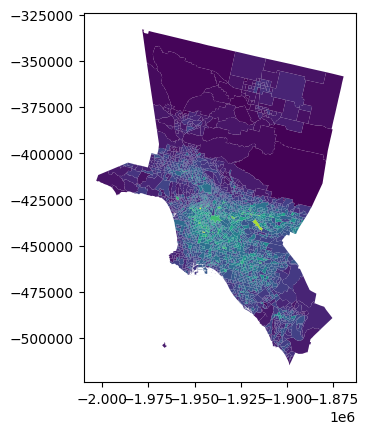

In [34]:
clipped_df.plot(column = 'Attributable_Mortality_Rate_100000')

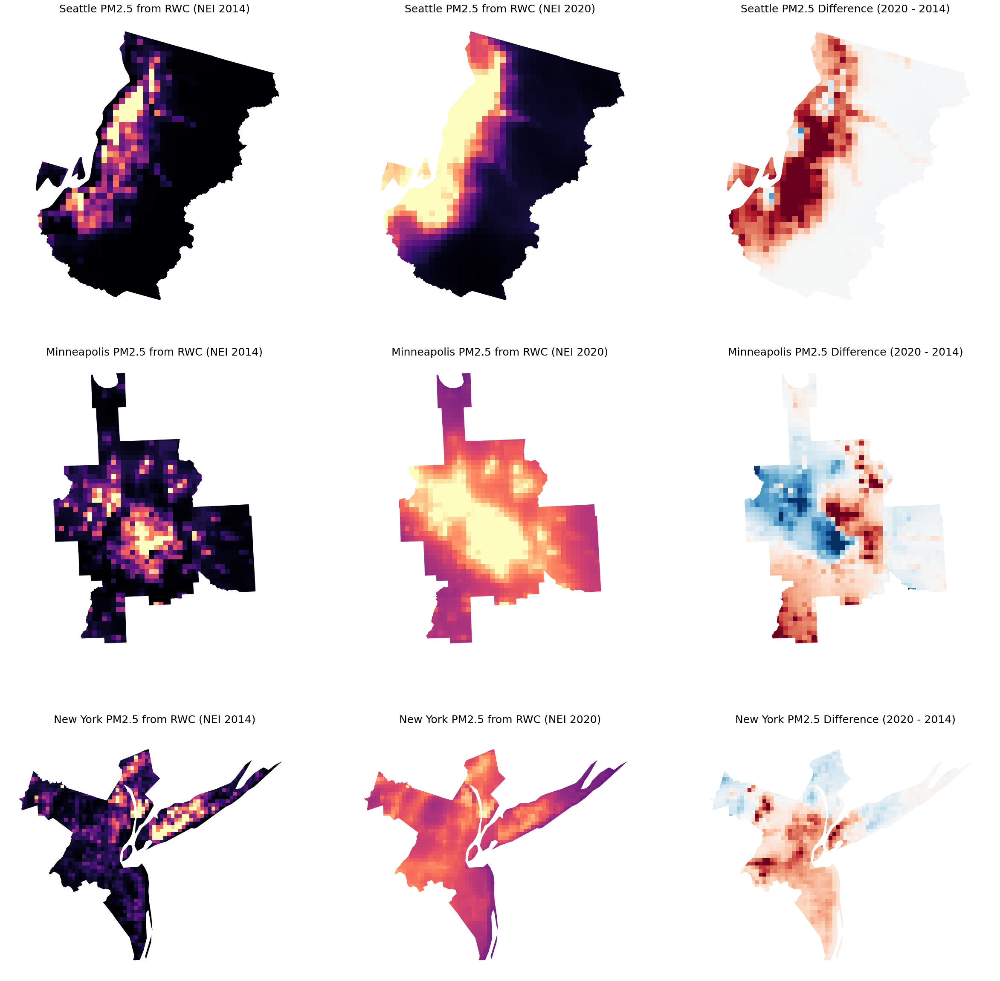

In [39]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
df = pmgdf

# List of MSAs to plot
MSAs = [
    'Seattle-Tacoma-Bellevue, WA',
    'Minneapolis-St. Paul-Bloomington, MN-WI',
    'New York-Newark-Jersey City, NY-NJ-PA',
]

# Create a Matplotlib figure with 3 rows and 3 columns
target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(30, 30), subplot_kw={'projection': target_proj})

# Adjust spacing between subplots
fig.subplots_adjust(hspace=0.15, wspace=0.15)

# Iterate through MSAs and plot data
for i, MSA in enumerate(MSAs):
    place = MSA.split('-')[0]

    # Plot for 2014 PM2.5 data
    sc = plot_MSA(
        df=df,
        col="PM25_total_tons",
        cbsa=cbsa,
        MSA=MSA,
        title=f'{place} PM2.5 from RWC (NEI 2014)',
        cmap="magma",
        #vs=[0, 5],
        counties=False,
        difference=False,
        ax=axes[i, 0],  # Use the first column for 2014 data
        title_size=18
    )

    # Plot for 2020 PM2.5 data
    sc = plot_MSA(
        df=df,
        col="PM25_RWC_2020",
        cbsa=cbsa,
        MSA=MSA,
        title=f'{place} PM2.5 from RWC (NEI 2020)',
        cmap="magma",
        vs=[0, 5],
        counties=False,
        difference=False,
        ax=axes[i, 1],  # Use the second column for 2020 data
        title_size=18
    )

    # Plot for PM2.5 difference data
    sc = plot_MSA(
        df=df,
        col="PM25_diff",
        cbsa=cbsa,
        MSA=MSA,
        title=f'{place} PM2.5 Difference (2020 - 2014)',
        cmap="RdBu",
        vs=[-3, 3],
        counties=False,
        difference=True,
        ax=axes[i, 2],  # Use the third column for difference data
        title_size=18
    )


# Show the plot
plt.show()


In [25]:
pmgdf

,row,col,geometry,PM25,PM25_2020,PM25_diff,PM25_RWC,PM25_RWC_2020,PM25_RWC_percent,PM25_RWC_percent_2020,RWC_percent_diff,centroid,CBSA,CBSAFP
0,0,0,"POLYGON ((-2292000.000 -1584000.000, -2288000....",2.149320,2.176229,0.026909,0.035388,0.062297,1.646474,2.862628,1.251994,POINT (-2290000.000 -1582000.000),NaN,NaN
1,0,1,"POLYGON ((-2288000.000 -1584000.000, -2284000....",2.174846,2.203372,0.028527,0.034659,0.063186,1.593637,2.867692,1.311669,POINT (-2286000.000 -1582000.000),NaN,NaN
2,0,2,"POLYGON ((-2284000.000 -1584000.000, -2280000....",2.191616,2.220225,0.028608,0.035922,0.064530,1.639067,2.906479,1.305353,POINT (-2282000.000 -1582000.000),NaN,NaN
3,0,3,"POLYGON ((-2280000.000 -1584000.000, -2276000....",2.203532,2.234079,0.030547,0.036926,0.067473,1.675744,3.020168,1.386292,POINT (-2278000.000 -1582000.000),NaN,NaN
4,0,4,"POLYGON ((-2276000.000 -1584000.000, -2272000....",2.212906,2.247626,0.034720,0.035542,0.070262,1.606124,3.126041,1.568964,POINT (-2274000.000 -1582000.000),NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
838525,725,1150,"POLYGON ((2308000.000 1316000.000, 2312000.000...",0.993596,1.014168,0.020572,0.084999,0.105571,8.554710,10.409653,2.070472,POINT (2310000.000 1318000.000),NaN,NaN
838526,725,1151,"POLYGON ((2312000.000 1316000.000, 2316000.000...",0.993990,1.011813,0.017822,0.083515,0.101337,8.402010,10.015429,1.792996,POINT (2314000.000 1318000.000),NaN,NaN
838527,725,1152,"POLYGON ((2316000.000 1316000.000, 2320000.000...",1.041173,1.058569,0.017396,0.082590,0.099986,7.932420,9.445392,1.670782,POINT (2318000.000 1318000.000),NaN,NaN
838528,725,1153,"POLYGON ((2320000.000 1316000.000, 2324000.000...",1.162705,1.178593,0.015888,0.083876,0.099764,7.213879,8.464688,1.366477,POINT (2322000.000 1318000.000),NaN,NaN


### Decile Plotting

In [37]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

def decile_plot(df, loc, col, version="baseline"):
    """
    Creates a figure with a horizontal decile bar plot showing the racial composition 
    within deciles of the specified data column, with tick marks between bars labeled 
    with the decile boundaries.
    
    Parameters:
    - df: DataFrame containing the data.
    - loc: Location filter for the 'CBSA Title' column. If empty, the whole DataFrame is used.
    - col: Column to create decile plots for.
    - version: Version label to include in the plot title.
    """
    
    # Copy and filter data if loc is specified
    place = loc.split("-")[0]
    df = df.copy(deep=True)
    if loc:
        df = df[df['CBSA'] == loc]
    
    # Define race columns and number of deciles
    race_columns = ["White", "Black", "American Indian", "Asian", "Native Hawaiian or Pacific Islander",
                    "Other", "Two or More Races", "Hispanic"]
    num_iles = 10
    
    # Create the figure and subplot
    fig, ax = plt.subplots(figsize=(7, 8))
    #fig.suptitle(f"Race Composition within Deciles for {col} in {loc} ({version})", fontsize=14)
    
    # Create decile bins and apply them to the DataFrame
    bins = pd.qcut(df[col], q=num_iles, retbins=True) 
    df['decile'] = pd.qcut(df[col], q=num_iles, labels=False)
    
    # Get decile ranges from the bins
    decile_ranges = bins[1]* 100000
    tick_labels = [f"{value:.2f}" for value in decile_ranges]
    
    # Calculate race percentages within each decile
    for race in race_columns:
        df[race + '_percentage'] = (df[race] / df['Total']) * 100

    # Plot the horizontal decile data
    bottom = np.zeros(len(decile_ranges) - 1)
    for race in race_columns:
        race_percentages = [df[df['decile'] == decile][race + '_percentage'].mean() for decile in range(num_iles)]
        ax.barh(range(len(race_percentages)), race_percentages, left=bottom, height=0.9, label=race)
        bottom += np.array(race_percentages)
    
    measure = ""
    if col == "Attributable_Mortality_Rate":
        measure = "Mortality"
        label = "Attributable Mortality Rate (Deaths per 100,000)"
    if col == "2016_pm2.5":
        measure = "PM2.5"
        label = "PM2.5 Concentration (µg/m³)"

    ax.tick_params(axis='x', labelsize=12)
    ax.set_title(f"{place} {measure}", fontsize=18)
    ax.set_ylabel(label, labelpad=35, fontsize = 14)
    ax.set_xlabel('Percentage of Population', fontsize = 14)
    ax.set_yticks([])
    ax.set_ylim(-0.45, len(race_percentages) - 0.55)  # Adjust to fit the bars tightly
    ax.set_xlim(0,100)
    ax.set_yticklabels([])
    ax.set_xticks(np.linspace(0, 100, 11))

    # Adjust the first and last bars
    ax.text(0.75, -0.45, "0.00-", ha='right', va='center', fontsize=14, color="black")  # Adjust first tick label
    for idx, label in enumerate(tick_labels):
        if idx < len(tick_labels) - 2:
            ax.text(0.75, idx + 0.5, f"{label}-", ha='right', va='center', fontsize=12, color="black")
    
    # Adjust last bar (if needed)
    ax.text(0.75, len(tick_labels) - 1 - 0.55, f"{tick_labels[-2]}-", ha='right', va='center', fontsize=12, color="black")

    
    # Add legend
    ax.legend(loc="upper center", bbox_to_anchor=(0.5, -0.15), ncol=3, fontsize=12)
    
    # Adjust layout
    #plt.tight_layout(rect=[0, 0, 1, 0.94])  # Adjust layout to fit title and legend
    plt.tight_layout(pad=0.0, rect=[0, 0, 0, 0])  # Adjust layout to remove padding
    plt.show()

# Example usage:
# Example DataFrame creation and function call would go here.


In [90]:
# Define colors matching the image
race_colors = {
    "White": "#AFCFEA",
    "Black": "#1F4E9C",
    "American Indian": "#A2CD73",
    "Asian": "#1E792C",
    "Native Hawaiian or Pacific Islander": "#F4A9A3",
    "Other": "#D7261E",
    "Two or More Races": "#F8C471",
    "Hispanic": "#E67E22"
}

def decile_plot(df_old, loc, col, version="baseline", ax=None, first = False, year = "2014", letter = ''):
    """
    Creates a figure with a horizontal decile bar plot showing the racial composition 
    within deciles of the specified data column, with tick marks between bars labeled 
    with the decile boundaries.
    
    Parameters:
    - df: DataFrame containing the data.
    - loc: Location filter for the 'CBSA Title' column. If empty, the whole DataFrame is used.
    - col: Column to create decile plots for.
    - version: Version label to include in the plot title.
    """
    
    # Copy and filter data if loc is specified
    place = letter + loc.split("-")[0]
    print(place)

    df = df_old.copy(deep=True)
    if loc == "CONUS":
        df = df
    elif loc:
        df = df[df['CBSA'] == loc]
    
    # Drop rows with NaN values in the specified column
    df = df.dropna(subset=[col])

    # Define race columns and number of deciles
    race_columns = ["White", "Black", "American Indian", "Asian", "Native Hawaiian or Pacific Islander",
                    "Other", "Two or More Races", "Hispanic"]
    num_iles = 10
    
    # Create decile bins and apply them to the DataFrame
    bins = pd.qcut(df[col], q=num_iles, retbins=True, duplicates='drop') 
    df['decile'] = pd.qcut(df[col], q=num_iles, labels=False, duplicates='drop')
    
    # Get decile ranges from the bins
    decile_ranges = bins[1]
    if col == "Attributable_Mortality_Rate":
        decile_ranges = decile_ranges * 100000

    tick_labels = [f"{value:.1f}" for value in decile_ranges]
    
    # Calculate race percentages within each decile
    for race in race_columns:
        df[race + '_percentage'] = (df[race] / df['Total']) * 100

    # Plot the horizontal decile data
    bottom = np.zeros(len(decile_ranges) - 1)
    for race in race_columns:
        race_percentages = [df[df['decile'] == decile][race + '_percentage'].mean() for decile in range(num_iles)]
        ax.barh(range(len(race_percentages)), race_percentages, left=bottom, height=0.9, label=race, color=race_colors[race])
        bottom += np.array(race_percentages)
    
    measure = ""
    if col == "Attributable_Mortality_Rate":
        measure = "Mortality"
        label = "RWC PM2.5 Attr. Mort. Rate Deciles\n(Deaths per 100,000)"
    if col == "2016_pm2.5":
        measure = "PM2.5"
        label = "RWC PM2.5 nConcentration Deciles\n(µg/m³) "

    ax.tick_params(axis='x', labelsize=16)
    
    ax.set_title(f"{place}", fontsize=20)

    ax.set_yticks([])
    ax.set_yticklabels([])
    ax.set_ylim(-0.45, len(race_percentages) - 0.55)  # Adjust to fit the bars tightly
    ax.set_xlim(0, 100)
    
    ax.set_xticks([0, 25, 50, 75, 100])
    #ax.set_xlabel('Percentage of Population', fontsize=14)
    
    if first:
        ax.set_ylabel(label, labelpad=45, fontsize=16)

    ax.text(0.75, -0.44, f"{tick_labels[0]}-", ha='right', va='center', fontsize=16, color="black")
        
    # Adjust the first and last bars
    for idx, label in enumerate(tick_labels):
        if idx < len(tick_labels) - 1 and idx > 0:
            ax.text(0.75, idx - 0.5, f"{label}-", ha='right', va='center', fontsize=16, color="black")
    
    # Adjust last bar (if needed)
    ax.text(0.75, len(tick_labels) - 1 - 0.55, f"{tick_labels[-1]}-", ha='right', va='center', fontsize=16, color="black")



A Los Angeles
B Chicago
C New York
D CONUS
E Los Angeles
F Chicago
G New York
H CONUS


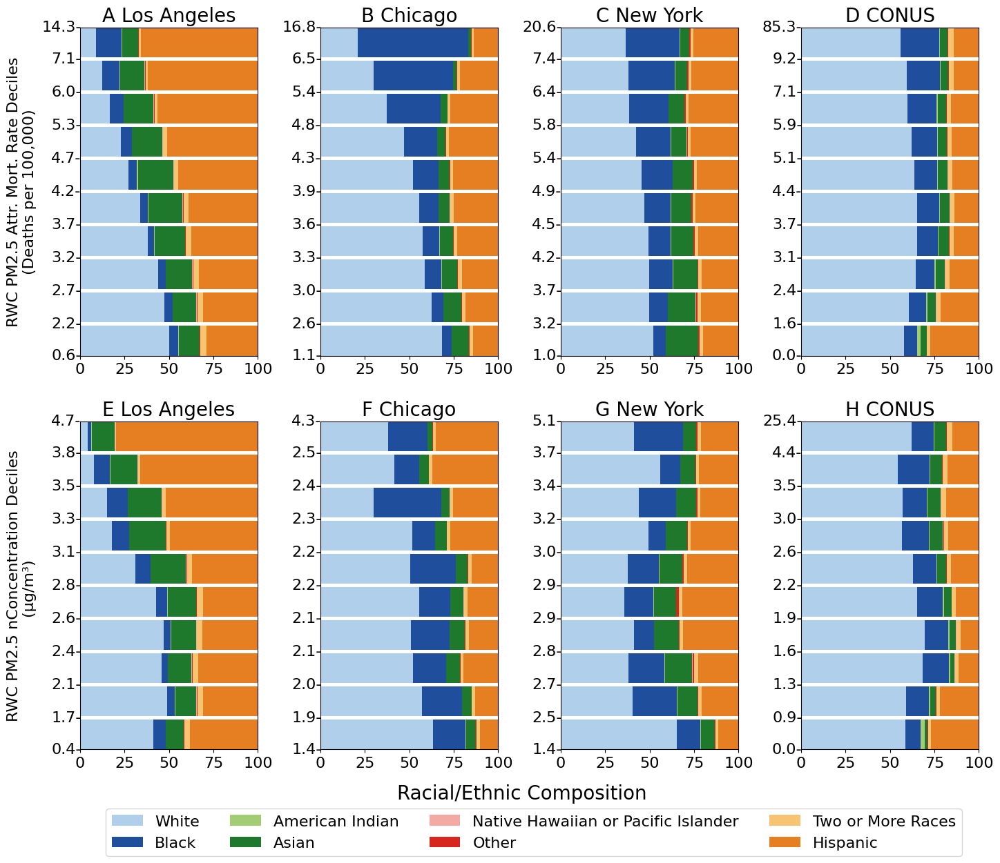

In [103]:
# Example usage for plotting on subplots:
fig, axs = plt.subplots(2, 4, figsize=(14, 12))
plt.tight_layout(pad=2.0, rect=[0, 0, 1.0, 1.0])  # Adjust layout to remove padding
plt.subplots_adjust(hspace=0.2, wspace=0.35)  # Adjust horizontal and vertical spacing
plt.subplots_adjust(bottom=0.1)  # Adjust bottom padding to 0.75 inches

# Call decile_plot for each subplot
decile_plot(pm_mortality_data_df_2020, "Los Angeles-Long Beach-Anaheim, CA", "Attributable_Mortality_Rate", letter = "A ", ax=axs[0, 0], first = True, year = "2020")
decile_plot(pm_mortality_data_df_2020, 'Chicago-Naperville-Elgin, IL-IN-WI', "Attributable_Mortality_Rate", letter = "B ",ax=axs[0, 1], year = "2020")
decile_plot(pm_mortality_data_df_2020, "New York-Newark-Jersey City, NY-NJ-PA", "Attributable_Mortality_Rate", letter = "C ",ax=axs[0, 2], year = "2020")
decile_plot(pm_mortality_data_df_2020, "CONUS", "Attributable_Mortality_Rate", letter = "D ", ax=axs[0, 3], year = "2020")

decile_plot(pm_mortality_data_df_2020, "Los Angeles-Long Beach-Anaheim, CA", "2016_pm2.5",  letter = "E ",ax=axs[1, 0], first = True, year = "2020")
decile_plot(pm_mortality_data_df_2020, 'Chicago-Naperville-Elgin, IL-IN-WI', "2016_pm2.5",  letter = "F ",ax=axs[1, 1], year = "2020")
decile_plot(pm_mortality_data_df_2020, "New York-Newark-Jersey City, NY-NJ-PA", "2016_pm2.5",  letter = "G ",ax=axs[1, 2], year = "2020")
decile_plot(pm_mortality_data_df_2020, "CONUS", "2016_pm2.5",  letter = "H ",ax=axs[1, 3], year = "2020")

fig.text(0.5, 0.04, "Racial/Ethnic Composition", ha='center', fontsize=20)
plt.legend(loc='upper center', bbox_to_anchor=(-1.5, -.18), ncol=4, fontsize=16, borderaxespad=0.)
plt.show()

In [154]:
list(pm_mortality_data_df_2020.columns)[30:70]

['NAME_E',
 'Total',
 'ALUKE002',
 'White',
 'Black',
 'American Indian',
 'Asian',
 'Native Hawaiian or Pacific Islander',
 'Other',
 'Two or More Races',
 'Two or M_1',
 'Two or M_2',
 'Hispanic',
 'Hispanic_1',
 'Hispanic_2',
 'Hispanic_3',
 'Hispanic_4',
 'Hispanic_5',
 'Hispanic_6',
 'Hispanic_7',
 'Hispanic_8',
 'Hispanic_9',
 'NAME_M',
 'ALUKM001',
 'ALUKM002',
 'ALUKM003',
 'ALUKM004',
 'ALUKM005',
 'ALUKM006',
 'ALUKM007',
 'ALUKM008',
 'ALUKM009',
 'ALUKM010',
 'ALUKM011',
 'ALUKM012',
 'ALUKM013',
 'ALUKM014',
 'ALUKM015',
 'ALUKM016',
 'ALUKM017']

In [164]:
import pandas as pd
import numpy as np

#The DataFrame 'df' has the necessary columns for the calculations
for race in race_columns:
    df[race + '_percentage'] = (df[race] / df['Total']) * 100

# Calculate CONUS averages
CONUS_PM_avg = df['2016_pm2.5'].mean()
CONUS_BMR_avg = df['overall_mortality_rate_over_25'].mean()
CONUS_PM_mortality_avg = df['Attributable_Mortality_Rate_100000'].mean()


# Define race columns and population fraction columns
race_columns = ["White", "Black", "American Indian", "Asian", "Native Hawaiian or Pacific Islander",
                "Other", "Two or More Races", "Hispanic"]

# Dictionary to store the race-specific data
race_decile_averages = {}

# Loop through each race group to process
for race in race_columns:
    # Filter rows where the race percentage is in the top 10%
    top_decile_df = df[df[f'{race}_percentage'] >= df[f'{race}_percentage'].quantile(0.9)]
    
    # Calculate the averages for the three metrics in the top decile for this race
    race_decile_averages[race] = {
        "PM_90th": top_decile_df['2016_pm2.5'].mean(),
        "BMR_90th": top_decile_df['overall_mortality_rate_over_25'].mean(),
        "PM_mortality_90th": top_decile_df['Attributable_Mortality_Rate_100000'].mean()
    }


# Compare race-specific decile averages with CONUS averages
comparison = {}

for race, averages in race_decile_averages.items():
    comparison[race] = {
        "PM_90th_diff": (averages["PM_90th"] - CONUS_PM_avg) / CONUS_PM_avg * 100,
        "BMR_90th_diff": (averages["BMR_90th"] - CONUS_BMR_avg)/ CONUS_BMR_avg * 100,
        "PM_mortality_90th_diff": (averages["PM_mortality_90th"] - CONUS_PM_mortality_avg) / CONUS_PM_mortality_avg * 100
    }

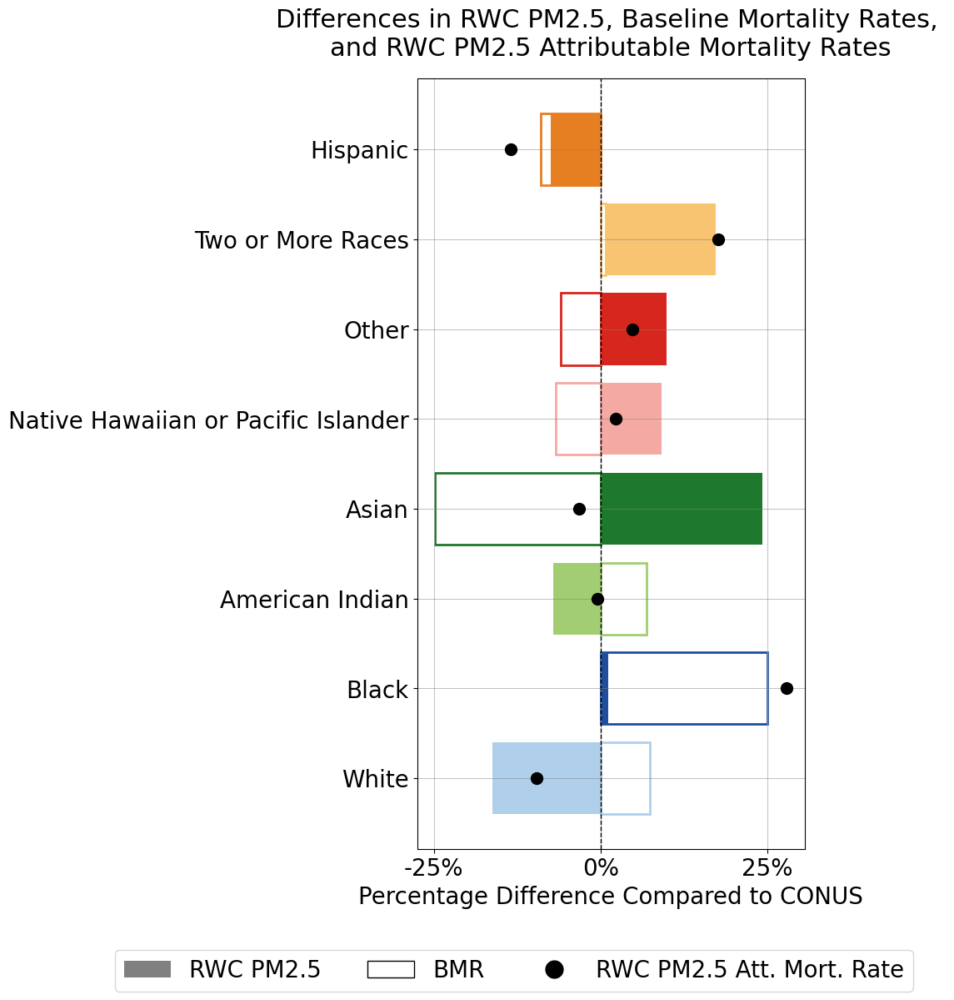

In [204]:
race_colors = {
    "White": "#AFCFEA",
    "Black": "#1F4E9C",
    "American Indian": "#A2CD73",
    "Asian": "#1E792C",
    "Native Hawaiian or Pacific Islander": "#F4A9A3",
    "Other": "#D7261E",
    "Two or More Races": "#F8C471",
    "Hispanic": "#E67E22"
}

# Extract the data from the comparison dictionary
pm_differences = [comparison[race]["PM_90th_diff"] for race in race_colors.keys()]
bmr_differences = [comparison[race]["BMR_90th_diff"] for race in race_colors.keys()]
pm_mortality_differences = [comparison[race]["PM_mortality_90th_diff"] for race in race_colors.keys()]

# Create the plot
fig, ax = plt.subplots(figsize=(6, 12))

y_pos = np.arange(len(race_colors))

# Plot PM2.5 differences as filled bars
for i, race in enumerate(race_colors.keys()):
    if abs(pm_differences[i]) > abs(bmr_differences[i]):
        ax.barh(y_pos[i], pm_differences[i], color=race_colors[race], height=0.8)
        ax.barh(y_pos[i], bmr_differences[i], edgecolor=race_colors[race], facecolor='white', height=0.8, linewidth=2)
    else:
        ax.barh(y_pos[i], bmr_differences[i], edgecolor=race_colors[race], facecolor='white', height=0.8, linewidth=2)
        ax.barh(y_pos[i], pm_differences[i], color=race_colors[race],  height=0.8)

# Plot PM mortality differences as black dots
ax.scatter(pm_mortality_differences, y_pos, color='black', zorder=3, s= 100)

# Formatting
ax.set_yticks(y_pos)
ax.set_yticklabels(race_colors.keys(), fontsize=20)
ax.axvline(0, color='black', linestyle='dashed', linewidth=1)
ax.set_xlabel("Percentage Difference Compared to CONUS", fontsize=20)
ax.set_title("Differences in RWC PM2.5, Baseline Mortality Rates, \nand RWC PM2.5 Attributable Mortality Rates", fontsize=22, pad=20)

# Add grid lines
ax.xaxis.grid(True, linestyle='solid', alpha=0.7)
for i in range(len(race_colors.keys())):
    ax.axhline(i, color='gray', linestyle='solid', linewidth=0.5, alpha = 0.7)

# Format x-axis labels as percentages
ax.set_xticks([-25, 0, 25])
ax.set_xticklabels([f"{x}%" for x in [-25, 0, 25]], fontsize=20)

# Legend
legend_labels = ["RWC PM2.5", "BMR", "RWC PM2.5 Att. Mort. Rate"]
legend_patches = [
    plt.Rectangle((0, 0), 1, 1, fc="gray"),
    plt.Rectangle((0, 0), 1, 1, edgecolor="black", facecolor="none"),
    plt.Line2D([0], [0], marker="o", color="black", linestyle="None", markersize=15)
]

plt.legend(legend_patches, legend_labels, loc='lower center', bbox_to_anchor=(0.25, -0.2), fontsize=20, ncol = 3)


In [107]:
BMR_values

array([ 12.07805082,  19.56508045, -28.5590854 ,  37.89368965,
        28.27098486, -15.13626225, -17.2722523 , -17.16168431])

In [108]:
y_pos

array([0, 1, 2, 3, 4, 5, 6, 7])

/tmp/ipykernel_125635/3797020826.py:52: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


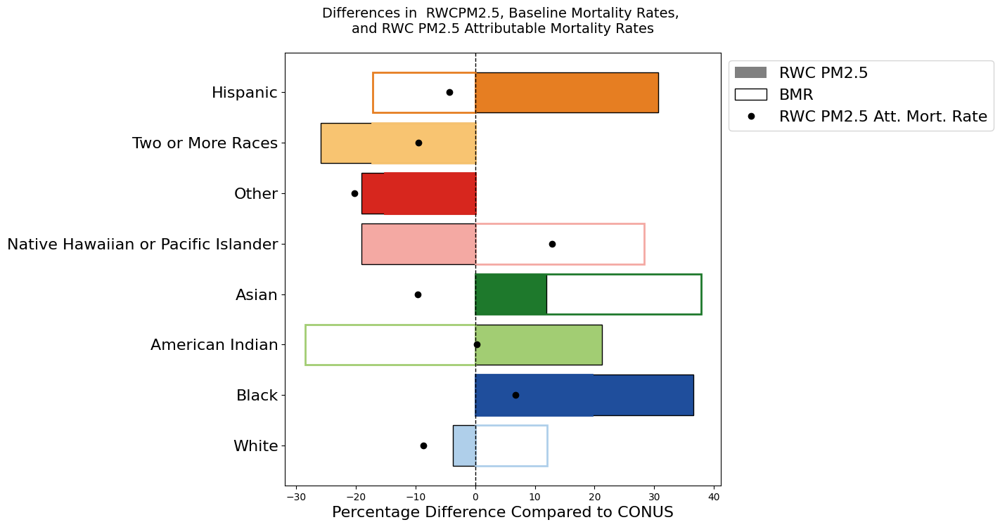

In [166]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

# Define racial groups and colors
race_colors = {
    "White": "#AFCFEA",
    "Black": "#1F4E9C",
    "American Indian": "#A2CD73",
    "Asian": "#1E792C",
    "Native Hawaiian or Pacific Islander": "#F4A9A3",
    "Other": "#D7261E",
    "Two or More Races": "#F8C471",
    "Hispanic": "#E67E22"
}

# Dummy data for the three metrics
num_groups = len(race_colors.keys())
np.random.seed(42)  # For reproducibility
NO2_differences = np.random.uniform(-30, 40, num_groups)
BMR_values = np.random.uniform(-30, 40, num_groups)
NO2_mortality_rates = np.random.uniform(-30, 40, num_groups)

fig, ax = plt.subplots(figsize=(8, 8))

y_pos = np.arange(num_groups)

# Plot NO2 differences as filled bars
for i, race in enumerate(race_colors.keys()):
    ax.barh(y_pos[i], NO2_differences[i], color=race_colors[race], edgecolor='black', height=0.8)

# Overlay BMR values as hollow bars
for i, race in enumerate(race_colors.keys()):
    ax.barh(y_pos[i], BMR_values[i], edgecolor=race_colors[race], facecolor='none', height=0.8, linewidth=2)

# Plot NO2 attributable mortality rates as black dots
ax.scatter(NO2_mortality_rates, y_pos, color='black', zorder=3)

# Formatting
ax.set_yticks(y_pos)
ax.set_yticklabels(race_colors.keys(), fontsize=16)
ax.axvline(0, color='black', linestyle='dashed', linewidth=1)
ax.set_xlabel("Percentage Difference Compared to CONUS", fontsize=16)
ax.set_title("Differences in RWC PM2.5, Baseline Mortality Rates, \nand RWC PM2.5 Attributable Mortality Rates", fontsize=20, pad=20)

# Add grid lines
ax.xaxis.grid(True, linestyle='dashed', alpha=0.7)

# Format x-axis labels as percentages
ax.set_xticks(np.arange(-30, 50, 10))
ax.set_xticklabels([f"{x}%" for x in np.arange(-30, 50, 10)], fontsize=14)

# Legend for race colors
legend_patches = [Patch(color=color, label=race) for race, color in race_colors.items()]
plt.legend(handles=legend_patches, loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=4, fontsize=12)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
# Example usage for plotting on subplots:
fig, axs = plt.subplots(2, 4, figsize=(18, 12))
plt.tight_layout(pad=2.0, rect=[0, 0, 1.0, 1.0])  # Adjust layout to remove padding
plt.subplots_adjust(hspace=0.25, wspace=0.35)  # Adjust horizontal and vertical spacing
plt.subplots_adjust(bottom=0.1)  # Adjust bottom padding to 0.75 inches

# # Call decile_plot for each subplot
# decile_plot(pm_mortality_data_df_baseline, "Los Angeles-Long Beach-Anaheim, CA", "Attributable_Mortality_Rate", ax=axs[0, 0], first = True, year = "2014")
# decile_plot(pm_mortality_data_df_baseline, 'Minneapolis-St. Paul-Bloomington, MN-WI', "Attributable_Mortality_Rate", ax=axs[0, 1], year = "2014")
# decile_plot(pm_mortality_data_df_baseline, "New York-Newark-Jersey City, NY-NJ-PA", "Attributable_Mortality_Rate", ax=axs[0, 2], year = "2014")
# decile_plot(pm_mortality_data_df_baseline, "CONUS", "Attributable_Mortality_Rate", ax=axs[0, 3], year = "2014")


decile_plot(pm_mortality_data_df_2020, "Los Angeles-Long Beach-Anaheim, CA", "Attributable_Mortality_Rate", ax=axs[1, 0], first = True, year = "2020")
decile_plot(pm_mortality_data_df_2020, "Minneapolis-St. Paul-Bloomington, MN-WI", "Attributable_Mortality_Rate", ax=axs[1, 1], year = "2020")
decile_plot(pm_mortality_data_df_2020, "New York-Newark-Jersey City, NY-NJ-PA", "Attributable_Mortality_Rate", ax=axs[1, 2], year = "2020")
decile_plot(pm_mortality_data_df_2020, "CONUS", "Attributable_Mortality_Rate", ax=axs[1, 3], year = "2020")

plt.legend(loc='upper center', bbox_to_anchor=(-1.5, -.18), ncol=8, fontsize=12, borderaxespad=0.)
plt.show()

In [ ]:
# Example usage for plotting on subplots:
fig, axs = plt.subplots(2, 4, figsize=(18, 12))
plt.tight_layout(pad=2.0, rect=[0, 0, 1.0, 1.0])  # Adjust layout to remove padding
plt.subplots_adjust(hspace=0.25, wspace=0.35)  # Adjust horizontal and vertical spacing
plt.subplots_adjust(bottom=0.1)  # Adjust bottom padding to 0.75 inches

# Call decile_plot for each subplot
decile_plot(pm_mortality_data_df_2020, "Los Angeles-Long Beach-Anaheim, CA", "Attributable_Mortality_Rate", ax=axs[0, 0], first = True, year = "2020")
decile_plot(pm_mortality_data_df_2020, 'Minneapolis-St. Paul-Bloomington, MN-WI', "Attributable_Mortality_Rate", ax=axs[0, 1], year = "2020")
decile_plot(pm_mortality_data_df_2020, "New York-Newark-Jersey City, NY-NJ-PA", "Attributable_Mortality_Rate", ax=axs[0, 2], year = "2020")
decile_plot(pm_mortality_data_df_2020, "CONUS", "Attributable_Mortality_Rate", ax=axs[0, 3], year = "2020")


decile_plot(pm_mortality_data_df_2020, "Los Angeles-Long Beach-Anaheim, CA", "2016_pm2.5", ax=axs[1, 0], first = True, year = "2020")
decile_plot(pm_mortality_data_df_2020, "Minneapolis-St. Paul-Bloomington, MN-WI", "2016_pm2.5", ax=axs[1, 1], year = "2020")
decile_plot(pm_mortality_data_df_2020, "New York-Newark-Jersey City, NY-NJ-PA", "2016_pm2.5", ax=axs[1, 2], year = "2020")
decile_plot(pm_mortality_data_df_2020, "CONUS", "2016_pm2.5", ax=axs[1, 3], year = "2020")

plt.legend(loc='upper center', bbox_to_anchor=(-1.5, -.18), ncol=8, fontsize=12, borderaxespad=0.)
plt.show()

In [40]:
cbsa_list

['New York-Newark-Jersey City, NY-NJ-PA',
 'Los Angeles-Long Beach-Anaheim, CA',
 'Chicago-Naperville-Elgin, IL-IN-WI',
 'Dallas-Fort Worth-Arlington, TX',
 'Houston-The Woodlands-Sugar Land, TX',
 'Washington-Arlington-Alexandria, DC-VA-MD-WV',
 'Miami-Fort Lauderdale-Pompano Beach, FL',
 'Philadelphia-Camden-Wilmington, PA-NJ-DE-MD',
 'Atlanta-Sandy Springs-Alpharetta, GA',
 'Boston-Cambridge-Newton, MA-NH',
 'Phoenix-Mesa-Chandler, AZ',
 'San Francisco-Oakland-Berkeley, CA',
 'Riverside-San Bernardino-Ontario, CA',
 'Detroit-Warren-Dearborn, MI',
 'Seattle-Tacoma-Bellevue, WA',
 'Minneapolis-St. Paul-Bloomington, MN-WI',
 'San Diego-Chula Vista-Carlsbad, CA',
 'Tampa-St. Petersburg-Clearwater, FL',
 'Denver-Aurora-Lakewood, CO',
 'St. Louis, MO-IL']

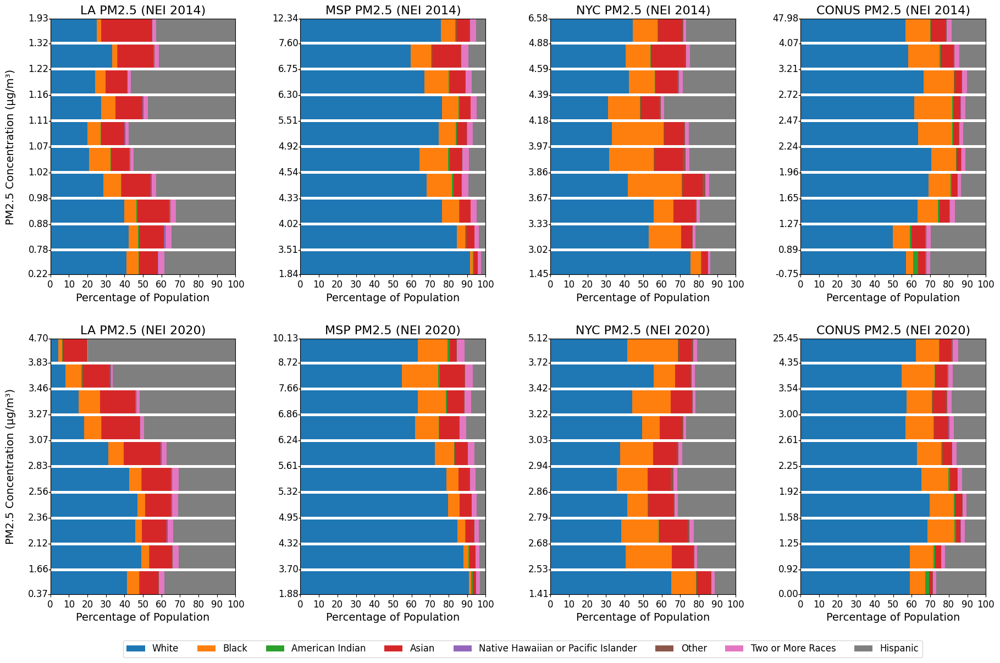

In [49]:
# Example usage for plotting on subplots:
fig, axs = plt.subplots(2, 4, figsize=(18, 12))
plt.tight_layout(pad=2.0, rect=[0, 0, 1.0, 1.0])  # Adjust layout to remove padding
plt.subplots_adjust(hspace=0.25, wspace=0.35)  # Adjust horizontal and vertical spacing
plt.subplots_adjust(bottom=0.1)  # Adjust bottom padding to 0.75 inches

# Call decile_plot for each subplot
decile_plot(pm_mortality_data_df_baseline, "Los Angeles-Long Beach-Anaheim, CA", "2016_pm2.5", ax=axs[0, 0], first = True, year = "2014")
decile_plot(pm_mortality_data_df_baseline, 'Minneapolis-St. Paul-Bloomington, MN-WI', "2016_pm2.5", ax=axs[0, 1], year = "2014")
decile_plot(pm_mortality_data_df_baseline, "New York-Newark-Jersey City, NY-NJ-PA", "2016_pm2.5", ax=axs[0, 2], year = "2014")
decile_plot(pm_mortality_data_df_baseline, "CONUS", "2016_pm2.5", ax=axs[0, 3], year = "2014")


decile_plot(pm_mortality_data_df_2020, "Los Angeles-Long Beach-Anaheim, CA", "2016_pm2.5", ax=axs[1, 0], first = True, year = "2020")
decile_plot(pm_mortality_data_df_2020, "Minneapolis-St. Paul-Bloomington, MN-WI", "2016_pm2.5", ax=axs[1, 1], year = "2020")
decile_plot(pm_mortality_data_df_2020, "New York-Newark-Jersey City, NY-NJ-PA", "2016_pm2.5", ax=axs[1, 2], year = "2020")
decile_plot(pm_mortality_data_df_2020, "CONUS", "2016_pm2.5", ax=axs[1, 3], year = "2020")

plt.legend(loc='upper center', bbox_to_anchor=(-1.5, -.18), ncol=8, fontsize=12, borderaxespad=0.)
plt.show()

In [ ]:
# Example usage for plotting on subplots:
fig, axs = plt.subplots(2, 3, figsize=(18, 12))
plt.tight_layout(pad=2.0, rect=[0, 0, 0, 0])  # Adjust layout to remove padding
plt.subplots_adjust(hspace=0.25, wspace=0.35)  # Adjust horizontal and vertical spacing
plt.subplots_adjust(bottom=0.1)  # Adjust bottom padding to 0.75 inches

# Call decile_plot for each subplot
decile_plot(pm_mortality_data_df_baseline, "Los Angeles-Long Beach-Anaheim, CA", "2016_pm2.5", ax=axs[0, 0], first = True, year = "2014")
decile_plot(pm_mortality_data_df_baseline, 'Chicago-Naperville-Elgin, IL-IN-WI', "2016_pm2.5", ax=axs[0, 1], year = "2014")
decile_plot(pm_mortality_data_df_baseline, "New York-Newark-Jersey City, NY-NJ-PA", "2016_pm2.5", ax=axs[0, 2], year = "2014")
decile_plot(pm_mortality_data_df_2020, "Los Angeles-Long Beach-Anaheim, CA", "2016_pm2.5", ax=axs[1, 0], first = True, year = "2020")
decile_plot(pm_mortality_data_df_2020, "Chicago-Naperville-Elgin, IL-IN-WI", "2016_pm2.5", ax=axs[1, 1], year = "2020")
decile_plot(pm_mortality_data_df_2020, "New York-Newark-Jersey City, NY-NJ-PA", "2016_pm2.5", ax=axs[1, 2], year = "2020")
plt.legend(loc='upper center', bbox_to_anchor=(-1.0, -.18), ncol=8, fontsize=12, borderaxespad=0.)
plt.show()

/tmp/ipykernel_79687/4247373025.py:3: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout(pad=2.0, rect=[0, 0, 0, 0])  # Adjust layout to remove padding


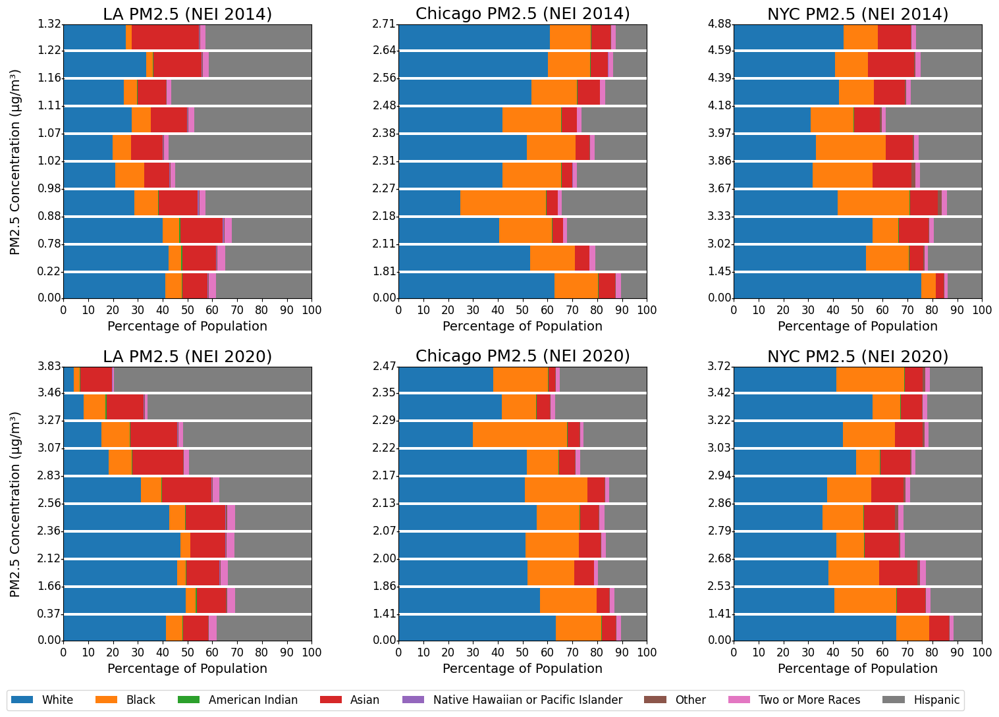

In [174]:
# Example usage for plotting on subplots:
fig, axs = plt.subplots(2, 3, figsize=(18, 12))
plt.tight_layout(pad=2.0, rect=[0, 0, 0, 0])  # Adjust layout to remove padding
plt.subplots_adjust(hspace=0.25, wspace=0.35)  # Adjust horizontal and vertical spacing
plt.subplots_adjust(bottom=0.1)  # Adjust bottom padding to 0.75 inches

# Call decile_plot for each subplot
decile_plot(pm_mortality_data_df_baseline, "Los Angeles-Long Beach-Anaheim, CA", "2016_pm2.5", ax=axs[0, 0], first = True, year = "2014")
decile_plot(pm_mortality_data_df_baseline, 'Chicago-Naperville-Elgin, IL-IN-WI', "2016_pm2.5", ax=axs[0, 1], year = "2014")
decile_plot(pm_mortality_data_df_baseline, "New York-Newark-Jersey City, NY-NJ-PA", "2016_pm2.5", ax=axs[0, 2], year = "2014")
decile_plot(pm_mortality_data_df_2020, "Los Angeles-Long Beach-Anaheim, CA", "2016_pm2.5", ax=axs[1, 0], first = True, year = "2020")
decile_plot(pm_mortality_data_df_2020, "Chicago-Naperville-Elgin, IL-IN-WI", "2016_pm2.5", ax=axs[1, 1], year = "2020")
decile_plot(pm_mortality_data_df_2020, "New York-Newark-Jersey City, NY-NJ-PA", "2016_pm2.5", ax=axs[1, 2], year = "2020")
plt.legend(loc='upper center', bbox_to_anchor=(-1.0, -.18), ncol=8, fontsize=12, borderaxespad=0.)
plt.show()

In [59]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

def decile_plot_3_panels(df, loc, columns, version="baseline"):
    """
    Creates a figure with three side-by-side decile bar plots, each showing the
    racial composition within deciles of different data columns.
    
    Parameters:
    - df: DataFrame containing the data.
    - loc: Location filter for the 'CBSA Title' column. If empty, the whole DataFrame is used.
    - columns: List of three columns to create decile plots for.
    - version: Version label to include in the plot title.
    """
    
    # Copy and filter data if loc is specified
    df = df.copy(deep=True)
    if loc:
        df = df[df['CBSA'] == loc]
    
    # Define race columns and number of deciles
    race_columns = ["White", "Black", "American Indian", "Asian", "Native Hawaiian or Pacific Islander",
                    "Other", "Two or More Races", "Hispanic"]
    num_iles = 10
    
    fig, axs = plt.subplots(1, 3, figsize=(18, 6), sharey=True)
    fig.suptitle(f"Race Composition within Deciles for Different Indicators in {loc} ({version})")
    
    for i, col in enumerate(columns):
        # Prepare data for the decile plot
        df['decile'] = pd.qcut(df[col], q=num_iles, labels=False)
        
        # Calculate race percentages within each decile
        for race in race_columns:
            df[race + '_percentage'] = (df[race] / df['Total']) * 100

        # Plot the decile data in the corresponding subplot
        bottom = np.zeros(len(df['decile'].unique()))
        for race in race_columns:
            race_percentages = [df[df['decile'] == decile][race + '_percentage'].mean() for decile in range(num_iles)]
            axs[i].bar(range(1, num_iles + 1), race_percentages, bottom=bottom, label=race)
            bottom += np.array(race_percentages)
        
        axs[i].set_title(f"{col}")
        axs[i].set_xlabel(f'Deciles of {col}')
        axs[i].set_xticks(range(1, num_iles + 1))
        if i == 0:
            axs[i].set_ylabel('Percentage of Population')
    
    # Add legend to the first subplot only to avoid repetition
    axs[0].legend(loc="upper right", bbox_to_anchor=(1.4, 1))
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust layout to fit title
    plt.show()

# Example usage:


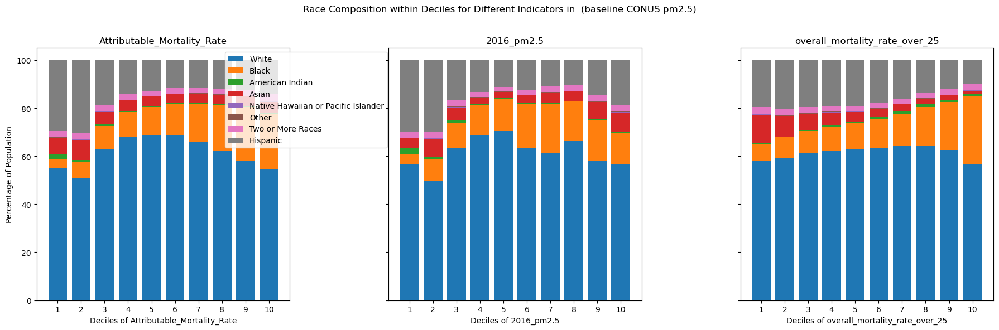

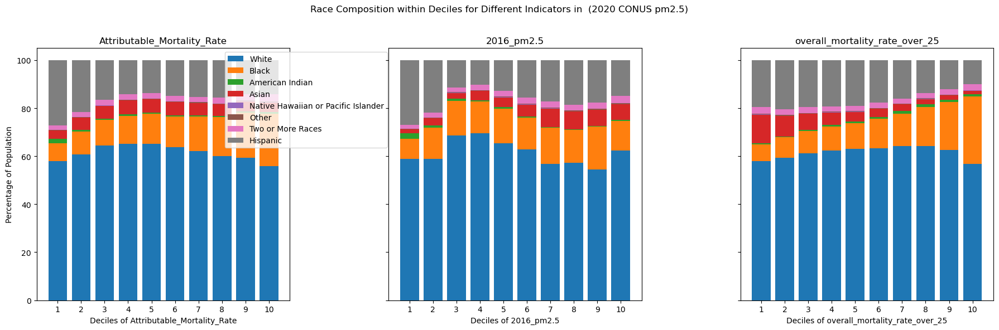

In [33]:
decile_plot_3_panels(pm_mortality_data_df_baseline, "", ["Attributable_Mortality_Rate", "2016_pm2.5", "overall_mortality_rate_over_25"], "baseline CONUS pm2.5")
decile_plot_3_panels(pm_mortality_data_df_2020, "", ["Attributable_Mortality_Rate", "2016_pm2.5", "overall_mortality_rate_over_25"], "2020 CONUS pm2.5")

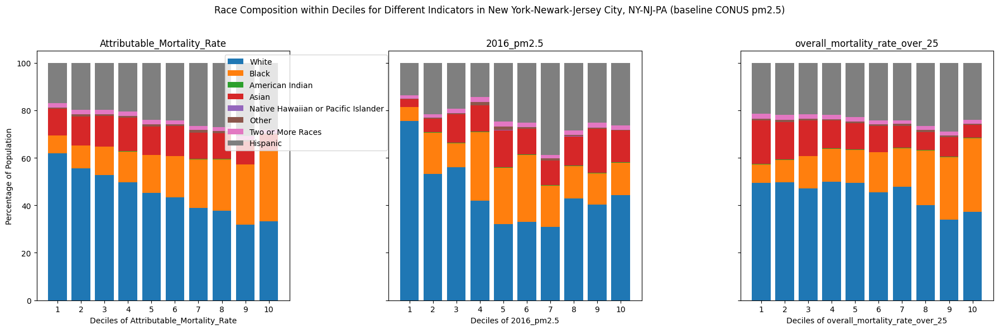

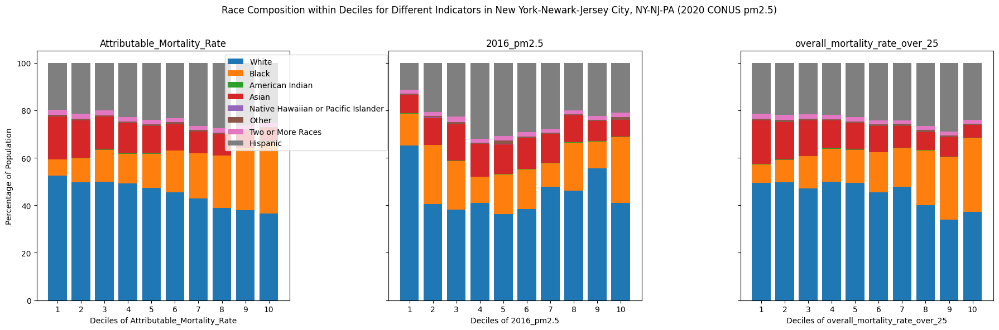

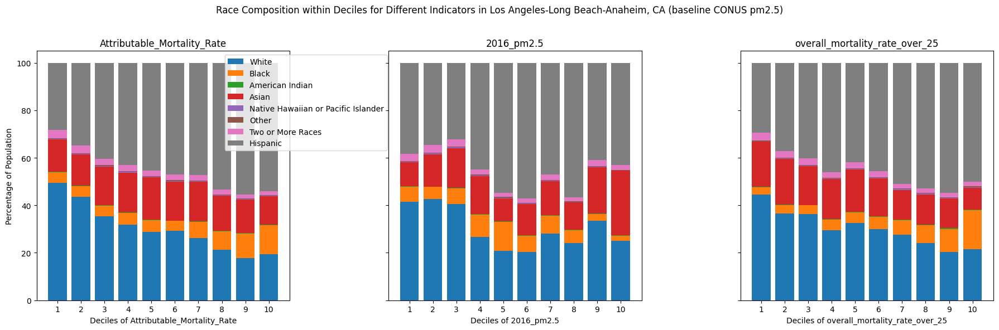

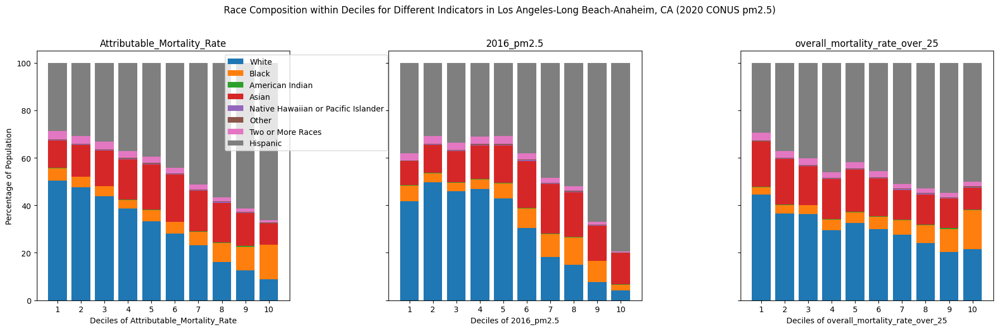

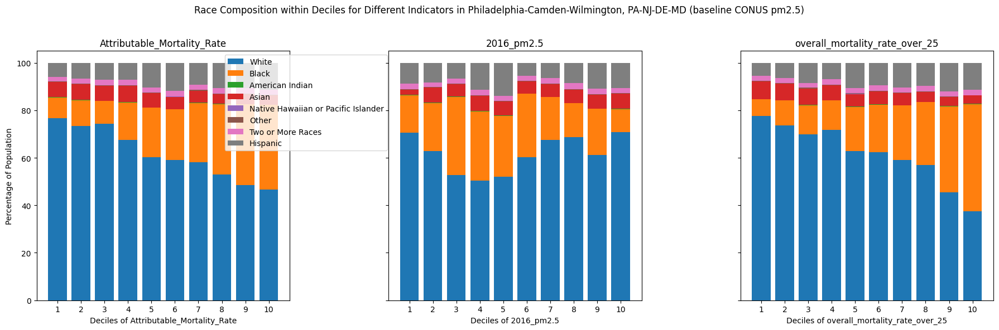

...

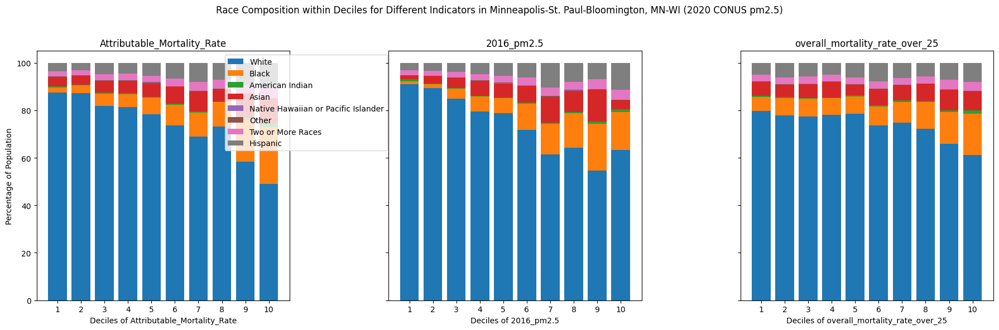

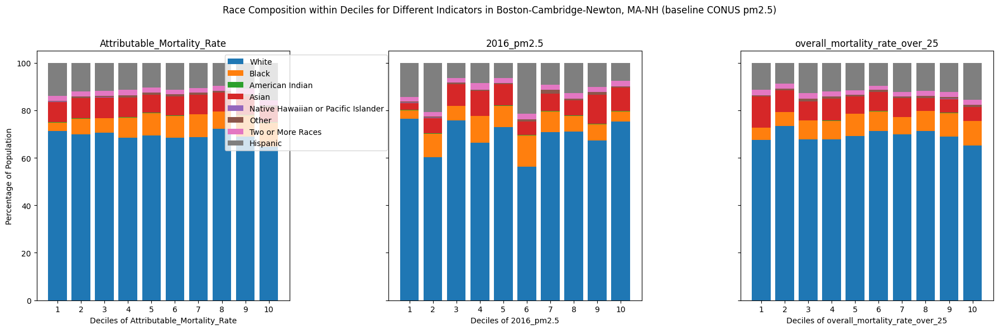

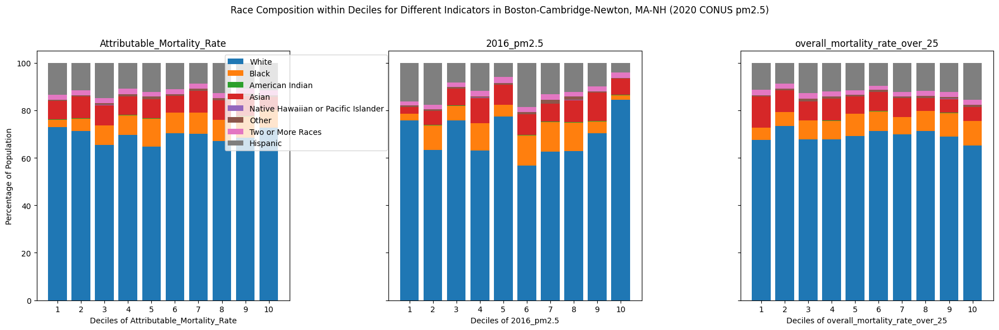

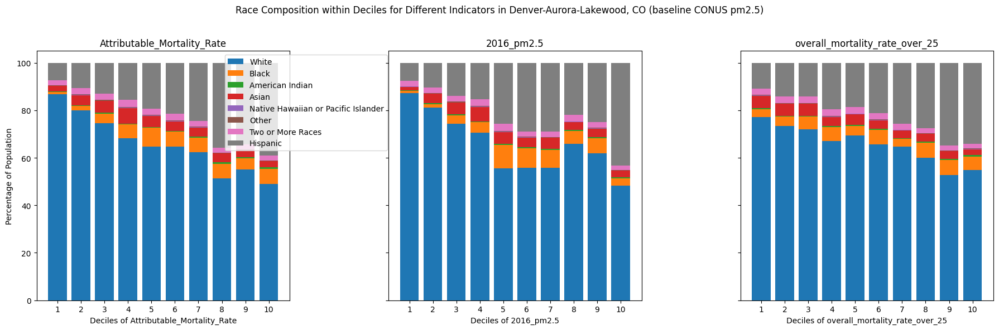

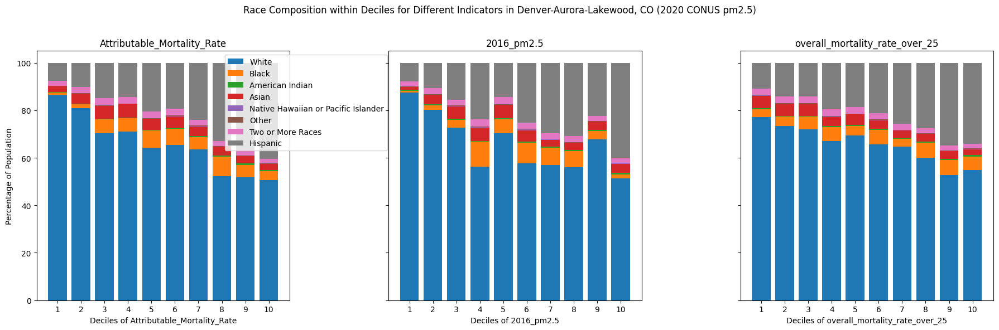

In [60]:

for cbsa in list(pm_mortality_data_df_2020.groupby('CBSA')[['Total', 'Attributable_Mortality']].sum().sort_values('Attributable_Mortality',ascending = False)[0:10].index):
    decile_plot_3_panels(pm_mortality_data_df_baseline, loc=cbsa, columns = ["Attributable_Mortality_Rate", "2016_pm2.5", "overall_mortality_rate_over_25"], version = "baseline CONUS pm2.5")
    decile_plot_3_panels(pm_mortality_data_df_2020, loc=cbsa,  columns = ["Attributable_Mortality_Rate", "2016_pm2.5", "overall_mortality_rate_over_25"],version =  "2020 CONUS pm2.5")

### Spatial plotting

In [42]:
import matplotlib.pyplot as plt
from pyproj import CRS, Transformer
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from shapely.geometry import box


def plot_MSA_mortality(df, MSA, title, validation_df, col="PM25", cmap="viridis", vs=False, counties=False, difference=False, state_color="white", ax=None):
    # Define the target projection
    target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))
    
    # Generate map features
    resol = '50m'  # use data at this scale
    bodr = cfeature.NaturalEarthFeature(category='cultural', edgecolor='black', name='admin_0_boundary_lines_land', scale='50m', facecolor='none', alpha=0.7)
    ocean = cfeature.NaturalEarthFeature('physical', 'ocean', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    lakes = cfeature.NaturalEarthFeature('physical', 'lakes', scale=resol, edgecolor='black', facecolor=cfeature.COLORS['water'])
    states_provinces = cfeature.NaturalEarthFeature(category='cultural', name='admin_1_states_provinces_lines', scale='50m', edgecolor=state_color, facecolor='none')
    
    # # Customize plot appearance
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.set_xticks([])
    ax.set_yticks([])
    
    # # Add features to the map
    if counties:
        ax.add_feature(COUNTIES, facecolor='none', edgecolor=state_color)
    ax.add_feature(ocean, linewidth=0.2, zorder=0)
    ax.add_feature(lakes, linewidth=0.2, zorder=0)
    ax.add_feature(states_provinces, edgecolor=state_color, linewidth=0.5, zorder=0)
    msa_bounds = df.loc[df["CBSA"] == MSA].total_bounds  # [minx, miny, maxx, maxy]
    
    buffer_size = 4000  # Example buffer size in the unit of the projection (e.g., meters)
    
    # Apply the buffer to expand the bounding box
    buffered_bounds = [
        msa_bounds[0] - buffer_size,  # minx
        msa_bounds[1] - buffer_size,  # miny
        msa_bounds[2] + buffer_size,  # maxx
        msa_bounds[3] + buffer_size   # maxy
    ]
    
    # Create a box polygon with the buffered bounds
    plot_area = box(*buffered_bounds)
    ax.set_extent([msa_bounds[0] -buffer_size , msa_bounds[2] + buffer_size, msa_bounds[1] - buffer_size, msa_bounds[3] + buffer_size], crs=target_proj)

    
    # Filter the main dataframe for data within the buffered plot area
    sub_df = df[df.geometry.intersects(plot_area)]
    
    if vs:
        vmin = vs[0]
        vmax = vs[1]
    elif not difference:
        vmin = np.quantile(sub_df[col], 0.025)
        vmax = np.quantile(sub_df[col], 0.975)
    else:
        vmin = -max( [abs(np.quantile(sub_df[col], 0.025)), abs(np.quantile(sub_df[col], 0.975))] )
        vmax =-vmin
        
    # # Plot MSA area data
    sc = sub_df.plot(ax=ax, column=col, cmap=cmap, legend=True, vmin=vmin, vmax=vmax, zorder=-1, legend_kwds={'label': col})
    
    # cbar = plt.colorbar(sc, ax=ax, orientation="vertical", fraction=0.02, pad=0.04)
    # cbar.set_label("Deaths per 10000")
    
    msa_geometry = df.loc[df["CBSA"] == MSA, "geometry"].unary_union  # Get combined geometry for the MSA
    
    # Simplify the geometry to reduce jagged edges
    tolerance = 4000  # Adjust this value as needed for smoother lines (in coordinate units)
    #simplified_msa_geometry = msa_geometry.simplify(tolerance, preserve_topology=True)
    
    # Plot the simplified geometry
   # ax.add_geometries([msa_geometry], crs=target_proj, edgecolor=state_color, facecolor='none', linewidth=1.5)
    
    # Add title and return the subset of the data
    ax.set_title(title)
    return sc

def plot_multiple_MSA(df, df2, MSA, figsize = (15,8)):
    # Create a Matplotlib figure with 1 row and 3 columns
    target_proj = ccrs.LambertConformal(central_longitude=-97, central_latitude=40, standard_parallels=(33, 45))
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=figsize, subplot_kw={'projection': target_proj})

    place = MSA.split('-')[0]

    sc1 = plot_MSA_mortality(
        df=df,
        col="Attributable_Mortality_Rate_10000",
        MSA=MSA,
        title=f'{place} PM2.5 RWC baseline',
        validation_df=pd.DataFrame(),  # No validation points for difference
        cmap="viridis",
        counties=False,
        difference=False,
        ax=axes[0],
        state_color="black"# Pass the third axis
    )

    sc2 = plot_MSA_mortality(
        df=df2,
        col="Attributable_Mortality_Rate_10000",
        MSA=MSA,
        title=f'{place} PM2.5 RWC 2020',
        validation_df=pd.DataFrame(),  # No validation points for difference
        cmap="viridis",
        vs=False,
        counties=False,
        difference=False,
        ax=axes[1],
        state_color="black"# Pass the third axis
    )

    df['Attributable_Mortality_Rate_10000_difference'] = -df['Attributable_Mortality_Rate_10000'] + df2['Attributable_Mortality_Rate_10000']

    sc3 = plot_MSA_mortality(
        df=df,
        col="Attributable_Mortality_Rate_10000_difference",
        MSA=MSA,
        title=f'{place} PM2.5 RWC 2020 - baseline',
        validation_df=pd.DataFrame(),  # No validation points for difference
        cmap="RdBu",
        vs=False,
        counties=False,
        difference=True,
        ax=axes[2],
        state_color="black"# Pass the third axis
    )


    baseline_deaths = round(df.loc[df["CBSA"] == MSA]['Attributable_Mortality'].sum())
    baseline_population = round(df.loc[df["CBSA"] == MSA]['Total'].sum())
    print("Baseline Premature Mortality:", baseline_deaths)
    print("Baseline Total Population:",baseline_population)

    baseline_per_10000 = round((baseline_deaths/baseline_population * 10000),2)
    print("Baseline Per 10000:",baseline_per_10000)

    deaths_2020 = round(df2.loc[df2["CBSA"] == MSA]['Attributable_Mortality'].sum())
    population_2020 = round(df2.loc[df2["CBSA"] == MSA]['Total'].sum())
    print("2020     Premature Mortality:", deaths_2020)
    print("2020     Total Population:",population_2020)

    per_10000_2020 = round((deaths_2020/population_2020 * 10000),2)
    print("2020     Per 10000:",per_10000_2020)

    plt.show()

In [53]:
list(pm_mortality_data_df_2020.groupby('CBSA')[['Total', 'Attributable_Mortality']].sum().sort_values('Attributable_Mortality',ascending = False)[0:10].index)

['New York-Newark-Jersey City, NY-NJ-PA',
 'Los Angeles-Long Beach-Anaheim, CA',
 'Philadelphia-Camden-Wilmington, PA-NJ-DE-MD',
 'Chicago-Naperville-Elgin, IL-IN-WI',
 'Washington-Arlington-Alexandria, DC-VA-MD-WV',
 'Detroit-Warren-Dearborn, MI',
 'Seattle-Tacoma-Bellevue, WA',
 'Minneapolis-St. Paul-Bloomington, MN-WI',
 'Boston-Cambridge-Newton, MA-NH',
 'Denver-Aurora-Lakewood, CO']

In [27]:
pm_mortality_data_df_baseline['2016_pm2.5']

0        2.545965
1        2.757487
2        2.777727
3        2.828825
4        2.729414
           ...   
72258    0.204196
72259    0.572464
72260    0.497830
72261    0.186142
72262    0.270462
Name: 2016_pm2.5, Length: 72263, dtype: float64

In [31]:
result = (
    pm_mortality_data_df_baseline
    .groupby('CBSA')
    .agg({
        'Total': 'sum',
        'Attributable_Mortality': 'sum',
        'Attributable_Mortality_Rate': 'mean'
    })
    .sort_values('Total', ascending=False)
    .head(20)  # Top 10 rows
)

result

,Total,Attributable_Mortality,Attributable_Mortality_Rate
CBSA,,,
"New York-Newark-Jersey City, NY-NJ-PA",19294236,2628.184348,0.000139
"Los Angeles-Long Beach-Anaheim, CA",13249131,448.239344,0.000034
"Chicago-Naperville-Elgin, IL-IN-WI",9508605,875.551412,0.000096
"Dallas-Fort Worth-Arlington, TX",7320663,420.244317,0.000060
"Houston-The Woodlands-Sugar Land, TX",6884138,547.594272,0.000084
"Washington-Arlington-Alexandria, DC-VA-MD-WV",6196585,665.084703,0.000112
"Miami-Fort Lauderdale-Pompano Beach, FL",6090660,215.777004,0.000035
"Philadelphia-Camden-Wilmington, PA-NJ-DE-MD",6079130,1201.014116,0.000203
"Atlanta-Sandy Springs-Alpharetta, GA",5862424,549.455976,0.000097


In [61]:
# Add a weighted average column for 2016pm2.5
def get_results_table(pm_mortality_data_df_baseline):
    pm_mortality_data_df_baseline['area'] = pm_mortality_data_df_baseline.geometry.area
    pm_mortality_data_df_baseline['Weighted_PM2.5'] = pm_mortality_data_df_baseline['2016_pm2.5'] * pm_mortality_data_df_baseline['area']
    pm_mortality_data_df_baseline['population_weighted_total'] = pm_mortality_data_df_baseline['2016_pm2.5'] * pm_mortality_data_df_baseline['Total']
    pm_mortality_data_df_baseline['Attributable_Mortality_Rate_per_100000'] = pm_mortality_data_df_baseline['Attributable_Mortality_Rate'] * 100000
    # Group by CBSA and calculate necessary metrics
    result = (
        pm_mortality_data_df_baseline
        .groupby('CBSA')
        .agg({
            'Total': 'sum',  # Total mortality
            'Attributable_Mortality': 'sum',  # Attributable mortality
            'Attributable_Mortality_Rate_per_100000': 'mean',  # Average mortality rate
            'Weighted_PM2.5': 'sum',  # Sum of weighted PM2.5
            'area': 'sum',  # Total area for weighting
            'population_weighted_total':'sum'
        })
    )
    
    # Calculate weighted average 2016pm2.5
    result['Average_RWC_PM2.5'] = result['Weighted_PM2.5'] / result['area']
    #result['Average_RWC_PW_PM2.5'] = result['population_weighted_total']/result['Total']
    
    # Sort by Attributable Mortality and se|lect top 10 rows
    result = result.sort_values('Total', ascending=False)
    
    # Drop intermediate columns to clean up
    result = result.drop(columns=['Weighted_PM2.5', 'area', 'population_weighted_total'])
    
    return result

result = get_results_table(pm_mortality_data_df_baseline)
# Display the result
result.head(20)

,Total,Attributable_Mortality,Attributable_Mortality_Rate_per_100000,Average_RWC_PM2.5
CBSA,,,,
"New York-Newark-Jersey City, NY-NJ-PA",19294236,1293.644615,6.826931,3.468515
"Los Angeles-Long Beach-Anaheim, CA",13249131,219.962708,1.672713,0.664650
"Chicago-Naperville-Elgin, IL-IN-WI",9508605,430.228381,4.734298,2.201411
"Dallas-Fort Worth-Arlington, TX",7320663,206.327598,2.942301,1.325245
"Houston-The Woodlands-Sugar Land, TX",6884138,269.039997,4.130713,1.745787
"Washington-Arlington-Alexandria, DC-VA-MD-WV",6196585,327.179834,5.495644,2.980496
"Miami-Fort Lauderdale-Pompano Beach, FL",6090660,105.881479,1.735885,0.727607
"Philadelphia-Camden-Wilmington, PA-NJ-DE-MD",6079130,591.569767,9.999399,4.200766
"Atlanta-Sandy Springs-Alpharetta, GA",5862424,270.005802,4.744857,2.292888


In [73]:
result[0:20]['Attributable_Mortality'].sum() / pm_mortality_data_df_baseline['Attributable_Mortality'].sum()

0.39603692090215226

In [74]:
result[0:20]['Total'].sum() / pm_mortality_data_df_baseline['Total'].sum()

0.38203149649667517

In [64]:
result = get_results_table(pm_mortality_data_df_2020)
# Display the result
result.head(20)

,Total,Attributable_Mortality,Attributable_Mortality_Rate_per_100000,Average_RWC_PM2.5
CBSA,,,,
"New York-Newark-Jersey City, NY-NJ-PA",19294236,992.064424,5.191177,3.004901
"Los Angeles-Long Beach-Anaheim, CA",13249131,581.797408,4.428779,1.483513
"Chicago-Naperville-Elgin, IL-IN-WI",9508605,388.030220,4.311019,1.881517
"Dallas-Fort Worth-Arlington, TX",7320663,144.669710,2.047533,0.998205
"Houston-The Woodlands-Sugar Land, TX",6884138,157.928100,2.414113,1.108413
"Washington-Arlington-Alexandria, DC-VA-MD-WV",6196585,381.285369,6.379660,3.477315
"Miami-Fort Lauderdale-Pompano Beach, FL",6090660,42.254826,0.701502,0.359761
"Philadelphia-Camden-Wilmington, PA-NJ-DE-MD",6079130,552.062974,9.306145,3.930141
"Atlanta-Sandy Springs-Alpharetta, GA",5862424,197.134046,3.493352,1.644734


In [69]:
result[0:100]['Attributable_Mortality'].sum() / pm_mortality_data_df_2020['Attributable_Mortality'].sum()

0.7036035273486518

In [70]:
result[0:100]['Total'].sum() / pm_mortality_data_df_2020['Total'].sum()

0.6714571842357021

In [24]:
pm_mortality_data_df_2020.groupby('CBSA')[['Total', 'Attributable_Mortality']].sum().sort_values('Attributable_Mortality',ascending = False)[0:10]

,Total,Attributable_Mortality
CBSA,,
"New York-Newark-Jersey City, NY-NJ-PA",19294236,2017.532843
"Los Angeles-Long Beach-Anaheim, CA",13249131,1183.297652
"Philadelphia-Camden-Wilmington, PA-NJ-DE-MD",6079130,1121.125694
"Chicago-Naperville-Elgin, IL-IN-WI",9508605,789.851631
"Washington-Arlington-Alexandria, DC-VA-MD-WV",6196585,774.611956
"Detroit-Warren-Dearborn, MI",4317848,722.397249
"Seattle-Tacoma-Bellevue, WA",3871323,702.547485
"Minneapolis-St. Paul-Bloomington, MN-WI",3573609,684.352633
"Boston-Cambridge-Newton, MA-NH",4832279,610.859321


In [43]:
pm_mortality_data_df_baseline['Attributable_Mortality_Rate_10000'] = pm_mortality_data_df_baseline['Attributable_Mortality_Rate'] * 10000
pm_mortality_data_df_2020['Attributable_Mortality_Rate_10000'] = pm_mortality_data_df_2020['Attributable_Mortality_Rate'] * 10000

Baseline Premature Mortality: 485
Baseline Total Population: 4829559
Baseline Per 10000: 1.0
2020     Premature Mortality: 611
2020     Total Population: 4829559
2020     Per 10000: 1.27


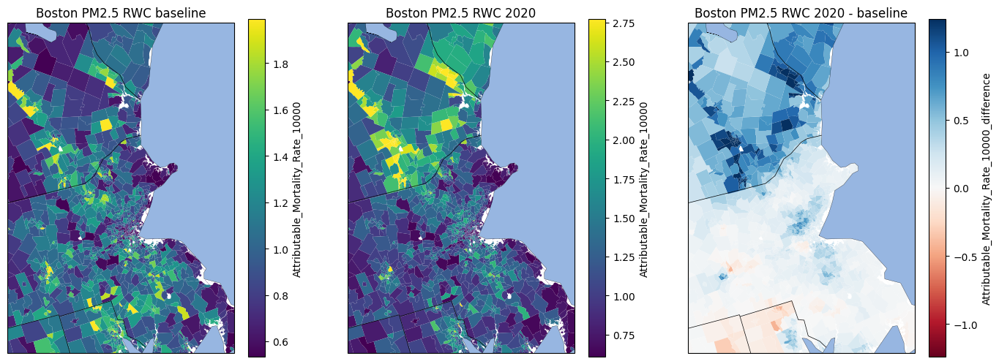

In [50]:
plot_multiple_MSA(pm_mortality_data_df_baseline, pm_mortality_data_df_2020,  "Boston-Cambridge-Newton, MA-NH", figsize = (17, 6))

Baseline Premature Mortality: 514
Baseline Total Population: 4315313
Baseline Per 10000: 1.19
2020     Premature Mortality: 722
2020     Total Population: 4315313
2020     Per 10000: 1.67


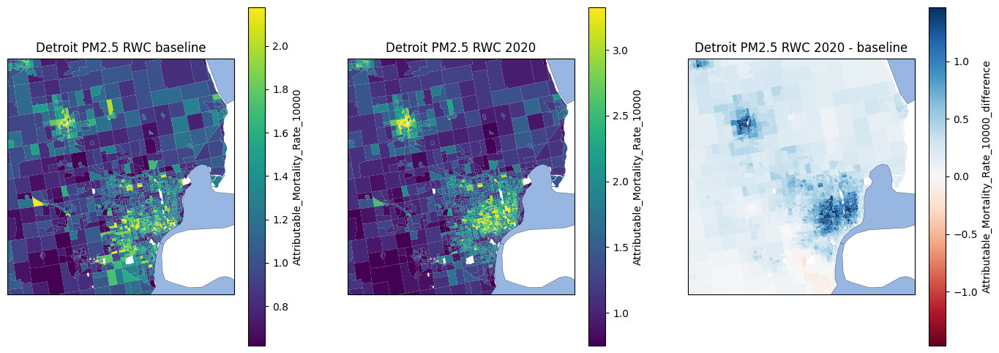

In [48]:
plot_multiple_MSA(pm_mortality_data_df_baseline, pm_mortality_data_df_2020,  "Detroit-Warren-Dearborn, MI", figsize = (17, 6))

Baseline Premature Mortality: 546
Baseline Total Population: 6863034
Baseline Per 10000: 0.8
2020     Premature Mortality: 321
2020     Total Population: 6863034
2020     Per 10000: 0.47


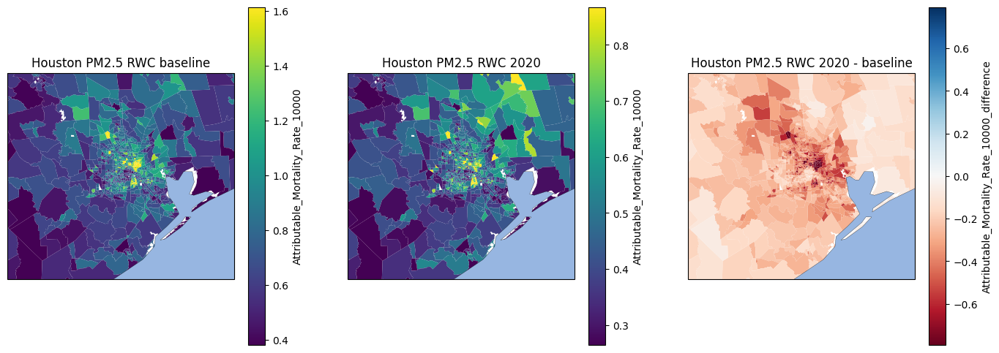

In [49]:
plot_multiple_MSA(pm_mortality_data_df_baseline, pm_mortality_data_df_2020,  "Houston-The Woodlands-Sugar Land, TX", figsize = (17, 6))

Baseline Premature Mortality: 447
Baseline Total Population: 13220787
Baseline Per 10000: 0.34
2020     Premature Mortality: 1182
2020     Total Population: 13220787
2020     Per 10000: 0.89


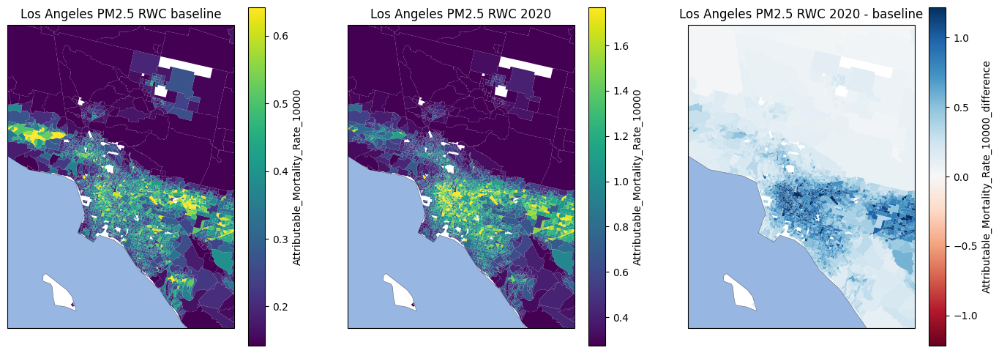

In [44]:
plot_multiple_MSA(pm_mortality_data_df_baseline, pm_mortality_data_df_2020,  "Los Angeles-Long Beach-Anaheim, CA", figsize = (17, 6))

Baseline Premature Mortality: 1199
Baseline Total Population: 6070797
Baseline Per 10000: 1.98
2020     Premature Mortality: 1120
2020     Total Population: 6070797
2020     Per 10000: 1.84


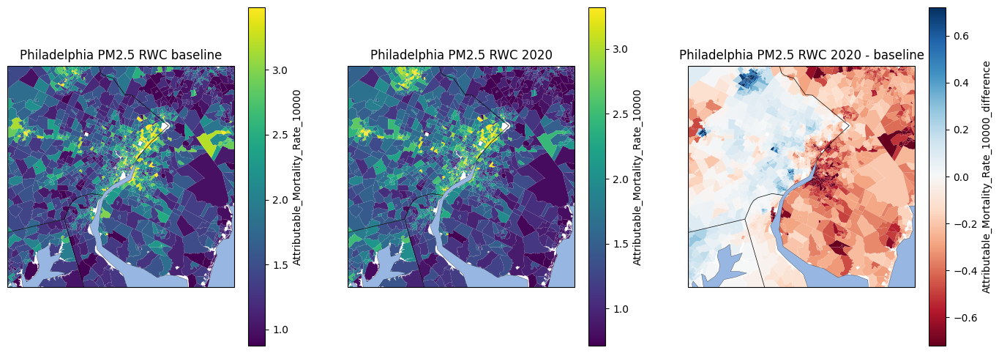

In [45]:
plot_multiple_MSA(pm_mortality_data_df_baseline, pm_mortality_data_df_2020,  "Philadelphia-Camden-Wilmington, PA-NJ-DE-MD", figsize = (17, 6))

Baseline Premature Mortality: 970
Baseline Total Population: 3871323
Baseline Per 10000: 2.51
2020     Premature Mortality: 703
2020     Total Population: 3871323
2020     Per 10000: 1.82


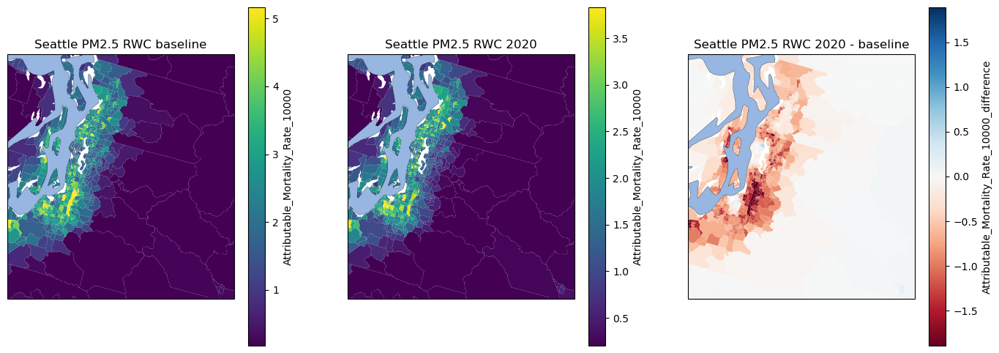

In [23]:
plot_multiple_MSA(pm_mortality_data_df_baseline, pm_mortality_data_df_2020,  "Seattle-Tacoma-Bellevue, WA", figsize = (17, 6))
#plot_multiple_MSA(pm_mortality_data_df_2020, "Seattle-Tacoma-Bellevue, WA", figsize = (20,10))

Baseline Premature Mortality: 2628
Baseline Total Population: 19294236
Baseline Per 10000: 1.36
2020     Premature Mortality: 2018
2020     Total Population: 19294236
2020     Per 10000: 1.05


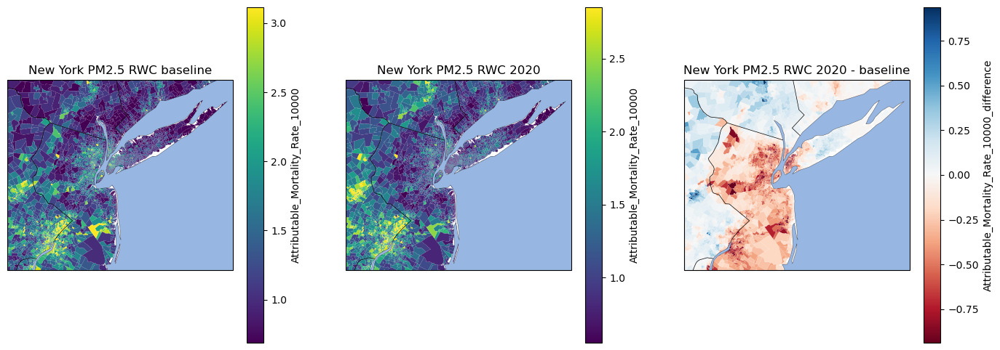

In [70]:
plot_multiple_MSA(pm_mortality_data_df_baseline, pm_mortality_data_df_2020, 'New York-Newark-Jersey City, NY-NJ-PA', figsize = (17, 6))

Baseline Premature Mortality: 876
Baseline Total Population: 9508605
Baseline Per 10000: 0.92
2020     Premature Mortality: 790
2020     Total Population: 9508605
2020     Per 10000: 0.83


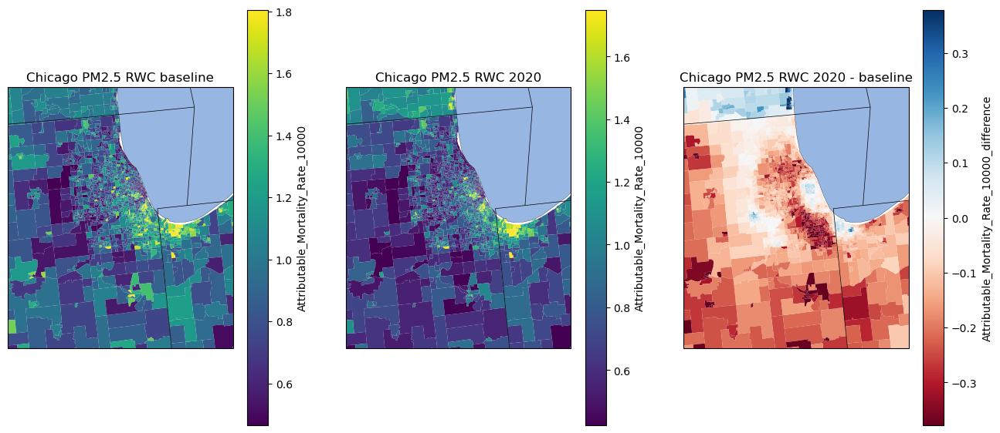

In [27]:
plot_multiple_MSA(pm_mortality_data_df_baseline, pm_mortality_data_df_2020, 'Chicago-Naperville-Elgin, IL-IN-WI', figsize = (16, 7))

Baseline Premature Mortality: 635
Baseline Total Population: 3573609
Baseline Per 10000: 1.78
2020     Premature Mortality: 684
2020     Total Population: 3573609
2020     Per 10000: 1.91


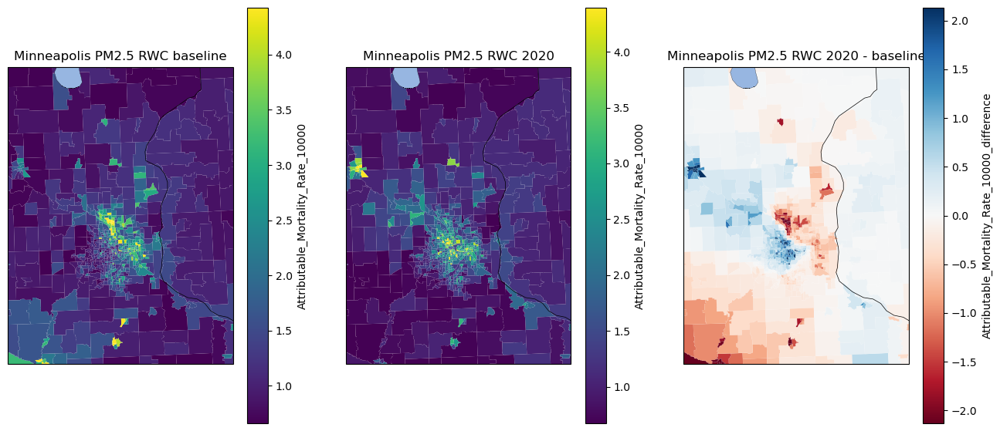

In [28]:
plot_multiple_MSA(pm_mortality_data_df_baseline, pm_mortality_data_df_2020,  'Minneapolis-St. Paul-Bloomington, MN-WI', figsize = (16, 7))


## EJ Index

In [ ]:
cbsa_counties['CBSA Title'].unique()

In [ ]:
box_whisker(rwc_census_tract_pm25, location = 'San Jose-Sunnyvale-Santa Clara, CA')
decile_plot(rwc_census_tract_pm25, loc = 'San Jose-Sunnyvale-Santa Clara, CA')

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def box_whisker(df, location = "", concentration_col = "concentrat", index_col = "SPL_EJI", num_iles = 10):

    if location:
        city_index  = df[df['CBSA Title'] == location].index
        city_tracts = df.loc[city_index]
        df = city_tracts
    
    # Create deciles for pollution concentrations
    num_iles = 10
    df['decile'] = pd.qcut(df[concentration_col], q=num_iles, labels=False)

    # create colors
    mean_ej_index = df.groupby('decile')[index_col].median()
    
    # Normalize the mean EJ_index values to get colors
    norm = plt.Normalize(mean_ej_index.min() - 0.2, mean_ej_index.max() + 0.2)
    cmap = plt.get_cmap('Reds')
    colors = [cmap(norm(value)) for value in mean_ej_index]
    
    # Create the box and whisker plot
    plt.figure(figsize=(12, 8))
    sns.boxplot(x='decile', y=index_col, data=df, palette = colors)
    plt.xlabel('Decile of PM2.5 Pollution Concentration')
    plt.ylabel('EJ Index')
    plt.title(f"Box and Whisker Plot of EJ Index for Each Decile of Pollution Concentrations in {location}")
    plt.show()
    
box_whisker(rwc_census_tract_pm25)

In [ ]:
box_whisker(rwc_census_tract_pm25, location = "Seattle-Tacoma-Bellevue, WA")
decile_plot(rwc_census_tract_pm25, loc = "Seattle-Tacoma-Bellevue, WA")

In [ ]:
box_whisker(rwc_census_tract_pm25, location = 'New York-Newark-Jersey City, NY-NJ')
decile_plot(rwc_census_tract_pm25, loc = 'New York-Newark-Jersey City, NY-NJ')

In [ ]:
box_whisker(rwc_census_tract_pm25, location = 'Las Vegas-Henderson-North Las Vegas, NV')
decile_plot(rwc_census_tract_pm25, loc = 'Las Vegas-Henderson-North Las Vegas, NV')

In [ ]:
box_whisker(rwc_census_tract_pm25, location = 'Minneapolis-St. Paul-Bloomington, MN-WI')
decile_plot(rwc_census_tract_pm25, loc = 'Minneapolis-St. Paul-Bloomington, MN-WI')

In [ ]:
box_whisker(rwc_census_tract_pm25, location = 'Philadelphia-Camden-Wilmington, PA-NJ-DE-MD')
decile_plot(rwc_census_tract_pm25, loc = 'Philadelphia-Camden-Wilmington, PA-NJ-DE-MD')

In [ ]:
box_whisker(rwc_census_tract_pm25, location = 'Chicago-Naperville-Elgin, IL-IN')
decile_plot(rwc_census_tract_pm25, loc = 'Chicago-Naperville-Elgin, IL-IN')

In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

#
num_iles = 10

# Calculate deciles of pollution concentrations
merged['EJI_decile'] = pd.qcut(merged['SPL_EJI'], q=num_iles, labels=False)

# Calculate the percentage of each race within each decile
EJI_deciles = [0,1,2,3,4,5,6,7,8,9]
    
#Create a bar plot with each bar representing a decile and colored by race percentages
plt.figure(figsize=(10, 6))
bottom = np.zeros(10)



for EJ_decile in EJI_deciles:
    EJ_percentages = []
    for decile in range(num_iles):
        pm25_decile_df = (merged.loc[merged['pm25_decile'] == decile])
        EJ_percentages.append(pm25_decile_df.loc[pm25_decile_df['EJI_decile'] == EJ_decile].shape[0] / pm25_decile_df.shape[0] * 100) 
    
    plt.bar(range(num_iles), EJ_percentages, bottom=bottom, label=EJ_decile)
    bottom += np.array(EJ_percentages)
    
plt.xlabel('Deciles of Pollution Concentrations')
plt.ylabel('Percentage of Population in each EJ index')
plt.title('EJ Index Composition within Deciles of Pollution Concentrations')
plt.legend()
plt.show()